<a href="https://colab.research.google.com/github/zakaria-aabbou/NLP-and-Text_Mining/blob/main/Dimensionality_Reduction_classic4_data.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**Projet-2022-MLSD-AMSD**

Partie1+Partie2 sur classic4 data

*UE Réduction de la dimension*

*UE Apprentissage et factorisation matricielle*










In [ ]:
!pip install umap-learn
!pip install tqdm
!pip install hdbscan

In [ ]:
import pandas as pd
import numpy as np
from sklearn.cluster import KMeans
from sklearn.metrics.cluster import normalized_mutual_info_score
from sklearn.cluster import SpectralClustering
from sklearn.decomposition import PCA
from sklearn.metrics import normalized_mutual_info_score as nmi
import matplotlib.pyplot as plt
from sklearn.manifold import TSNE
#from umap import UMAP
from torch.utils.data import DataLoader
import warnings
import torch
from tqdm import tqdm
import plotly.express as px

from sklearn.metrics.cluster import adjusted_rand_score as ARI
from mpl_toolkits import mplot3d

import gensim
from gensim.models import word2vec
from gensim.models import KeyedVectors
import requests
import re

from sklearn.manifold import TSNE
import hdbscan
from umap import UMAP

In [ ]:
#from google.colab import drive
#drive.mount('/content/drive')

In [ ]:
#df = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/Data/classic4.csv')
df = pd.read_csv('classic4.csv')
df = df.iloc[:, [1, 2]]
df

,text,label
0,Computer-Aided Analysis and Design of Informat...,cacm
1,Milestones in Cataloging In the case of the pr...,cisi
2,childhood psychosis. a description is given of...,med
3,neonatal hepatitis or familial neonatal obstru...,med
4,Handbook of Comparative Librarianship The firs...,cisi
...,...,...
7090,throat and nose surgery in patients with const...,med
7091,Computers and Society: A Proposed Course for C...,cacm
7092,Romberg Integration (Algorithm 60),cacm
7093,Semantic Evaluation from Left to Right This pa...,cacm


In [ ]:
set(df.label)

{'cacm', 'cisi', 'cran', 'med'}

In [ ]:
k=4 # nombre de cluster

In [ ]:
label = df['label'].values.reshape(-1)

In [ ]:
df_classes = ['cacm', 'cisi', 'cran', 'med']

In [ ]:
lab = df['label'].apply(df_classes.index)

In [ ]:
label

array(['cacm', 'cisi', 'med', ..., 'cacm', 'cacm', 'cacm'], dtype=object)

In [ ]:
label_num = lab.values.reshape(-1)
label_num

array([0, 1, 3, ..., 0, 0, 0])

# Data Preprocesing 

In [ ]:
import nltk
import en_core_web_sm
nltk.download('stopwords')
from nltk.corpus import stopwords

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [ ]:
stop_words = stopwords.words("english")

In [ ]:
def clean_text(
    string: str,
    punctuations=r'''!()-[]{};:'"\,<>./?@#$%^&*_~''',
    stop_words=stop_words) -> str:
    """
    A method to clean text
    """
    # Cleaning the urls
    string = re.sub(r'https?://\S+|www\.\S+', '', string)
    # Cleaning the html elements
    string = re.sub(r'<.*?>', '', string)
    # Cleaning numbers
    string = re.sub(r'[0-9]+', '', string)

    # Removing the punctuations
    for x in string.lower():
        if x in punctuations:
            string = string.replace(x, "")

    # Converting the text to lower
    string = string.lower()
    # Removing stop words
    string = ' '.join([word for word in string.split() if word not in stop_words])
    # Cleaning the whitespaces
    string = re.sub(r'\s+', ' ', string).strip()
    return string

In [ ]:
texts = np.asarray(df['text']).astype(str).tolist()
texts_cleaned = [clean_text(x) for x in texts]

In [ ]:
texts_cleaned[0]

'computeraided analysis design information systems paper describes use computeraided analysis design development integrated financial management system navy material command support activity nmcsa computeraided analysis consists set procedures computer programs specifically designed aid process applications software design computer selection performance evaluation four major components problem statement language problem statement analyzer generator alternative designs performance evaluator statement requirements written ads accurately defined systems analyzed problem statement analyzer ads ads problem definition supplemented additional information order create complete problem definition analyzed problem statement translated form necessary use soda systems optimization design algorithm program generation alternative specifications program modules logical database structures'

# **Import d'un module permettant de faire du R en Python**

In [ ]:
!pip install rpy2

In [ ]:
import rpy2.robjects.numpy2ri
rpy2.robjects.numpy2ri.activate()

In [ ]:
from rpy2.robjects.packages import importr
utils = importr('utils')

In [ ]:
utils.install_packages('FCPS',repos = "https://cloud.r-project.org")
utils.install_packages('fastcluster',repos = "https://cloud.r-project.org")
utils.install_packages('clustrd',repos = "https://cloud.r-project.org")

R[write to console]: Installing package into ‘/usr/local/lib/R/site-library’
(as ‘lib’ is unspecified)

R[write to console]: trying URL 'https://cloud.r-project.org/src/contrib/FCPS_1.3.0.tar.gz'

R[write to console]: Content type 'application/x-gzip'
R[write to console]:  length 2771273 bytes (2.6 MB)

R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[wri

<rpy2.rinterface_lib.sexp.NULLType object at 0x7f8acf49fbe0> [RTYPES.NILSXP]

In [ ]:
base = importr("base")
fcps = importr("FCPS")

In [ ]:
def eval_clustering_2D(X,pred_labels,labels):
    fig, ax = plt.subplots(1, 2, figsize=(12, 4))
    ax[0].scatter(X[:,0], X[:,1],c = pred_labels )
    ax[0].set_title('Predicted_labels')
    ax[1].scatter(X[:, 0], X[:, 1], c = labels)
    ax[1].set_title('Reel_labels')
    # NMI
    nmi_v = nmi(labels, pred_labels)

    # Cluster_Accuracy
    Cluster_Accuracy = fcps.ClusterAccuracy(labels, pred_labels)

    # ARI
    ARI_v = ARI(labels, pred_labels)

    fig.suptitle('Cluster_Accuracy = %.2f  &  NMI = %.2f & ARI = %.2f' % (Cluster_Accuracy[0] , nmi_v , ARI_v) )

def eval_clustering_3D(X,labels , suptitle = ''):
    fig, ax = plt.subplots(1, 2, figsize=(12, 4))
    ax= fig.add_subplot(projection='3d')
    ax.scatter(X[:,0], X[:,1],X[:,2],c=labels)
    ax.set_title('Representation en 3D')
    fig.suptitle(suptitle)

def eval_clustering_3D_plotly(X, label):
    fig = px.scatter_3d(X, x=X[:,0], y=X[:,1], z=X[:,2], color=label)
    fig.show()

In [ ]:
token_pattern = r'(?u)\b\w\w+\b'
token_pattern = re.compile(token_pattern)

def tokenize_re(text, min_len=2):
    tokens = token_pattern.findall(text)
    return [x for x in tokens if len(x) >= min_len]

def static_document_embeddings(word_embedding_func, docs, tokenizer, n_dims=300):
    """
        Given a set of tokenized sentences, compute the mean vector of w2v vectors for each sentence
    """
    doc_vectors = []
    for doc in docs:
        doc = tokenizer(doc)
        word_vectors = []
        for word in doc:
            vector = word_embedding_func(word)
            if vector is not None:
                word_vectors.append(vector)
        if word_vectors:
            doc_vector = np.array(word_vectors).mean(axis=0)
        else:
            warnings.warn("Zeros returned. Words not in vocabulary \"{}\"".format(doc), Warning)
            doc_vector = np.array([0] * n_dims)
        
        doc_vectors.append(doc_vector)
    return np.array(doc_vectors)

# Glove

In [ ]:
!wget -c 'https://nlp.stanford.edu/data/glove.840B.300d.zip'

--2021-12-05 13:06:39--  https://nlp.stanford.edu/data/glove.840B.300d.zip
Resolving nlp.stanford.edu (nlp.stanford.edu)... 171.64.67.140
Connecting to nlp.stanford.edu (nlp.stanford.edu)|171.64.67.140|:443... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: http://downloads.cs.stanford.edu/nlp/data/glove.840B.300d.zip [following]
--2021-12-05 13:06:39--  http://downloads.cs.stanford.edu/nlp/data/glove.840B.300d.zip
Resolving downloads.cs.stanford.edu (downloads.cs.stanford.edu)... 171.64.64.22
Connecting to downloads.cs.stanford.edu (downloads.cs.stanford.edu)|171.64.64.22|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 2176768927 (2.0G) [application/zip]
Saving to: ‘glove.840B.300d.zip’

glove.840B.300d.zip 100%[===================>]   2.03G  5.04MB/s    in 6m 51s  

2021-12-05 13:13:30 (5.05 MB/s) - ‘glove.840B.300d.zip’ saved [2176768927/2176768927]



In [ ]:
!unzip glove*.zip

Archive:  glove.840B.300d.zip
  inflating: glove.840B.300d.txt     


In [ ]:
from gensim.test.utils import datapath, get_tmpfile
from gensim.models import KeyedVectors
from gensim.scripts.glove2word2vec import glove2word2vec

glove_file = datapath('/content/glove.840B.300d.txt')
tmp_file = get_tmpfile("/content/glove.840B.300d.word2vec")

_ = glove2word2vec(glove_file, tmp_file)

glove_model = KeyedVectors.load_word2vec_format(tmp_file)

In [ ]:
get_glove_vector = lambda x: glove_model[x] if x in glove_model.vocab else None

In [ ]:
GloVe_embeddings = static_document_embeddings(get_glove_vector, texts_cleaned , tokenize_re)
GloVe_embeddings.shape

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: Warning:

Zeros returned. Words not in vocabulary "['neliac']"

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: Warning:

Zeros returned. Words not in vocabulary "['fdistribution']"



(7095, 300)

## Kmeans 

### Appliquer sur l’espace d’origine

In [ ]:
pred_label_KMeans = KMeans(k, random_state=42).fit(GloVe_embeddings).labels_

R[write to console]: Loading required namespace: pracma



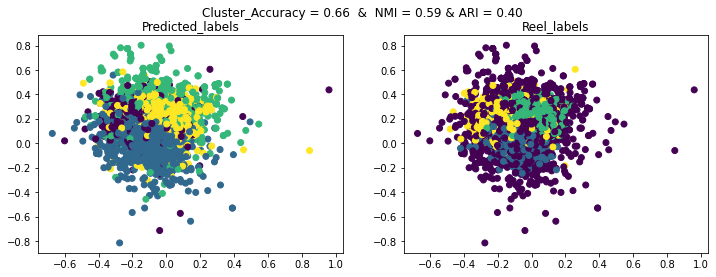

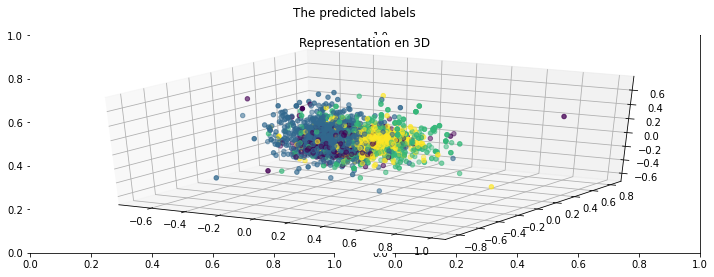

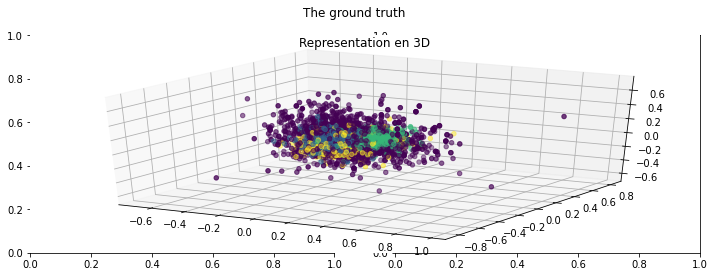

In [ ]:
# Plot 2D
eval_clustering_2D(GloVe_embeddings , pred_label_KMeans , label_num)

# Plot 3D
eval_clustering_3D(GloVe_embeddings , pred_label_KMeans, 'The predicted labels')
eval_clustering_3D(GloVe_embeddings , label_num ,  'The ground truth')


# Plot 3D avec plotly
# eval_clustering_3D_plotly(GloVe_embeddings , pred_label_KMeans)

### ACP

In [ ]:
# ACP
X_reduced_pca_2D = PCA(n_components=2, whiten=True, random_state=42).fit_transform(GloVe_embeddings)
X_reduced_pca_3D = PCA(n_components=3, whiten=True, random_state=42).fit_transform(GloVe_embeddings)

In [ ]:

# Kmeans
pred_label_PCA = KMeans(k, random_state=42).fit(X_reduced_pca_2D).labels_
pred_label_PCA_3 = KMeans(k, random_state=42).fit(X_reduced_pca_3D).labels_


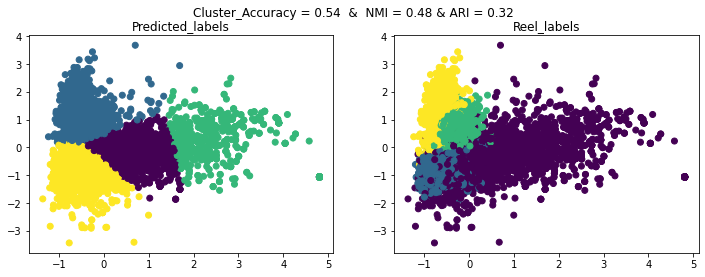

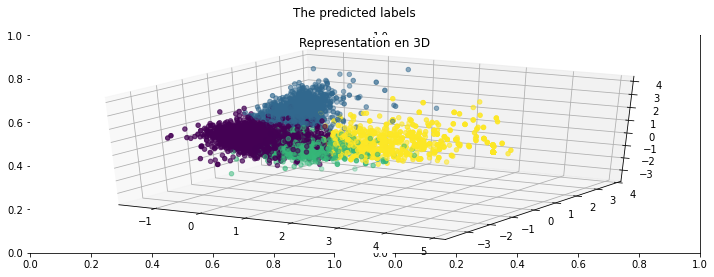

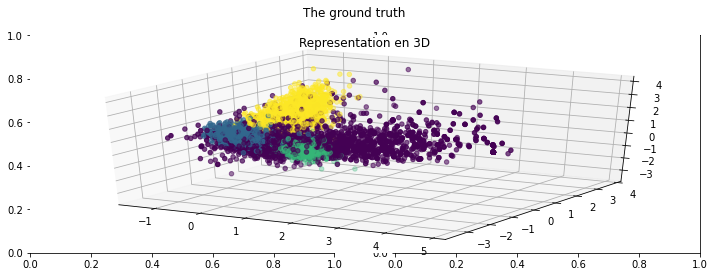

In [ ]:
# Plot 2D
eval_clustering_2D(X_reduced_pca_2D,pred_label_PCA,label_num)

# Plot 3D
eval_clustering_3D(X_reduced_pca_3D,pred_label_PCA_3 , 'The predicted labels')
eval_clustering_3D(X_reduced_pca_3D,label_num ,  'The ground truth' )

# Plot 3D avec plotly
# eval_clustering_3D_plotly(X_reduced_pca_3D,pred_label_PCA_3)

### Tsne

In [ ]:
# TSNE
X_reduced_tsne_2D = TSNE(n_components=2, random_state=42).fit_transform(GloVe_embeddings)
X_reduced_tsne_3D = TSNE(n_components=3, random_state=42).fit_transform(GloVe_embeddings)

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:783: FutureWarning:

The default initialization in TSNE will change from 'random' to 'pca' in 1.2.

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning:

The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:783: FutureWarning:

The default initialization in TSNE will change from 'random' to 'pca' in 1.2.

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning:

The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.



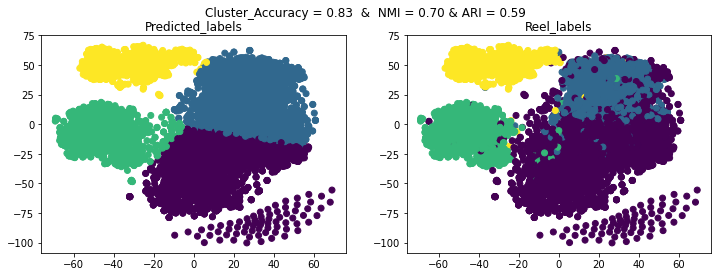

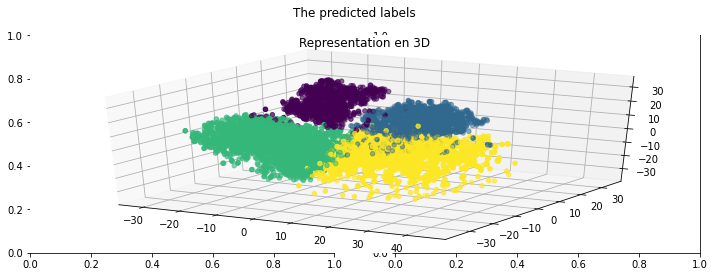

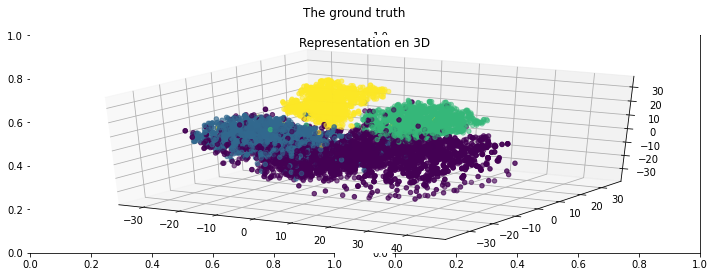

In [ ]:
# Kmeans
pred_label_KMeans = KMeans(k, random_state=42).fit(X_reduced_tsne_2D).labels_
pred_label_KMeans_3D = KMeans(k, random_state=42).fit(X_reduced_tsne_3D).labels_

# Plot 2D
eval_clustering_2D(X_reduced_tsne_2D , pred_label_KMeans , label_num)

# Plot 3D
eval_clustering_3D(X_reduced_tsne_3D , pred_label_KMeans_3D, 'The predicted labels')
eval_clustering_3D(X_reduced_tsne_3D , label_num,  'The ground truth')

# Plot 3D avec plotly
# eval_clustering_3D_plotly(X_reduced_tsne_3D , pred_label_KMeans_3D)

### UMAP

In [ ]:
# UMAP
X_reduced_u_map_2D = UMAP(n_components=2, random_state=42).fit_transform(GloVe_embeddings)
X_reduced_u_map_3D = UMAP(n_components=3, random_state=42).fit_transform(GloVe_embeddings)

/usr/local/lib/python3.7/dist-packages/numba/np/ufunc/parallel.py:363: NumbaWarning:

The TBB threading layer requires TBB version 2019.5 or later i.e., TBB_INTERFACE_VERSION >= 11005. Found TBB_INTERFACE_VERSION = 9107. The TBB threading layer is disabled.



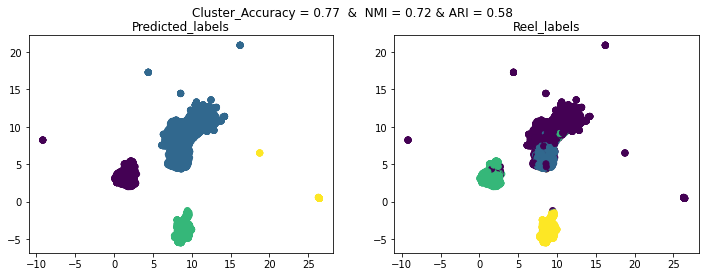

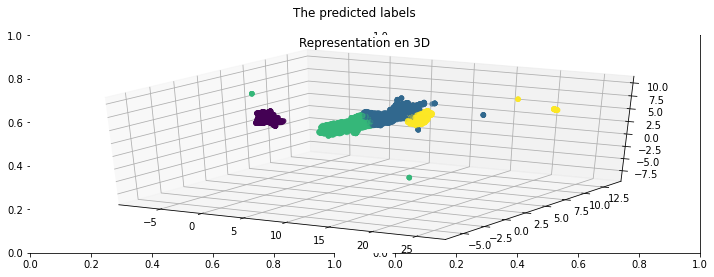

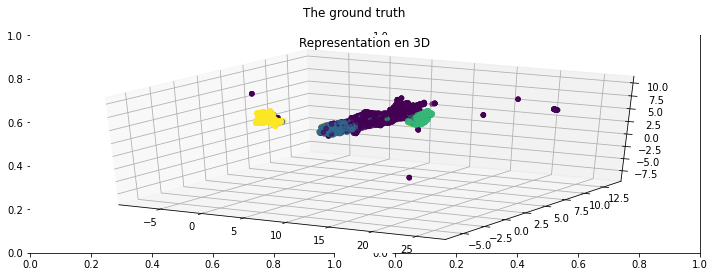

In [ ]:

# KMeans
pred_label_KMeans = KMeans(k, random_state=42).fit(X_reduced_u_map_2D).labels_
pred_label_KMeans_3D = KMeans(k, random_state=42).fit(X_reduced_u_map_3D).labels_

# Plot 2D
eval_clustering_2D(X_reduced_u_map_2D , pred_label_KMeans , label_num)

# Plot 3D
eval_clustering_3D(X_reduced_u_map_3D , pred_label_KMeans_3D, 'The predicted labels')
eval_clustering_3D(X_reduced_u_map_3D , label_num,  'The ground truth')

# Plot 3D avec plotly
# eval_clustering_3D_plotly(X_reduced_u_map_3D , pred_label_KMeans_3D)

### Autoencodeurs

In [ ]:
class AutoEncoder(torch.nn.Module):
    def __init__(self, input_dim, embedding_dim):
        super().__init__()
        self.input_dim = input_dim
        self.embedding_dim = embedding_dim

        self.encoder = torch.nn.Sequential(
            torch.nn.Linear(self.input_dim, 128),
            torch.nn.ReLU(),
            torch.nn.Linear(128, self.embedding_dim)
        )
        
        self.decoder = torch.nn.Sequential(
            torch.nn.Linear(self.embedding_dim, 128),
            torch.nn.ReLU(),
            torch.nn.Linear(128, self.input_dim),
            torch.nn.Sigmoid()
        )

    def forward(self, x):
        encoded = self.encoder(x)
        decoded = self.decoder(encoded)
        return decoded

def autoencoder(X, embedding_dim, n_epochs=50, batch_size=64, learning_rate=1e-3, weight_decay=1e-8, seed=None, return_model=False):
    if torch.cuda.is_available():
        device = 'cuda'
    else:
        device = 'cpu'

    if seed is not None:
      torch.manual_seed(seed)

    dataloader = DataLoader(dataset=X, batch_size=batch_size, shuffle=True)

    model = AutoEncoder(input_dim=X.shape[1], embedding_dim=embedding_dim)

    if device == 'cuda':
      model.cuda()

    loss_function = torch.nn.MSELoss()

    optimizer = torch.optim.Adam(model.parameters(),
                                lr=learning_rate,
                                weight_decay=weight_decay)

    losses = []

    model.train()
    for epoch in tqdm(range(n_epochs)):
        for batch in dataloader:
          batch = batch.to(device)
          reconstructed = model(batch)
          
          loss = loss_function(reconstructed, batch)
          
          optimizer.zero_grad()
          loss.backward()
          optimizer.step()
          
          losses.append(loss)

    model.eval()
    tensor_X = torch.tensor(X)
    tensor_X = tensor_X.to(device)
    encoded_X = model.encoder(tensor_X)
    encoded_X = encoded_X.detach().cpu().numpy()

    if return_model:
      return encoded_X, model, losses
    else:
      return encoded_X


In [ ]:
# AutoEncoder
X_reduced_autoencodeur_2D = autoencoder(GloVe_embeddings.astype("float32"),2, seed=42)
X_reduced_autoencodeur_3D = autoencoder(GloVe_embeddings.astype("float32"),3, seed=42)

100%|██████████| 50/50 [00:17<00:00,  2.90it/s]


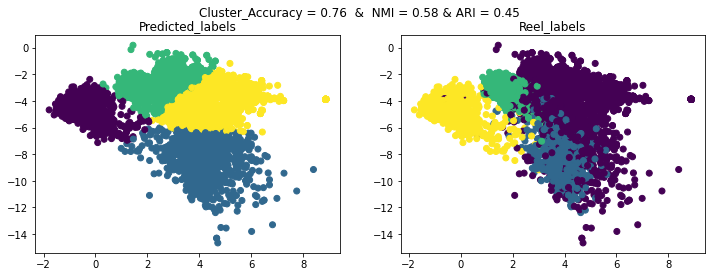

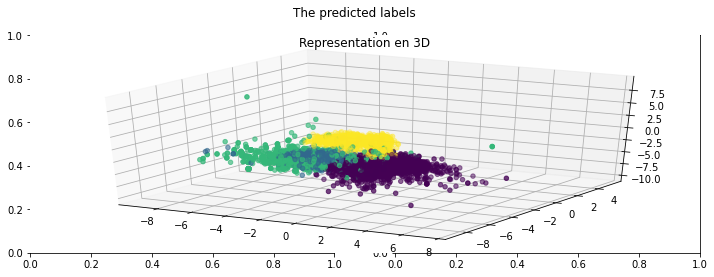

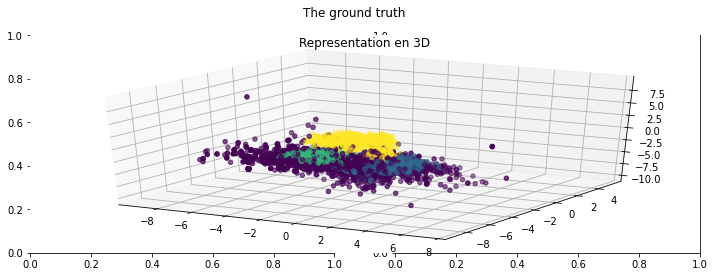

In [ ]:
# KMeans
pred_label_KMeans = KMeans(k, random_state=42).fit(X_reduced_autoencodeur_2D).labels_
pred_label_KMeans_3D = KMeans(k, random_state=42).fit(X_reduced_autoencodeur_3D).labels_

# Plot 2D
eval_clustering_2D(X_reduced_autoencodeur_2D , pred_label_KMeans , label_num)

# Plot 3D
eval_clustering_3D(X_reduced_autoencodeur_3D , pred_label_KMeans_3D, 'The predicted labels')
eval_clustering_3D(X_reduced_autoencodeur_3D , label_num,  'The ground truth')

# Plot 3D avec plotly
# eval_clustering_3D_plotly(X_reduced_autoencodeur_3D , pred_label_KMeans_3D)

## HDBSCAN

### Appliquer  sur l’espace d’origine


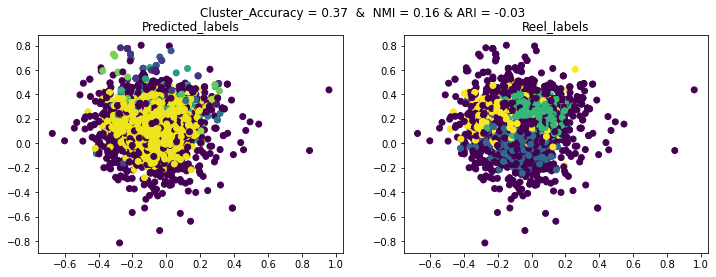

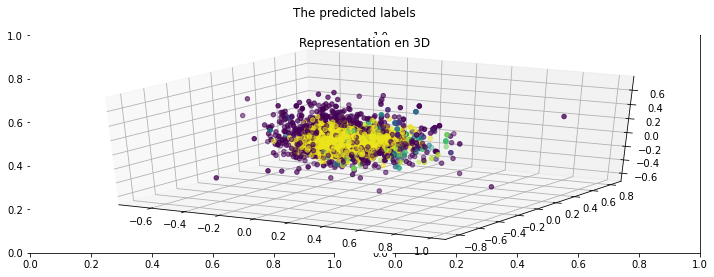

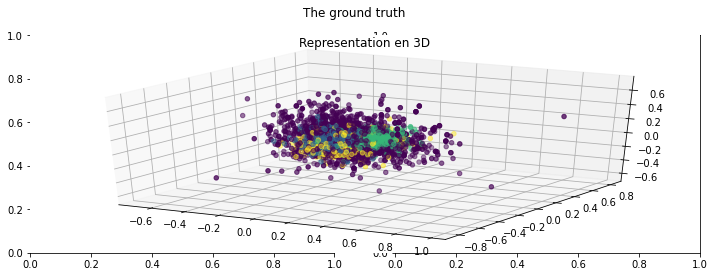

In [ ]:
# hdbscan model
hdbscan_model = hdbscan.HDBSCAN(min_cluster_size=4,algorithm="best",alpha=1.0,leaf_size=40,cluster_selection_method='eom',metric='euclidean').fit(GloVe_embeddings)
pred_label_hdbscan = hdbscan_model.labels_

# Plot 2D
eval_clustering_2D(GloVe_embeddings , pred_label_hdbscan , label_num)

# Plot 3D
eval_clustering_3D(GloVe_embeddings , pred_label_hdbscan, 'The predicted labels')
eval_clustering_3D(GloVe_embeddings , label_num ,  'The ground truth')


# Plot 3D avec plotly
# eval_clustering_3D_plotly(GloVe_embeddings , pred_label_hdbscan)

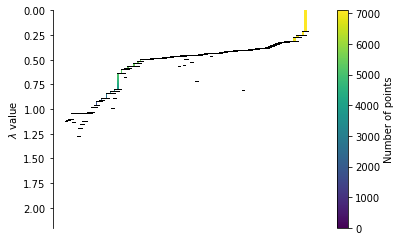

In [ ]:
hdbscan_model.condensed_tree_.plot()

### ACP

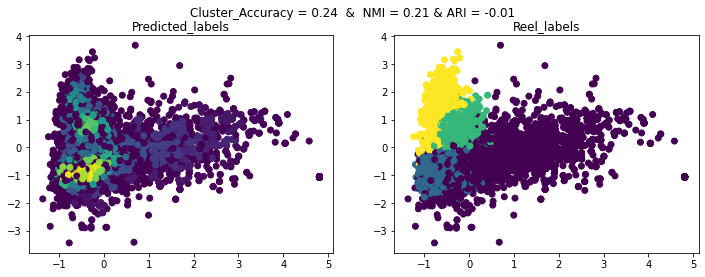

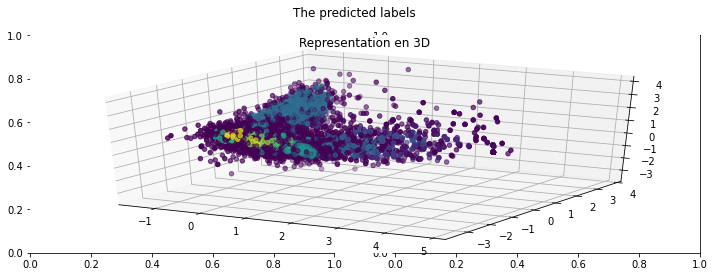

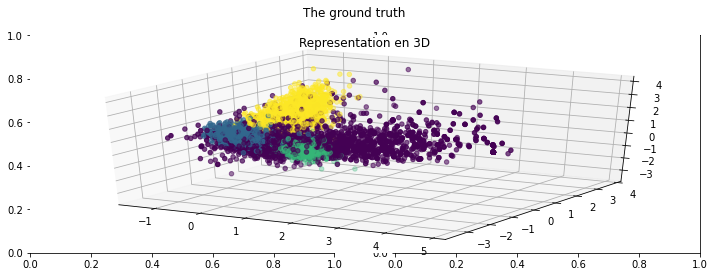

In [ ]:
# HDBSCAN
hdbscan_model = hdbscan.HDBSCAN(min_cluster_size=4,algorithm="best",alpha=1.0,leaf_size=40,cluster_selection_method='eom',metric='euclidean').fit(X_reduced_pca_2D)
pred_label_hdbscan = hdbscan_model.labels_
hdbscan_model_3D = hdbscan.HDBSCAN(min_cluster_size=4,algorithm="best",alpha=1.0,leaf_size=40,cluster_selection_method='eom',metric='euclidean').fit(X_reduced_pca_3D)
pred_label_hdbscan_3D = hdbscan_model_3D.labels_

# Plot 2D
eval_clustering_2D(X_reduced_pca_2D , pred_label_hdbscan , label_num)

# Plot 3D
eval_clustering_3D(X_reduced_pca_3D , pred_label_hdbscan_3D, 'The predicted labels')
eval_clustering_3D(X_reduced_pca_3D , label_num,  'The ground truth')

# Plot 3D avec plotly
# eval_clustering_3D_plotly(X_reduced_pca_3D , pred_label_hdbscan_3D)

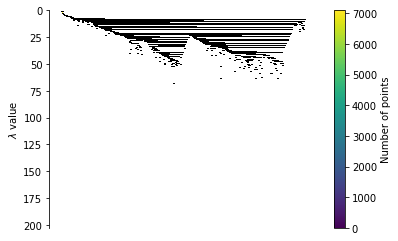

In [ ]:
hdbscan_model.condensed_tree_.plot()

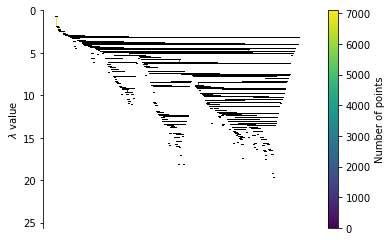

In [ ]:
hdbscan_model_3D.condensed_tree_.plot()

### t-SNE

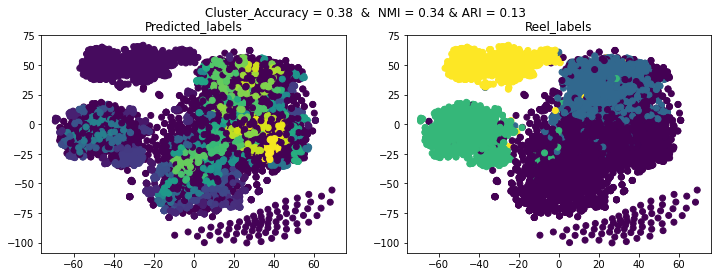

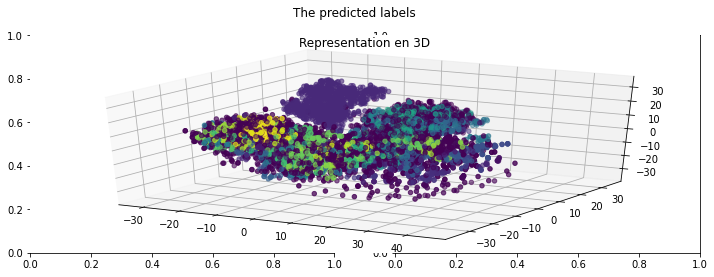

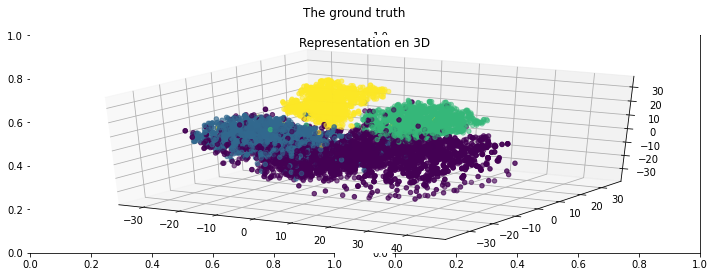

In [ ]:
# HDBSCAN
hdbscan_model = hdbscan.HDBSCAN(min_cluster_size=4,algorithm="best",alpha=1.0,leaf_size=40,cluster_selection_method='eom',metric='euclidean').fit(X_reduced_tsne_2D)
pred_label_hdbscan = hdbscan_model.labels_
hdbscan_model_3D = hdbscan.HDBSCAN(min_cluster_size=4,algorithm="best",alpha=1.0,leaf_size=40,cluster_selection_method='eom',metric='euclidean').fit(X_reduced_tsne_3D)
pred_label_hdbscan_3D = hdbscan_model_3D.labels_

# Plot 2D
eval_clustering_2D(X_reduced_tsne_2D , pred_label_hdbscan , label_num)

# Plot 3D
eval_clustering_3D(X_reduced_tsne_3D , pred_label_hdbscan_3D, 'The predicted labels')
eval_clustering_3D(X_reduced_tsne_3D , label_num,  'The ground truth')

# Plot 3D avec plotly
# eval_clustering_3D_plotly(X_reduced_tsne_3D , pred_label_hdbscan_3D)

### UMAP

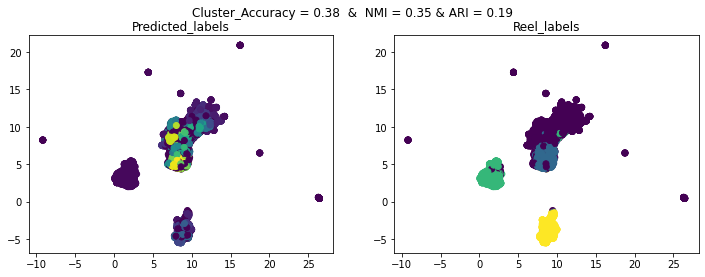

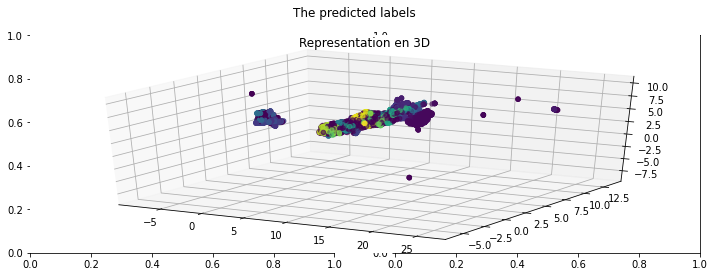

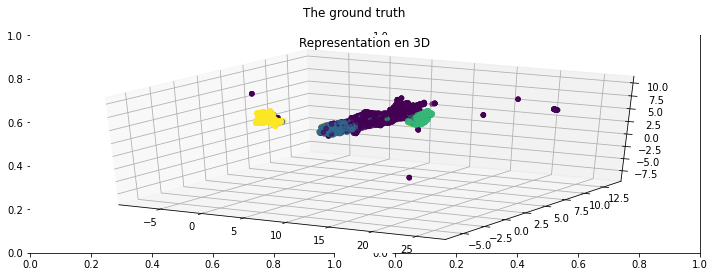

In [ ]:
# HDBSCAN
hdbscan_model = hdbscan.HDBSCAN(min_cluster_size=4,algorithm="best",alpha=1.0,leaf_size=40,cluster_selection_method='eom',metric='euclidean').fit(X_reduced_u_map_2D)
pred_label_hdbscan = hdbscan_model.labels_
hdbscan_model_3D = hdbscan.HDBSCAN(min_cluster_size=4,algorithm="best",alpha=1.0,leaf_size=40,cluster_selection_method='eom',metric='euclidean').fit(X_reduced_u_map_3D)
pred_label_hdbscan_3D = hdbscan_model_3D.labels_

# Plot 2D
eval_clustering_2D(X_reduced_u_map_2D , pred_label_hdbscan , label_num)

# Plot 3D
eval_clustering_3D(X_reduced_u_map_3D , pred_label_hdbscan_3D, 'The predicted labels')
eval_clustering_3D(X_reduced_u_map_3D , label_num,  'The ground truth')

# Plot 3D avec plotly
# eval_clustering_3D_plotly(X_reduced_u_map_3D , pred_label_hdbscan_3D)

### Autoencodeurs

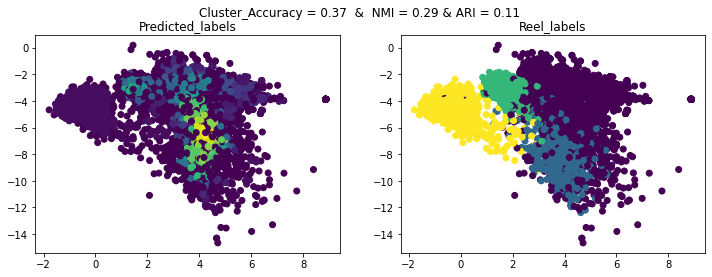

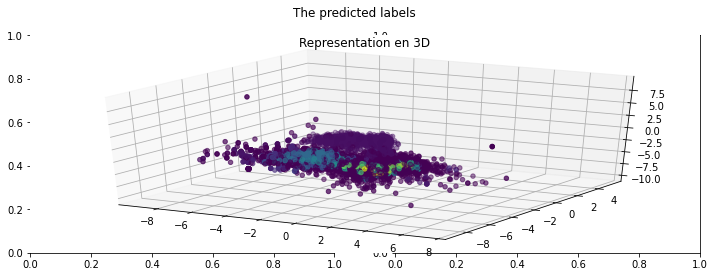

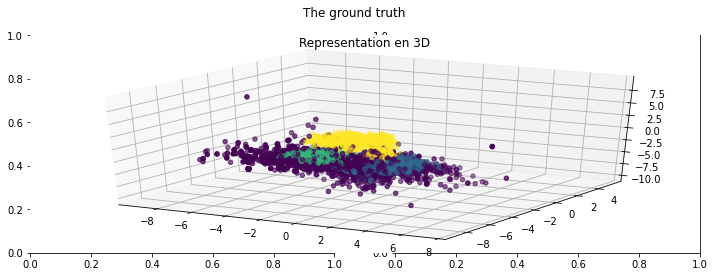

In [ ]:
# HDBSCAN
hdbscan_model = hdbscan.HDBSCAN(min_cluster_size=4,algorithm="best",alpha=1.0,leaf_size=40,cluster_selection_method='eom',metric='euclidean').fit(X_reduced_autoencodeur_2D)
pred_label_hdbscan = hdbscan_model.labels_
hdbscan_model_3D = hdbscan.HDBSCAN(min_cluster_size=4,algorithm="best",alpha=1.0,leaf_size=40,cluster_selection_method='eom',metric='euclidean').fit(X_reduced_autoencodeur_3D)
pred_label_hdbscan_3D = hdbscan_model_3D.labels_

# Plot 2D
eval_clustering_2D(X_reduced_autoencodeur_2D , pred_label_hdbscan , label_num)

# Plot 3D
eval_clustering_3D(X_reduced_autoencodeur_3D , pred_label_hdbscan_3D, 'The predicted labels')
eval_clustering_3D(X_reduced_autoencodeur_3D , label_num,  'The ground truth')

# Plot 3D avec plotly
# eval_clustering_3D_plotly(X_reduced_autoencodeur_3D , pred_label_hdbscan_3D)

## Clustering spectral


### appliquer  sur l’espace d’origine


In [ ]:
pred_label_spectral = SpectralClustering(k,affinity="nearest_neighbors",n_neighbors=10,random_state=42).fit(GloVe_embeddings).labels_
print(round(normalized_mutual_info_score(pred_label_spectral,label),2))

0.73


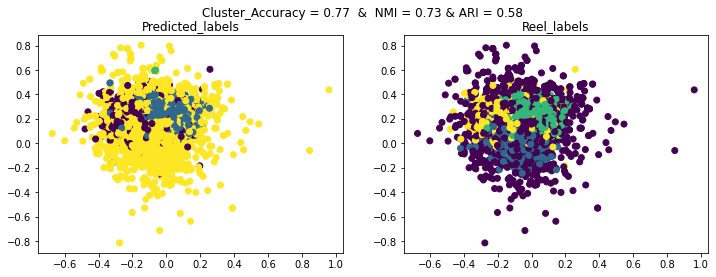

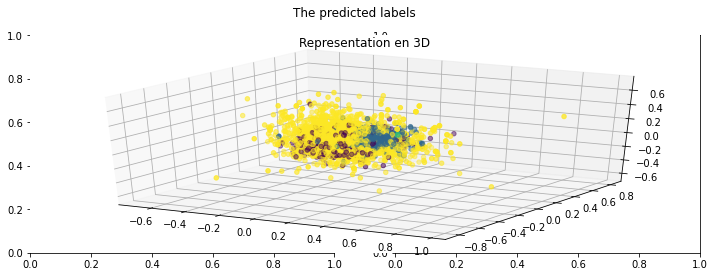

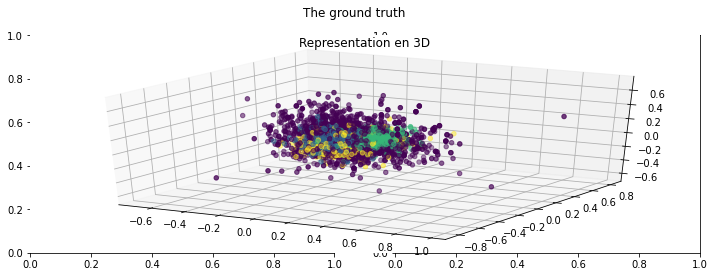

In [ ]:
# Plot 2D
eval_clustering_2D(GloVe_embeddings , pred_label_spectral , label_num)

# Plot 3D
eval_clustering_3D(GloVe_embeddings , pred_label_spectral, 'The predicted labels')
eval_clustering_3D(GloVe_embeddings , label_num ,  'The ground truth')


# Plot 3D avec plotly
# eval_clustering_3D_plotly(GloVe_embeddings , pred_label_spectral)

### appliquer sur ACP

In [ ]:
# Spectral Clustering
pred_label_spectral = SpectralClustering(k,affinity="nearest_neighbors",n_neighbors=10,random_state=42).fit(X_reduced_pca_2D).labels_
pred_label_spectral_3D = SpectralClustering(k,affinity="nearest_neighbors",n_neighbors=10,random_state=42).fit(X_reduced_pca_3D).labels_



/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_spectral_embedding.py:261: UserWarning:

Graph is not fully connected, spectral embedding may not work as expected.

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_spectral_embedding.py:261: UserWarning:

Graph is not fully connected, spectral embedding may not work as expected.



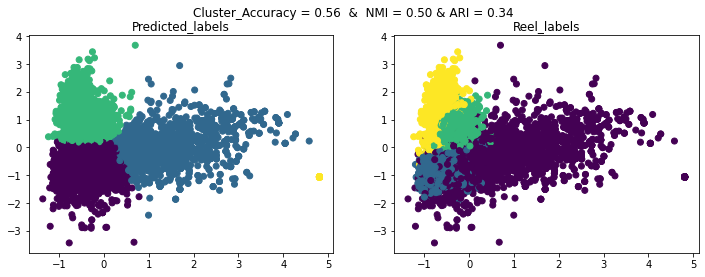

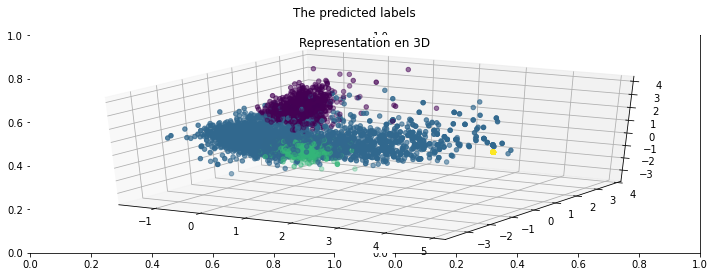

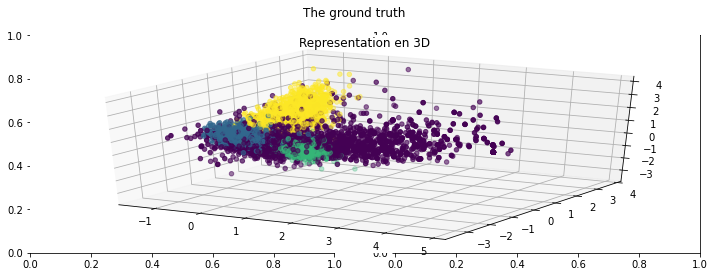

In [ ]:
# Plot 2D
eval_clustering_2D(X_reduced_pca_2D , pred_label_spectral , label_num)

# Plot 3D
eval_clustering_3D(X_reduced_pca_3D , pred_label_spectral_3D, 'The predicted labels')
eval_clustering_3D(X_reduced_pca_3D , label_num,  'The ground truth')

# Plot 3D avec plotly
# eval_clustering_3D_plotly(X_reduced_pca_3D , pred_label_spectral_3D)

### t-SNE

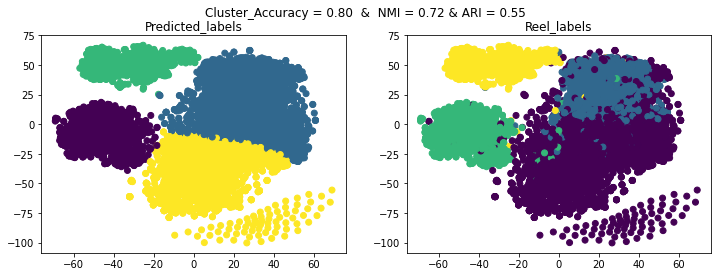

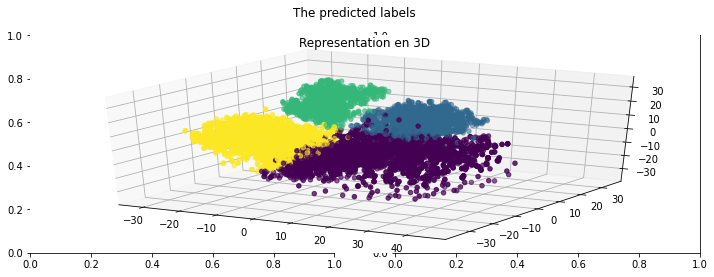

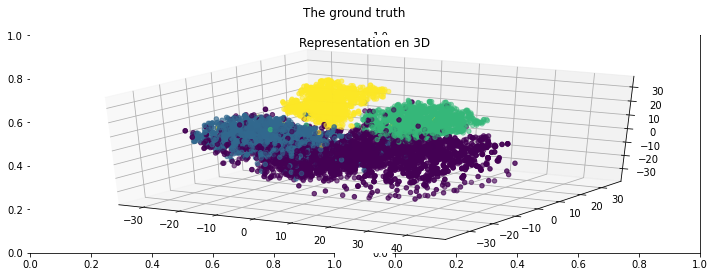

In [ ]:
# Spectral Clustering
pred_label_spectral = SpectralClustering(k,affinity="nearest_neighbors",n_neighbors=10,random_state=42).fit(X_reduced_tsne_2D).labels_
pred_label_spectral_3D = SpectralClustering(k,affinity="nearest_neighbors",n_neighbors=10,random_state=42).fit(X_reduced_tsne_3D).labels_

# Plot 2D
eval_clustering_2D(X_reduced_tsne_2D , pred_label_spectral , label_num)

# Plot 3D
eval_clustering_3D(X_reduced_tsne_3D , pred_label_spectral_3D, 'The predicted labels')
eval_clustering_3D(X_reduced_tsne_3D , label_num,  'The ground truth')

# Plot 3D avec plotly
# eval_clustering_3D_plotly(X_reduced_tsne_3D , pred_label_spectral_3D)

###  UMAP

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_spectral_embedding.py:261: UserWarning:

Graph is not fully connected, spectral embedding may not work as expected.

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_spectral_embedding.py:261: UserWarning:

Graph is not fully connected, spectral embedding may not work as expected.



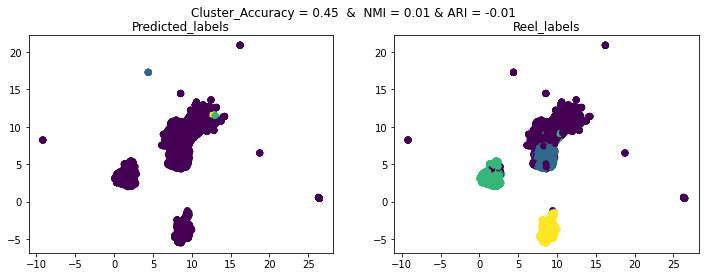

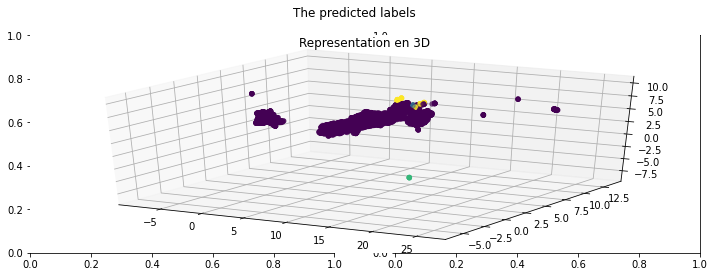

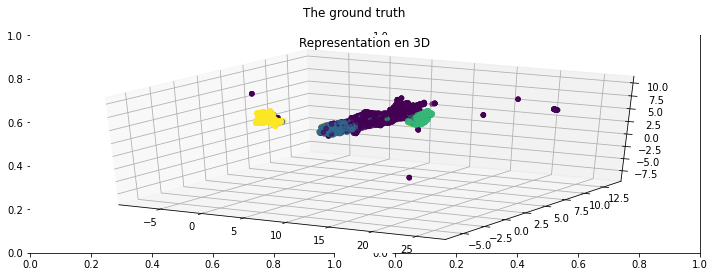

In [ ]:
# Spectral Clustering
pred_label_spectral = SpectralClustering(k,affinity="nearest_neighbors",n_neighbors=10,random_state=42).fit(X_reduced_u_map_2D).labels_
pred_label_spectral_3D = SpectralClustering(k,affinity="nearest_neighbors",n_neighbors=10,random_state=42).fit(X_reduced_u_map_3D).labels_

# Plot 2D
eval_clustering_2D(X_reduced_u_map_2D , pred_label_spectral , label_num)

# Plot 3D
eval_clustering_3D(X_reduced_u_map_3D , pred_label_spectral_3D, 'The predicted labels')
eval_clustering_3D(X_reduced_u_map_3D , label_num,  'The ground truth')

# Plot 3D avec plotly
# eval_clustering_3D_plotly(X_reduced_u_map_3D , pred_label_spectral_3D)

###  Autoencodeurs

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_spectral_embedding.py:261: UserWarning:

Graph is not fully connected, spectral embedding may not work as expected.

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_spectral_embedding.py:261: UserWarning:

Graph is not fully connected, spectral embedding may not work as expected.



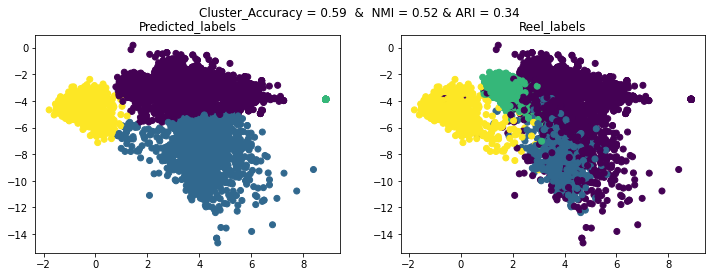

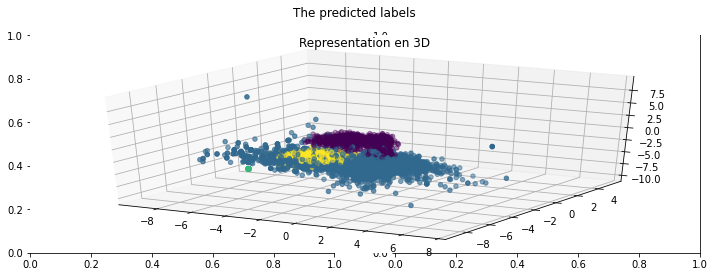

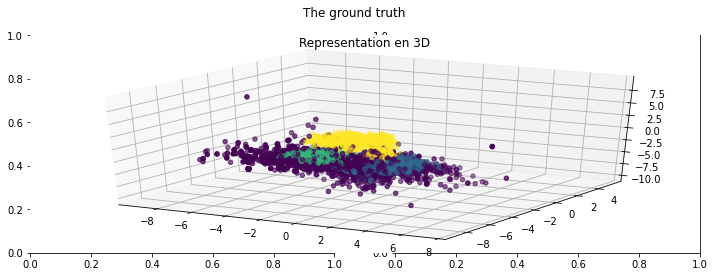

In [ ]:

# Spectral Clustering
pred_label_spectral = SpectralClustering(k,affinity="nearest_neighbors",n_neighbors=10,random_state=42).fit(X_reduced_autoencodeur_2D).labels_
pred_label_spectral_3D = SpectralClustering(k,affinity="nearest_neighbors",n_neighbors=10,random_state=42).fit(X_reduced_autoencodeur_3D).labels_

# Plot 2D
eval_clustering_2D(X_reduced_autoencodeur_2D , pred_label_spectral , label_num)

# Plot 3D
eval_clustering_3D(X_reduced_autoencodeur_3D , pred_label_spectral_3D, 'The predicted labels')
eval_clustering_3D(X_reduced_autoencodeur_3D , label_num,  'The ground truth')

# Plot 3D avec plotly
# eval_clustering_3D_plotly(X_reduced_autoencodeur_3D , pred_label_spectral_3D)

## CAH

In [ ]:
k = 4        # nombre de clusters
lkg = "ward" # métrique choisie dans le regroupement hiérarchique / critères d'agrégation

### Appliquer  sur l’espace d’origine


In [ ]:
from sklearn.cluster import AgglomerativeClustering # génération de modèles de clustering
from scipy.cluster import hierarchy  # dendrogramme

# Créer un modèle de regroupement hiérarchique
# Trouver les étiquettes
cah_model = AgglomerativeClustering(linkage=lkg, n_clusters=k)
cah_model.fit(GloVe_embeddings)
cah_pred_labels = cah_model.labels_


In [ ]:
import matplotlib.gridspec as gridspec

def CAH_plot(X , Labels , linkage=lkg):
    f_ex = plt.figure(figsize=(15,5))
    gs = gridspec.GridSpec(1,2)


    ax = f_ex.add_subplot(gs[0,0])
    ax.set_title("Observations")
    ax.set_xlabel("x")
    ax.set_ylabel("y")
    dendro =f_ex.add_subplot(gs[0,1])


    Z = hierarchy.linkage(X, linkage)
    # Sur la base de la matrice Z, créez le dendrogramme
    # recherchez scipy.cluster.hierarchy.dendrogram() pour implémenter cette tâche.
    hierarchy.dendrogram(
        Z,
        leaf_rotation=90.,  # rotates the x axis labels
        leaf_font_size=8.,  # font size for the x axis labels
    )


    dendro.set_title("Dendrogram")
    dendro.set_xlabel("Observations")
    dendro.set_ylabel("Similarity")

    ax.scatter(X[:,0],X[:,1], c=Labels, cmap='viridis')

    # boucle pour ajouter un exemple d'index en tant qu'étiquette
    # n, _ = X.shape
    # for i in range(n):
    #     ax.annotate("  " + str(i), (X[i,0],X[i,1]) )

    plt.show()

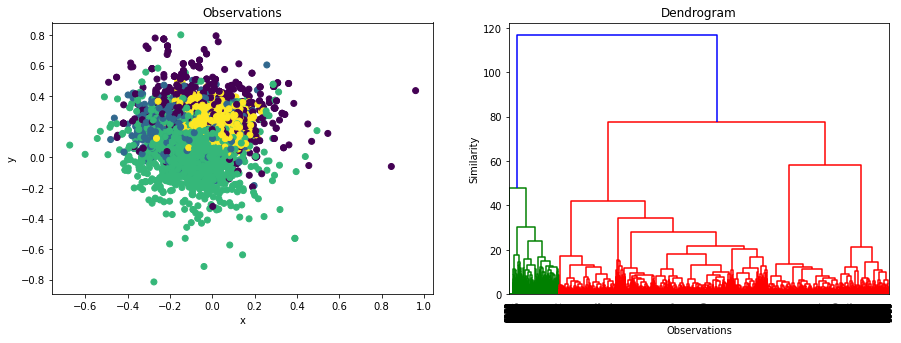

In [ ]:
CAH_plot(GloVe_embeddings , cah_pred_labels)

### ACP

In [ ]:
cah_model = AgglomerativeClustering(linkage=lkg, n_clusters=k)
cah_model.fit(X_reduced_pca_2D)
cah_pred_labels = cah_model.labels_


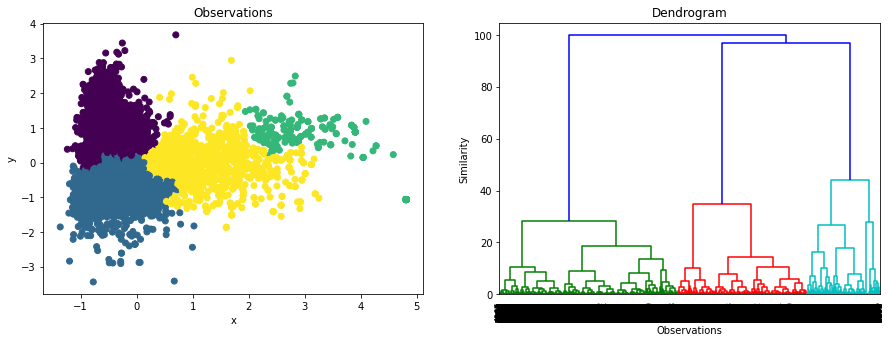

In [ ]:
CAH_plot(X_reduced_pca_2D , cah_pred_labels)

### t-SNE

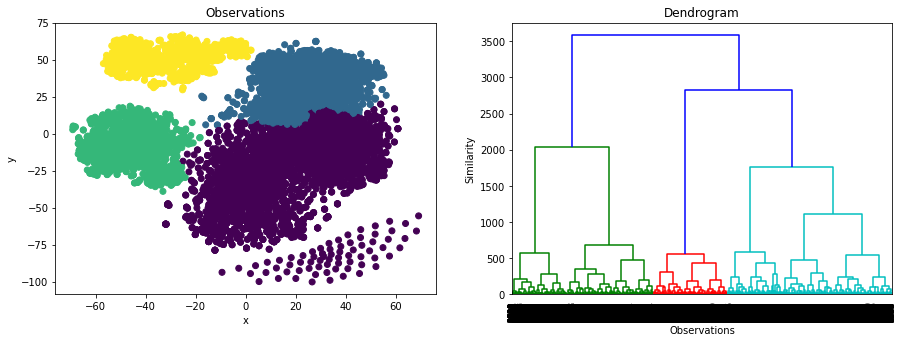

In [ ]:
model = AgglomerativeClustering(linkage=lkg, n_clusters=k)
model.fit(X_reduced_tsne_2D)
labels = model.labels_

CAH_plot(X_reduced_tsne_2D , labels)

### UMAP

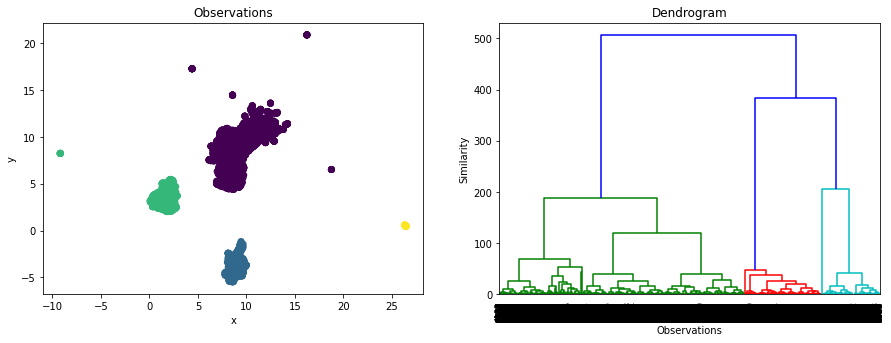

In [ ]:
model = AgglomerativeClustering(linkage=lkg, n_clusters=k)
model.fit(X_reduced_u_map_2D)
labels = model.labels_

CAH_plot(X_reduced_u_map_2D , labels)

### Autoencodeurs

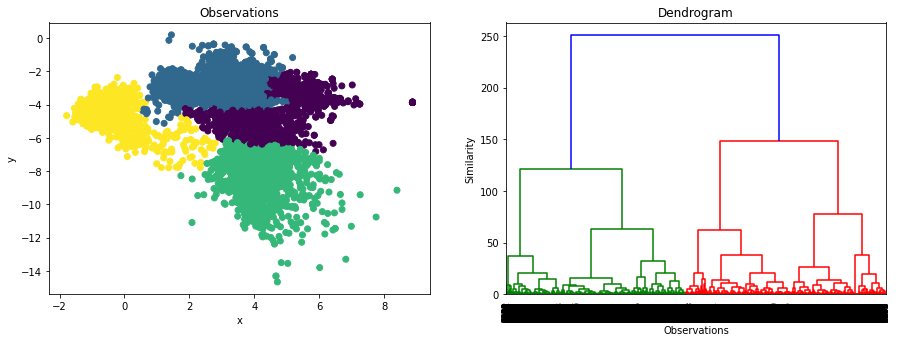

In [ ]:
model = AgglomerativeClustering(linkage=lkg, n_clusters=k)
model.fit(X_reduced_autoencodeur_2D)
labels = model.labels_

CAH_plot(X_reduced_autoencodeur_2D , labels)

## Partie 2

## Reduced k-means et Factorial k-means

### Reduced k-means

In [ ]:
rkm_2D = fcps.TandemClustering(GloVe_embeddings,4,Type="Reduced",PlotIt=False, ndim=2, nstart=10)
rkm_3D = fcps.TandemClustering(GloVe_embeddings,4,Type="Reduced",PlotIt=False, ndim=3, nstart=10)

R[write to console]: Registered S3 method overwritten by 'GGally':
  method from   
  +.gg   ggplot2



  |======================================================================| 100%

In [ ]:
# Reduced k-means
pred_label_rkm_2D = rkm_2D[0]
X_reduced_rkm_2D  = rkm_2D[1][0]

pred_label_rkm_3D = rkm_3D[0]
X_reduced_rkm_3D  = rkm_3D[1][0]

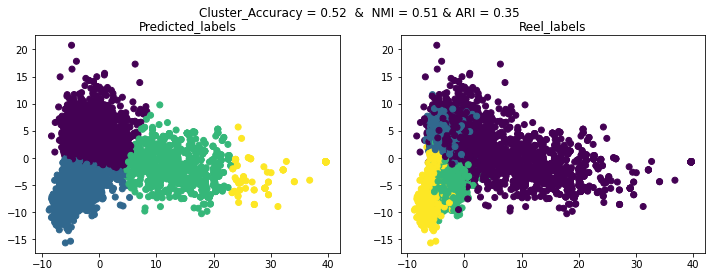

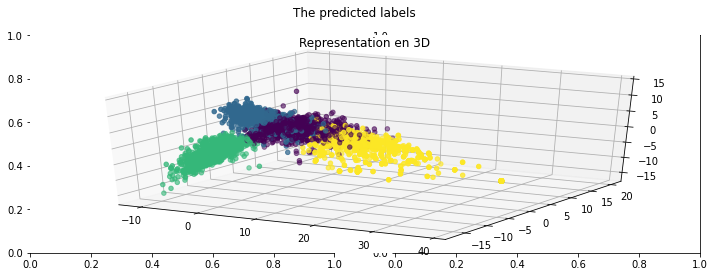

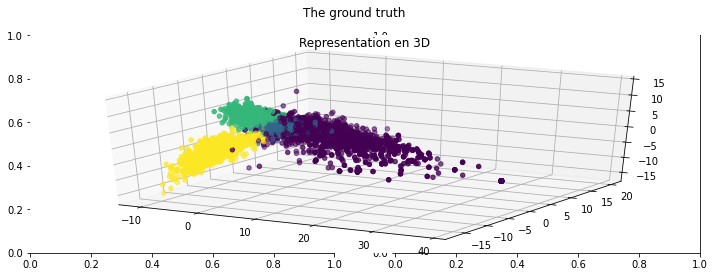

In [ ]:
# Plot 2D
eval_clustering_2D(X_reduced_rkm_2D , pred_label_rkm_2D , label_num)

# Plot 3D
eval_clustering_3D(X_reduced_rkm_3D , pred_label_rkm_3D, 'The predicted labels')
eval_clustering_3D(X_reduced_rkm_3D , label_num,  'The ground truth')

# Plot 3D avec plotly
# eval_clustering_3D_plotly(X_reduced_rkm_3D , pred_label_rkm_3D)

### Factorial k-means

In [ ]:
rkm_2D = fcps.TandemClustering(GloVe_embeddings,4,Type="Factorial",PlotIt=False, ndim=2, nstart=10)
rkm_3D = fcps.TandemClustering(GloVe_embeddings,4,Type="Factorial",PlotIt=False, ndim=3, nstart=10)

  |======================================================================| 100%

In [ ]:
# Factorial k-means
pred_label_rkm_2D = rkm_2D[0]
X_reduced_rkm_2D  = rkm_2D[1][0]

pred_label_rkm_3D = rkm_3D[0]
X_reduced_rkm_3D  = rkm_3D[1][0]

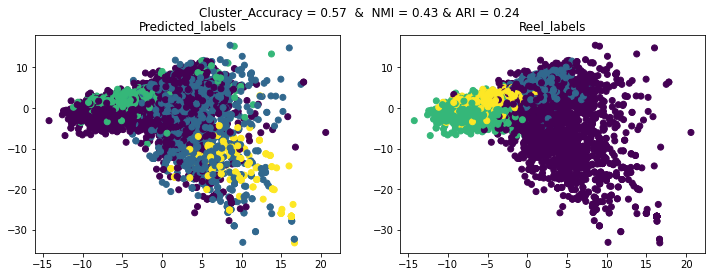

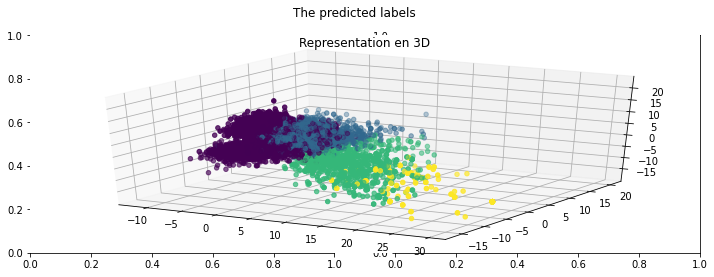

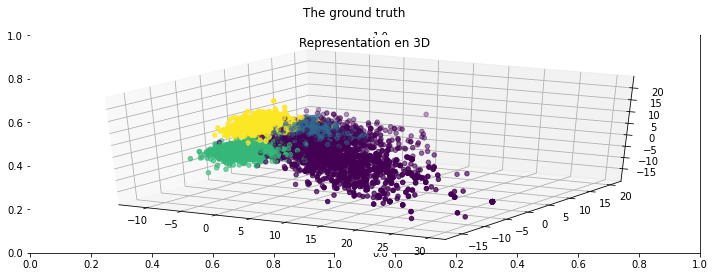

In [ ]:
# Plot 2D
eval_clustering_2D(X_reduced_rkm_2D , pred_label_rkm_2D , label_num)

# Plot 3D
eval_clustering_3D(X_reduced_rkm_3D , pred_label_rkm_3D, 'The predicted labels')
eval_clustering_3D(X_reduced_rkm_3D , label_num,  'The ground truth')

# Plot 3D avec plotly
# eval_clustering_3D_plotly(X_reduced_rkm_3D , pred_label_rkm_3D)

## Deep Clustering Network (DCN)

Voici l'implémentation de 

Deep k-means (DKM) et 

Deep Clustering Network (DCN) en tensorflow. 

Les fonctions à utiliser sont DKM() et DCN(). 

Ne pas hésiter à modifier les paramètres, que ce soit par rapport à l'architecture (nombre/taille des couches, etc.) ou aux paramètres d'apprentissage.

In [ ]:
from DKM_DCN_tf_py import DKM , DCN

In [ ]:
Deep_Clustering_Network = DCN(data = GloVe_embeddings , n_clusters = 4, n_components = 2, n_pretrain_epochs=50, n_finetuning_epochs=50, lambda_=1.0, batch_size=256, seed=None, cpu=False)


/content/DKM_DCN_tf_py.py:21: UserWarning:

`tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.

/usr/local/lib/python3.7/dist-packages/keras/legacy_tf_layers/core.py:255: UserWarning:

`layer.apply` is deprecated and will be removed in a future version. Please use `layer.__call__` method instead.



Starting autoencoder pretraining...


100%|██████████| 50/50 [00:12<00:00,  4.10it/s]


Running k-means on the learned embeddings...
Starting DCN training...


100%|██████████| 50/50 [00:44<00:00,  1.13it/s]


In [ ]:
import tensorflow.compat.v1 as tf
tf.reset_default_graph()

In [ ]:
Deep_Clustering_Network_3D = DCN(data = GloVe_embeddings , n_clusters = 4, n_components = 3, n_pretrain_epochs=50, n_finetuning_epochs=50, lambda_=1.0, batch_size=256, seed=None, cpu=False)


/content/DKM_DCN_tf_py.py:21: UserWarning:

`tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.

/usr/local/lib/python3.7/dist-packages/keras/legacy_tf_layers/core.py:255: UserWarning:

`layer.apply` is deprecated and will be removed in a future version. Please use `layer.__call__` method instead.



Starting autoencoder pretraining...


100%|██████████| 50/50 [00:10<00:00,  4.67it/s]


Running k-means on the learned embeddings...
Starting DCN training...


100%|██████████| 50/50 [00:44<00:00,  1.12it/s]


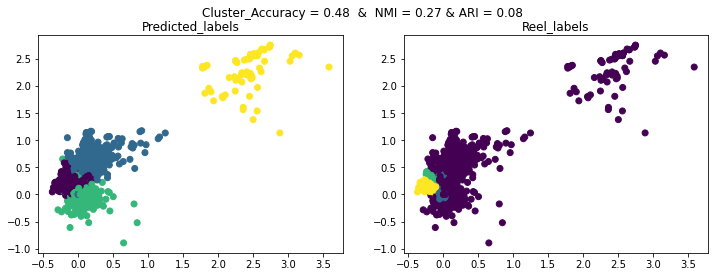

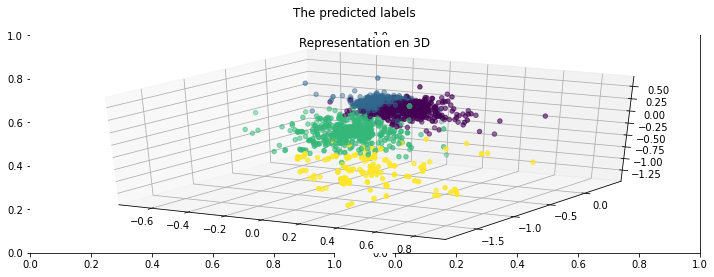

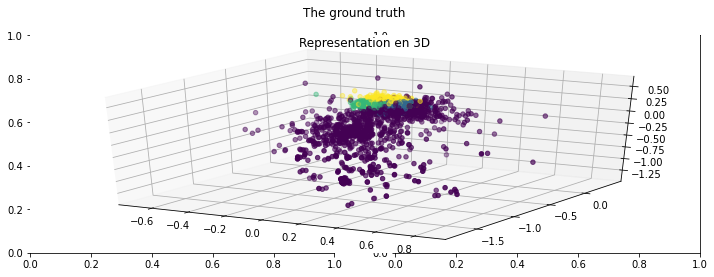

In [ ]:
# Deep Clustering Network
pred_label_DCN = Deep_Clustering_Network[1]
X_reduced_DCN  = Deep_Clustering_Network[0]

pred_label_DCN_3D = Deep_Clustering_Network_3D[1]
X_reduced_DCN_3D  = Deep_Clustering_Network_3D[0]

# Plot 2D
eval_clustering_2D(X_reduced_DCN , pred_label_DCN , label_num)

# Plot 3D
eval_clustering_3D(X_reduced_DCN_3D , pred_label_DCN_3D, 'The predicted labels')
eval_clustering_3D(X_reduced_DCN_3D , label_num,  'The ground truth')

# Plot 3D avec plotly
# eval_clustering_3D_plotly(X_reduced_DCN_3D , pred_label_DCN_3D)

## Deep k-means (DKM)

In [ ]:
tf.reset_default_graph()

In [ ]:
Deep_kmeans_2D = DKM(data = GloVe_embeddings, n_clusters = 4, n_components = 2, n_pretrain_epochs=50, n_finetuning_epochs=5, lambda_=1.0, batch_size=256, seed=None, cpu=False)


/content/DKM_DCN_tf_py.py:21: UserWarning:

`tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.

/usr/local/lib/python3.7/dist-packages/keras/legacy_tf_layers/core.py:255: UserWarning:

`layer.apply` is deprecated and will be removed in a future version. Please use `layer.__call__` method instead.



Starting autoencoder pretraining...


100%|██████████| 50/50 [00:11<00:00,  4.50it/s]


Running k-means on the learned embeddings...
Starting DKM training...


100%|██████████| 20/20 [00:31<00:00,  1.58s/it]


In [ ]:
tf.reset_default_graph()

In [ ]:
Deep_kmeans_3D = DKM(data = GloVe_embeddings, n_clusters = 4, n_components = 3, n_pretrain_epochs=50, n_finetuning_epochs=5, lambda_=1.0, batch_size=256, seed=None, cpu=False)


/content/DKM_DCN_tf_py.py:21: UserWarning:

`tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.

/usr/local/lib/python3.7/dist-packages/keras/legacy_tf_layers/core.py:255: UserWarning:

`layer.apply` is deprecated and will be removed in a future version. Please use `layer.__call__` method instead.



Starting autoencoder pretraining...


100%|██████████| 50/50 [00:10<00:00,  4.59it/s]


Running k-means on the learned embeddings...
Starting DKM training...


100%|██████████| 20/20 [00:30<00:00,  1.52s/it]


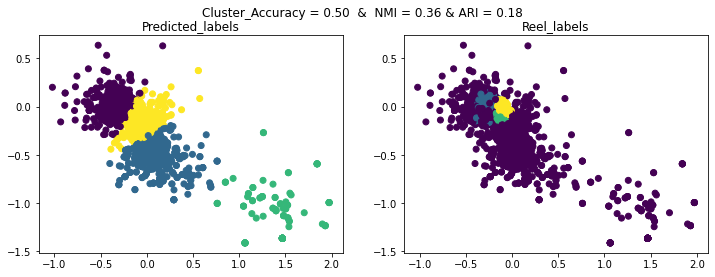

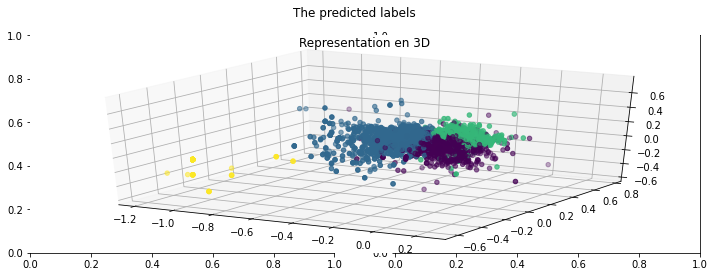

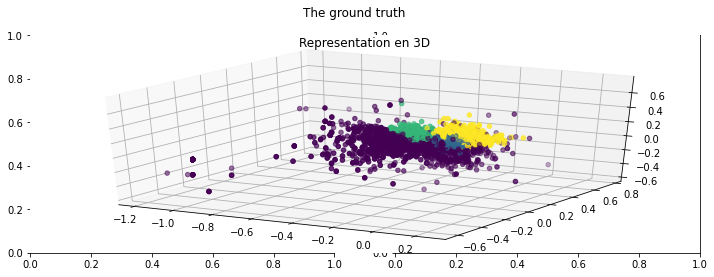

In [ ]:
# Deep k-means (DKM)
pred_label_DKM_2D = Deep_kmeans_2D[1]
X_reduced_DKM_2D  = Deep_kmeans_2D[0]

pred_label_DKM_3D = Deep_kmeans_3D[1]
X_reduced_DKM_3D  = Deep_kmeans_3D[0]

# Plot 2D
eval_clustering_2D(X_reduced_DKM_2D , pred_label_DKM_2D , label_num)

# Plot 3D
eval_clustering_3D(X_reduced_DKM_3D , pred_label_DKM_3D, 'The predicted labels')
eval_clustering_3D(X_reduced_DKM_3D , label_num,  'The ground truth')

# Plot 3D avec plotly
# eval_clustering_3D_plotly(X_reduced_DKM_3D , pred_label_DKM_3D)

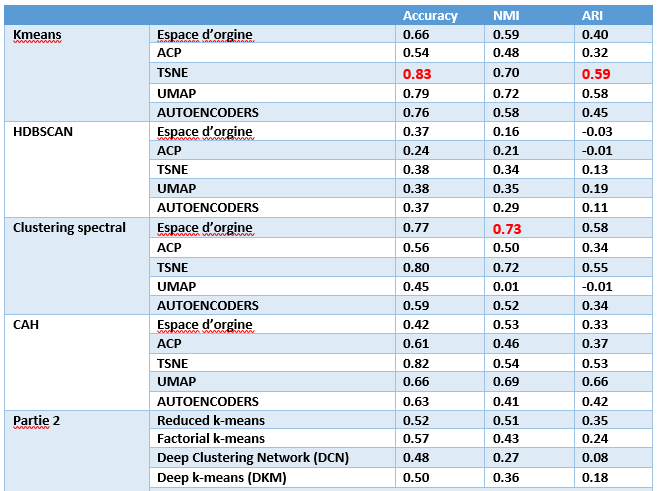

**Interprétation classic4 et Glove :**


D’après les résultats on Remarque que HDBSCAN par rapport aux autres méthodes donne des mauvais résultats.

Nous constatons que les méthodes de clustering (kmeans et Spectral clustering) ont donné des meilleurs résultats comparés aux autres et plus précisément après l’application des méthodes de réduction de dimensionnalité, aussi on remarque que la méthode Kmeans après l’application de T-SNE a un bon score d’accuracy par rapport à tous les méthodes de réduction de dimensionnalité avec un score de 0.83, et de même pour UMAP avec un score de 0.80, par contre, l’algorithme du Clustering Spectrale a donné des bons résultat en terme d’accuracy, NMI et ARI après application de la méthode de réduction de dimensionnalité T-SNE.


# Word2Vec

In [ ]:
!wget -P /root/input/ -c "https://s3.amazonaws.com/dl4j-distribution/GoogleNews-vectors-negative300.bin.gz"

--2021-12-05 15:08:28--  https://s3.amazonaws.com/dl4j-distribution/GoogleNews-vectors-negative300.bin.gz
Resolving s3.amazonaws.com (s3.amazonaws.com)... 52.217.228.232
Connecting to s3.amazonaws.com (s3.amazonaws.com)|52.217.228.232|:443... connected.
HTTP request sent, awaiting response... 416 Requested Range Not Satisfiable

    The file is already fully retrieved; nothing to do.



In [ ]:
EMBEDDING_FILE = '/root/input/GoogleNews-vectors-negative300.bin.gz'
w2v_model = KeyedVectors.load_word2vec_format(EMBEDDING_FILE, binary=True)

In [ ]:
get_w2v_vector = lambda x: w2v_model[x] if x in w2v_model.vocab else None

w2v_embbbeddings = static_document_embeddings(get_w2v_vector , texts_cleaned , tokenize_re)
w2v_embbbeddings.shape

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: Warning:

Zeros returned. Words not in vocabulary "['cobol']"

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: Warning:

Zeros returned. Words not in vocabulary "['neliac']"

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: Warning:

Zeros returned. Words not in vocabulary "['fortran']"

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: Warning:

Zeros returned. Words not in vocabulary "['fdistribution']"

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: Warning:

Zeros returned. Words not in vocabulary "['romberg', 'integrationalgorithm']"



(7095, 300)

## Kmeans 

### Appliquer sur l’espace d’origine

In [ ]:
pred_label_KMeans = KMeans(k, random_state=42).fit(w2v_embbbeddings).labels_

R[write to console]: Loading required namespace: pracma



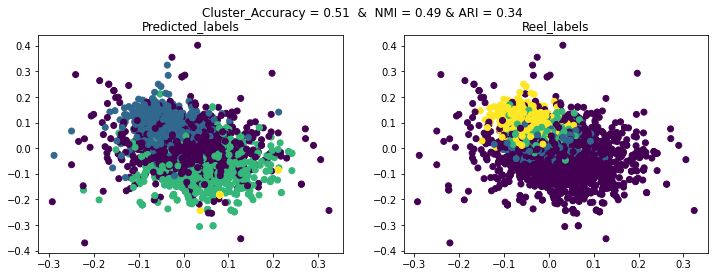

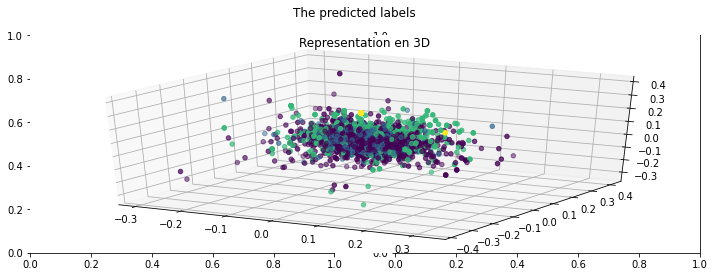

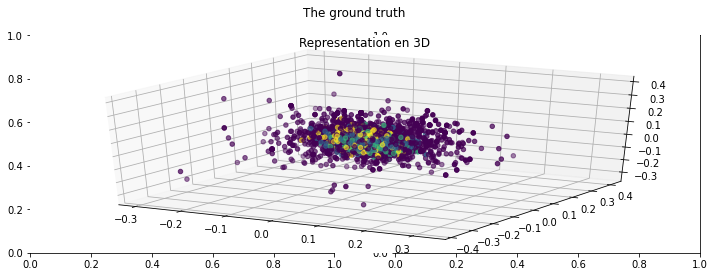

In [ ]:
# Plot 2D
eval_clustering_2D(w2v_embbbeddings , pred_label_KMeans , label_num)

# Plot 3D
eval_clustering_3D(w2v_embbbeddings , pred_label_KMeans, 'The predicted labels')
eval_clustering_3D(w2v_embbbeddings , label_num ,  'The ground truth')


# Plot 3D avec plotly
# eval_clustering_3D_plotly(w2v_embbbeddings , pred_label_KMeans)

### ACP

In [ ]:
# ACP
X_reduced_pca_2D = PCA(n_components=2, whiten=True, random_state=42).fit_transform(w2v_embbbeddings)
X_reduced_pca_3D = PCA(n_components=3, whiten=True, random_state=42).fit_transform(w2v_embbbeddings)

In [ ]:

# Kmeans
pred_label_PCA = KMeans(k, random_state=42).fit(X_reduced_pca_2D).labels_
pred_label_PCA_3 = KMeans(k, random_state=42).fit(X_reduced_pca_3D).labels_


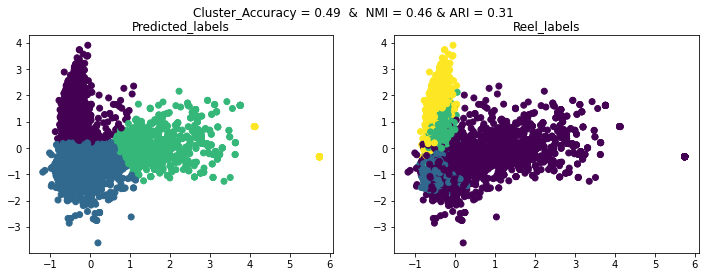

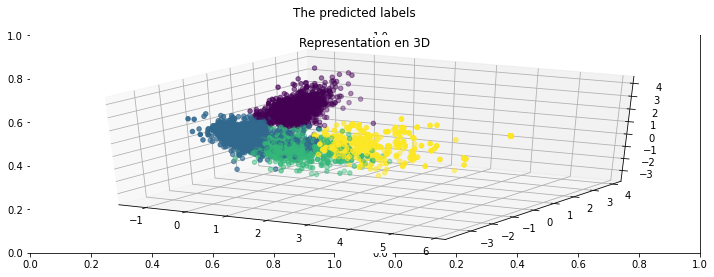

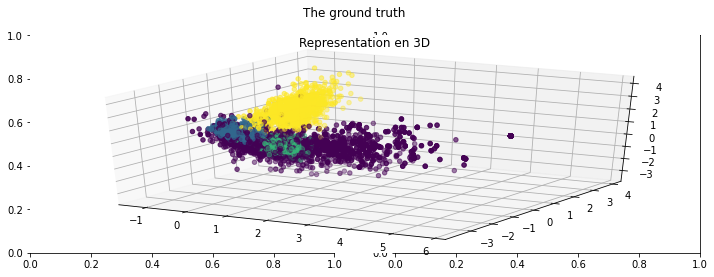

In [ ]:
# Plot 2D
eval_clustering_2D(X_reduced_pca_2D,pred_label_PCA,label_num)

# Plot 3D
eval_clustering_3D(X_reduced_pca_3D,pred_label_PCA_3 , 'The predicted labels')
eval_clustering_3D(X_reduced_pca_3D,label_num ,  'The ground truth' )

# Plot 3D avec plotly
# eval_clustering_3D_plotly(X_reduced_pca_3D,pred_label_PCA_3)

### Tsne

In [ ]:
# TSNE
X_reduced_tsne_2D = TSNE(n_components=2, random_state=42).fit_transform(w2v_embbbeddings)
X_reduced_tsne_3D = TSNE(n_components=3, random_state=42).fit_transform(w2v_embbbeddings)

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:783: FutureWarning:

The default initialization in TSNE will change from 'random' to 'pca' in 1.2.

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning:

The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:783: FutureWarning:

The default initialization in TSNE will change from 'random' to 'pca' in 1.2.

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning:

The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.



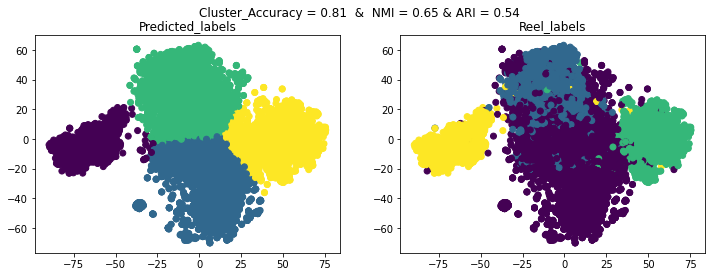

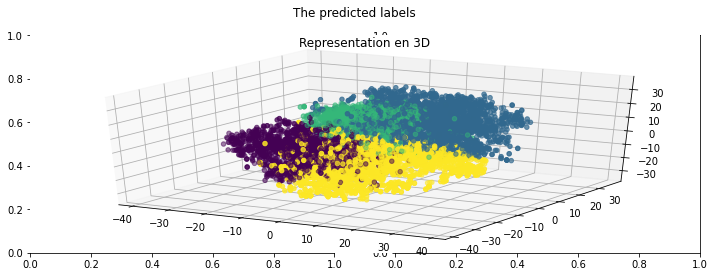

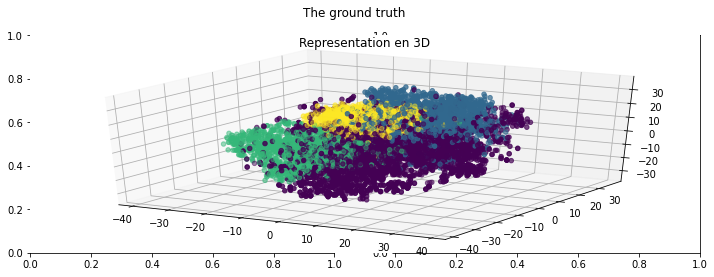

In [ ]:
# Kmeans
pred_label_KMeans = KMeans(k, random_state=42).fit(X_reduced_tsne_2D).labels_
pred_label_KMeans_3D = KMeans(k, random_state=42).fit(X_reduced_tsne_3D).labels_

# Plot 2D
eval_clustering_2D(X_reduced_tsne_2D , pred_label_KMeans , label_num)

# Plot 3D
eval_clustering_3D(X_reduced_tsne_3D , pred_label_KMeans_3D, 'The predicted labels')
eval_clustering_3D(X_reduced_tsne_3D , label_num,  'The ground truth')

# Plot 3D avec plotly
# eval_clustering_3D_plotly(X_reduced_tsne_3D , pred_label_KMeans_3D)

### UMAP

In [ ]:
# UMAP
X_reduced_u_map_2D = UMAP(n_components=2, random_state=42).fit_transform(w2v_embbbeddings)
X_reduced_u_map_3D = UMAP(n_components=3, random_state=42).fit_transform(w2v_embbbeddings)

/usr/local/lib/python3.7/dist-packages/numba/np/ufunc/parallel.py:363: NumbaWarning:

The TBB threading layer requires TBB version 2019.5 or later i.e., TBB_INTERFACE_VERSION >= 11005. Found TBB_INTERFACE_VERSION = 9107. The TBB threading layer is disabled.



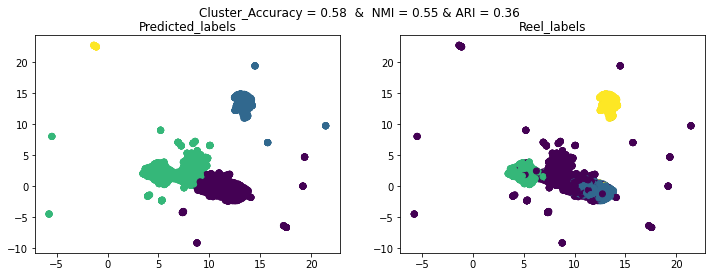

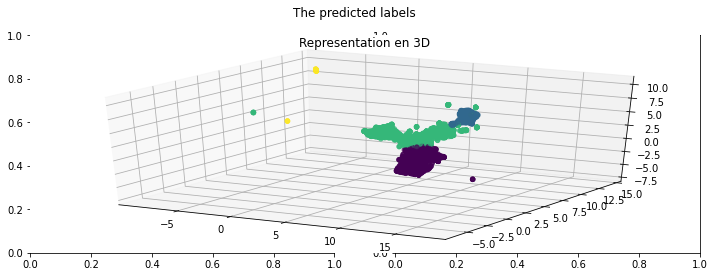

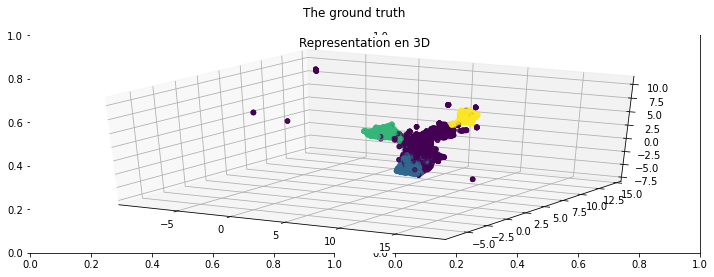

In [ ]:

# KMeans
pred_label_KMeans = KMeans(k, random_state=42).fit(X_reduced_u_map_2D).labels_
pred_label_KMeans_3D = KMeans(k, random_state=42).fit(X_reduced_u_map_3D).labels_

# Plot 2D
eval_clustering_2D(X_reduced_u_map_2D , pred_label_KMeans , label_num)

# Plot 3D
eval_clustering_3D(X_reduced_u_map_3D , pred_label_KMeans_3D, 'The predicted labels')
eval_clustering_3D(X_reduced_u_map_3D , label_num,  'The ground truth')

# Plot 3D avec plotly
# eval_clustering_3D_plotly(X_reduced_u_map_3D , pred_label_KMeans_3D)

### Autoencodeurs

In [ ]:
class AutoEncoder(torch.nn.Module):
    def __init__(self, input_dim, embedding_dim):
        super().__init__()
        self.input_dim = input_dim
        self.embedding_dim = embedding_dim

        self.encoder = torch.nn.Sequential(
            torch.nn.Linear(self.input_dim, 128),
            torch.nn.ReLU(),
            torch.nn.Linear(128, self.embedding_dim)
        )
        
        self.decoder = torch.nn.Sequential(
            torch.nn.Linear(self.embedding_dim, 128),
            torch.nn.ReLU(),
            torch.nn.Linear(128, self.input_dim),
            torch.nn.Sigmoid()
        )

    def forward(self, x):
        encoded = self.encoder(x)
        decoded = self.decoder(encoded)
        return decoded

def autoencoder(X, embedding_dim, n_epochs=50, batch_size=64, learning_rate=1e-3, weight_decay=1e-8, seed=None, return_model=False):
    if torch.cuda.is_available():
        device = 'cuda'
    else:
        device = 'cpu'

    if seed is not None:
      torch.manual_seed(seed)

    dataloader = DataLoader(dataset=X, batch_size=batch_size, shuffle=True)

    model = AutoEncoder(input_dim=X.shape[1], embedding_dim=embedding_dim)

    if device == 'cuda':
      model.cuda()

    loss_function = torch.nn.MSELoss()

    optimizer = torch.optim.Adam(model.parameters(),
                                lr=learning_rate,
                                weight_decay=weight_decay)

    losses = []

    model.train()
    for epoch in tqdm(range(n_epochs)):
        for batch in dataloader:
          batch = batch.to(device)
          reconstructed = model(batch)
          
          loss = loss_function(reconstructed, batch)
          
          optimizer.zero_grad()
          loss.backward()
          optimizer.step()
          
          losses.append(loss)

    model.eval()
    tensor_X = torch.tensor(X)
    tensor_X = tensor_X.to(device)
    encoded_X = model.encoder(tensor_X)
    encoded_X = encoded_X.detach().cpu().numpy()

    if return_model:
      return encoded_X, model, losses
    else:
      return encoded_X


In [ ]:
# AutoEncoder
X_reduced_autoencodeur_2D = autoencoder(w2v_embbbeddings.astype("float32"),2, seed=42)
X_reduced_autoencodeur_3D = autoencoder(w2v_embbbeddings.astype("float32"),3, seed=42)

100%|██████████| 50/50 [00:16<00:00,  3.00it/s]


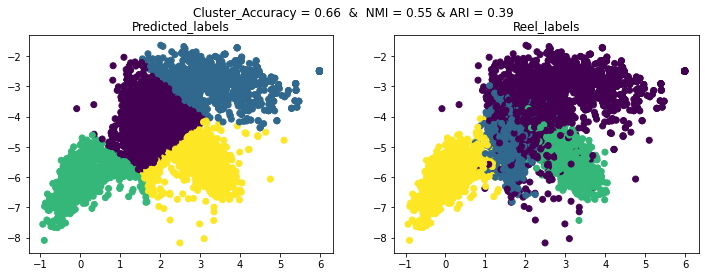

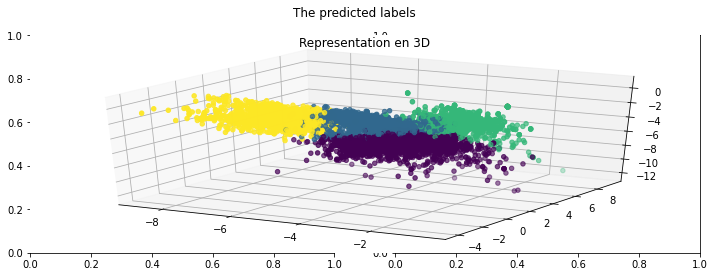

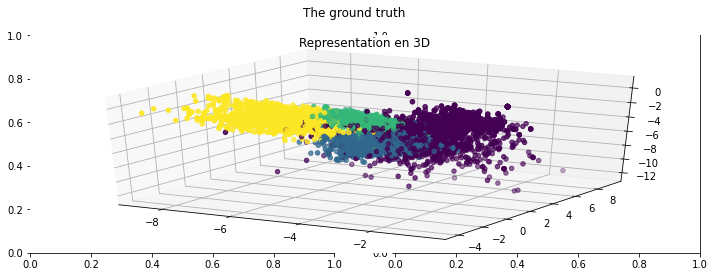

In [ ]:
# KMeans
pred_label_KMeans = KMeans(k, random_state=42).fit(X_reduced_autoencodeur_2D).labels_
pred_label_KMeans_3D = KMeans(k, random_state=42).fit(X_reduced_autoencodeur_3D).labels_

# Plot 2D
eval_clustering_2D(X_reduced_autoencodeur_2D , pred_label_KMeans , label_num)

# Plot 3D
eval_clustering_3D(X_reduced_autoencodeur_3D , pred_label_KMeans_3D, 'The predicted labels')
eval_clustering_3D(X_reduced_autoencodeur_3D , label_num,  'The ground truth')

# Plot 3D avec plotly
# eval_clustering_3D_plotly(X_reduced_autoencodeur_3D , pred_label_KMeans_3D)

## HDBSCAN

### Appliquer  sur l’espace d’origine


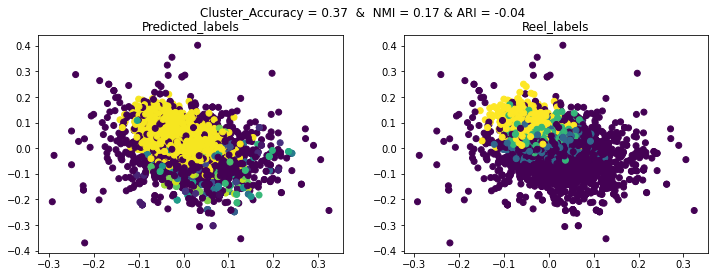

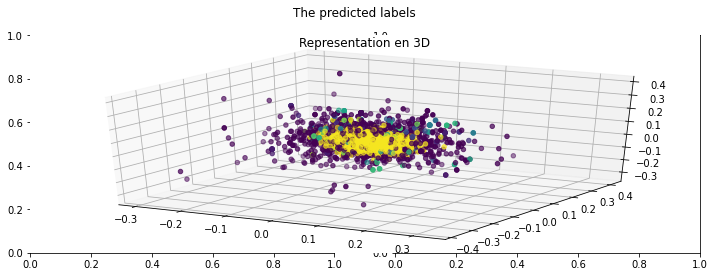

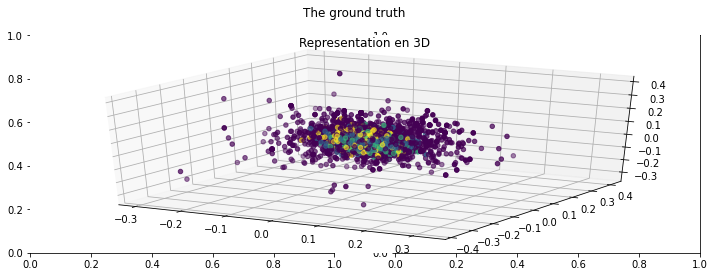

In [ ]:
# hdbscan model
hdbscan_model = hdbscan.HDBSCAN(min_cluster_size=4,algorithm="best",alpha=1.0,leaf_size=40,cluster_selection_method='eom',metric='euclidean').fit(w2v_embbbeddings)
pred_label_hdbscan = hdbscan_model.labels_

# Plot 2D
eval_clustering_2D(w2v_embbbeddings , pred_label_hdbscan , label_num)

# Plot 3D
eval_clustering_3D(w2v_embbbeddings , pred_label_hdbscan, 'The predicted labels')
eval_clustering_3D(w2v_embbbeddings , label_num ,  'The ground truth')


# Plot 3D avec plotly
# eval_clustering_3D_plotly(w2v_embbbeddings , pred_label_hdbscan)

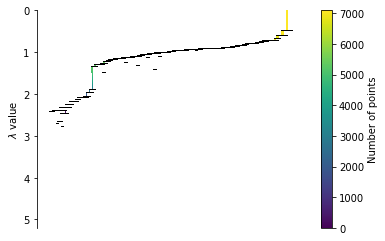

In [ ]:
hdbscan_model.condensed_tree_.plot()

### ACP

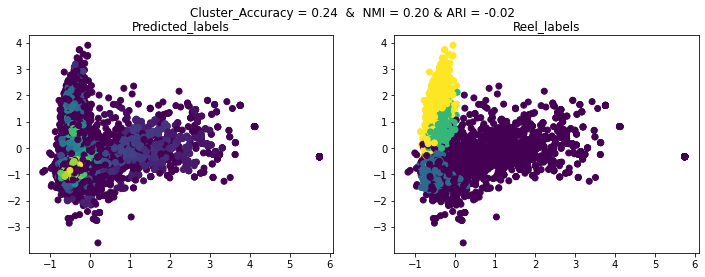

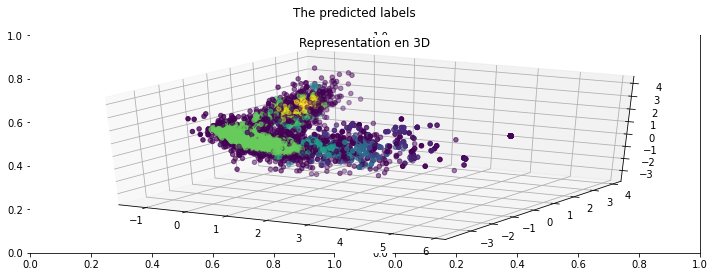

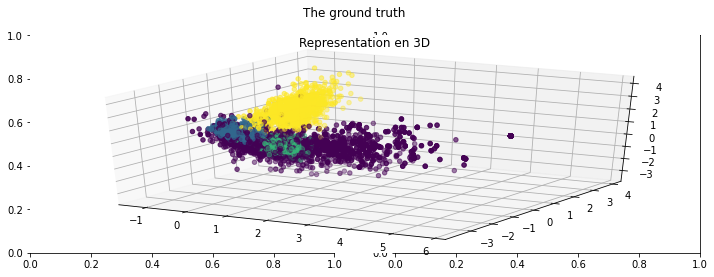

In [ ]:
# HDBSCAN
hdbscan_model = hdbscan.HDBSCAN(min_cluster_size=4,algorithm="best",alpha=1.0,leaf_size=40,cluster_selection_method='eom',metric='euclidean').fit(X_reduced_pca_2D)
pred_label_hdbscan = hdbscan_model.labels_
hdbscan_model_3D = hdbscan.HDBSCAN(min_cluster_size=4,algorithm="best",alpha=1.0,leaf_size=40,cluster_selection_method='eom',metric='euclidean').fit(X_reduced_pca_3D)
pred_label_hdbscan_3D = hdbscan_model_3D.labels_

# Plot 2D
eval_clustering_2D(X_reduced_pca_2D , pred_label_hdbscan , label_num)

# Plot 3D
eval_clustering_3D(X_reduced_pca_3D , pred_label_hdbscan_3D, 'The predicted labels')
eval_clustering_3D(X_reduced_pca_3D , label_num,  'The ground truth')

# Plot 3D avec plotly
# eval_clustering_3D_plotly(X_reduced_pca_3D , pred_label_hdbscan_3D)

### t-SNE

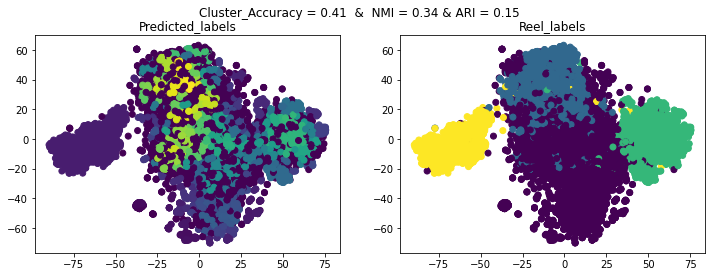

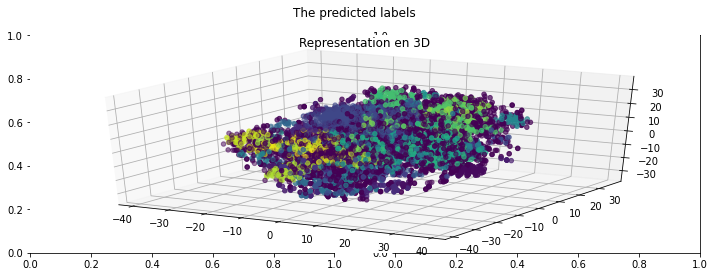

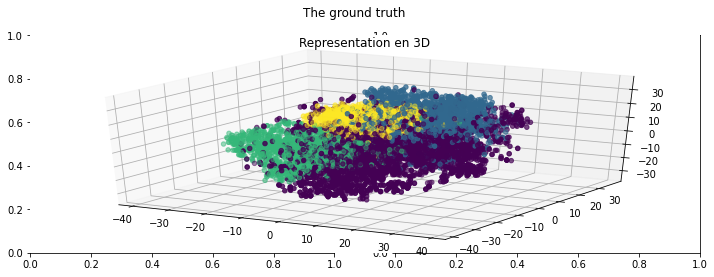

In [ ]:
# HDBSCAN
hdbscan_model = hdbscan.HDBSCAN(min_cluster_size=4,algorithm="best",alpha=1.0,leaf_size=40,cluster_selection_method='eom',metric='euclidean').fit(X_reduced_tsne_2D)
pred_label_hdbscan = hdbscan_model.labels_
hdbscan_model_3D = hdbscan.HDBSCAN(min_cluster_size=4,algorithm="best",alpha=1.0,leaf_size=40,cluster_selection_method='eom',metric='euclidean').fit(X_reduced_tsne_3D)
pred_label_hdbscan_3D = hdbscan_model_3D.labels_

# Plot 2D
eval_clustering_2D(X_reduced_tsne_2D , pred_label_hdbscan , label_num)

# Plot 3D
eval_clustering_3D(X_reduced_tsne_3D , pred_label_hdbscan_3D, 'The predicted labels')
eval_clustering_3D(X_reduced_tsne_3D , label_num,  'The ground truth')

# Plot 3D avec plotly
# eval_clustering_3D_plotly(X_reduced_tsne_3D , pred_label_hdbscan_3D)

### UMAP

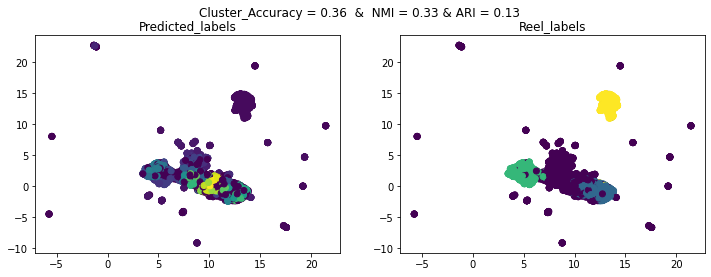

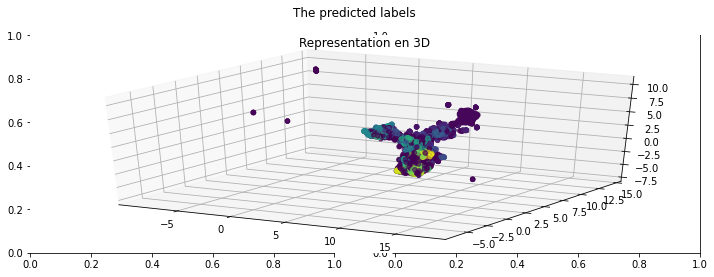

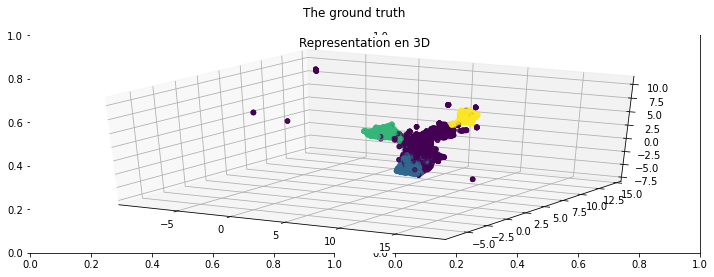

In [ ]:
# HDBSCAN
hdbscan_model = hdbscan.HDBSCAN(min_cluster_size=4,algorithm="best",alpha=1.0,leaf_size=40,cluster_selection_method='eom',metric='euclidean').fit(X_reduced_u_map_2D)
pred_label_hdbscan = hdbscan_model.labels_
hdbscan_model_3D = hdbscan.HDBSCAN(min_cluster_size=4,algorithm="best",alpha=1.0,leaf_size=40,cluster_selection_method='eom',metric='euclidean').fit(X_reduced_u_map_3D)
pred_label_hdbscan_3D = hdbscan_model_3D.labels_

# Plot 2D
eval_clustering_2D(X_reduced_u_map_2D , pred_label_hdbscan , label_num)

# Plot 3D
eval_clustering_3D(X_reduced_u_map_3D , pred_label_hdbscan_3D, 'The predicted labels')
eval_clustering_3D(X_reduced_u_map_3D , label_num,  'The ground truth')

# Plot 3D avec plotly
# eval_clustering_3D_plotly(X_reduced_u_map_3D , pred_label_hdbscan_3D)

### Autoencodeurs

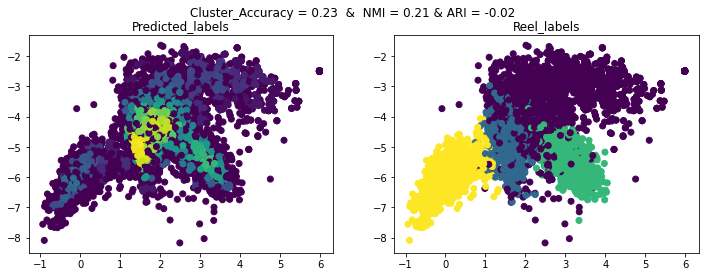

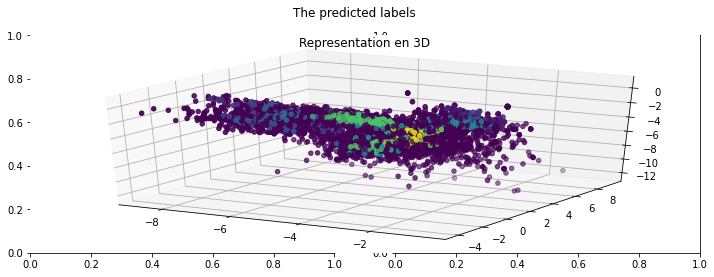

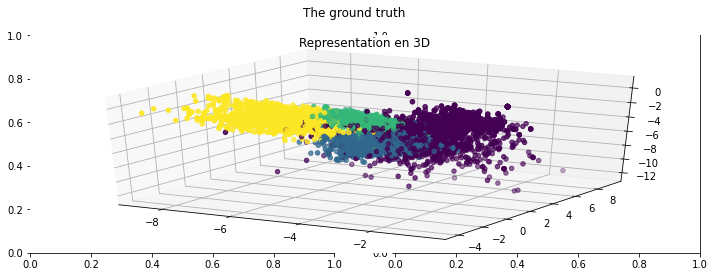

In [ ]:
# HDBSCAN
hdbscan_model = hdbscan.HDBSCAN(min_cluster_size=4,algorithm="best",alpha=1.0,leaf_size=40,cluster_selection_method='eom',metric='euclidean').fit(X_reduced_autoencodeur_2D)
pred_label_hdbscan = hdbscan_model.labels_
hdbscan_model_3D = hdbscan.HDBSCAN(min_cluster_size=4,algorithm="best",alpha=1.0,leaf_size=40,cluster_selection_method='eom',metric='euclidean').fit(X_reduced_autoencodeur_3D)
pred_label_hdbscan_3D = hdbscan_model_3D.labels_

# Plot 2D
eval_clustering_2D(X_reduced_autoencodeur_2D , pred_label_hdbscan , label_num)

# Plot 3D
eval_clustering_3D(X_reduced_autoencodeur_3D , pred_label_hdbscan_3D, 'The predicted labels')
eval_clustering_3D(X_reduced_autoencodeur_3D , label_num,  'The ground truth')

# Plot 3D avec plotly
# eval_clustering_3D_plotly(X_reduced_autoencodeur_3D , pred_label_hdbscan_3D)

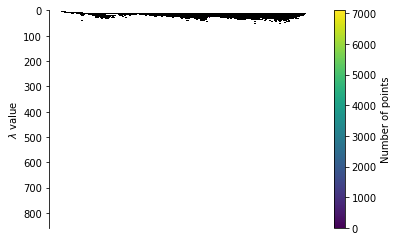

In [ ]:
hdbscan_model.condensed_tree_.plot()

## Clustering spectral


### appliquer  sur l’espace d’origine


In [ ]:
pred_label_spectral = SpectralClustering(k,affinity="nearest_neighbors",n_neighbors=10,random_state=42).fit(w2v_embbbeddings).labels_
print(round(normalized_mutual_info_score(pred_label_spectral,label),2))

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_spectral_embedding.py:261: UserWarning:

Graph is not fully connected, spectral embedding may not work as expected.



0.7


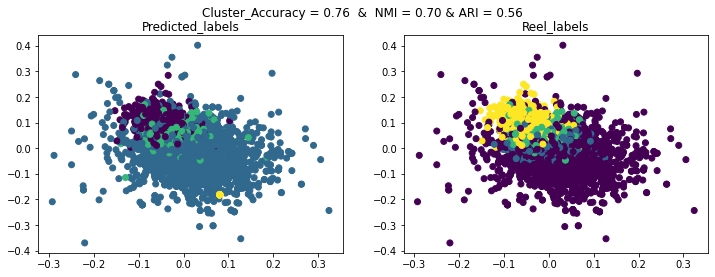

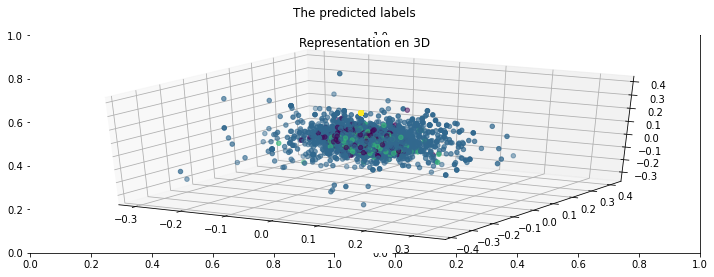

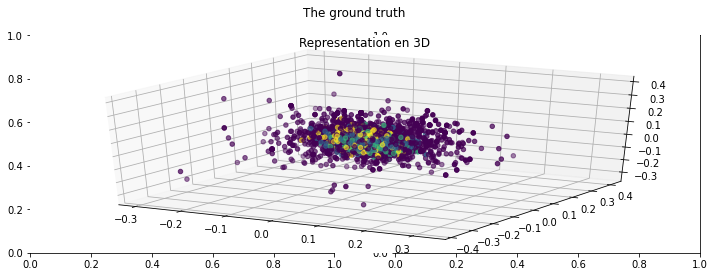

In [ ]:
# Plot 2D
eval_clustering_2D(w2v_embbbeddings , pred_label_spectral , label_num)

# Plot 3D
eval_clustering_3D(w2v_embbbeddings , pred_label_spectral, 'The predicted labels')
eval_clustering_3D(w2v_embbbeddings , label_num ,  'The ground truth')


# Plot 3D avec plotly
# eval_clustering_3D_plotly(X_reduced_pca_3 , pred_label_PCA_3)

### appliquer sur ACP

In [ ]:
# Spectral Clustering
pred_label_spectral = SpectralClustering(k,affinity="nearest_neighbors",n_neighbors=10,random_state=42).fit(X_reduced_pca_2D).labels_
pred_label_spectral_3D = SpectralClustering(k,affinity="nearest_neighbors",n_neighbors=10,random_state=42).fit(X_reduced_pca_3D).labels_



/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_spectral_embedding.py:261: UserWarning:

Graph is not fully connected, spectral embedding may not work as expected.

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_spectral_embedding.py:261: UserWarning:

Graph is not fully connected, spectral embedding may not work as expected.



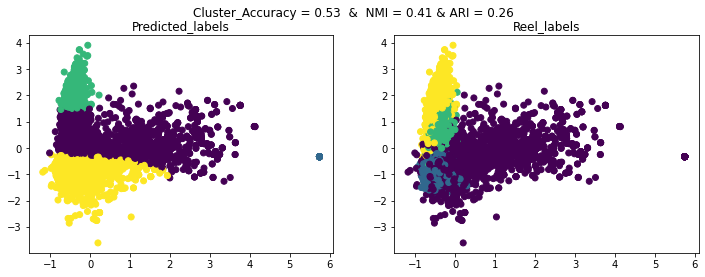

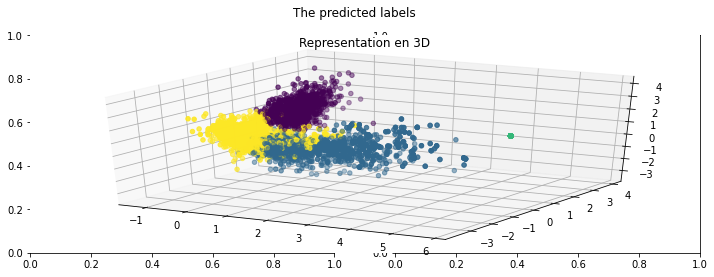

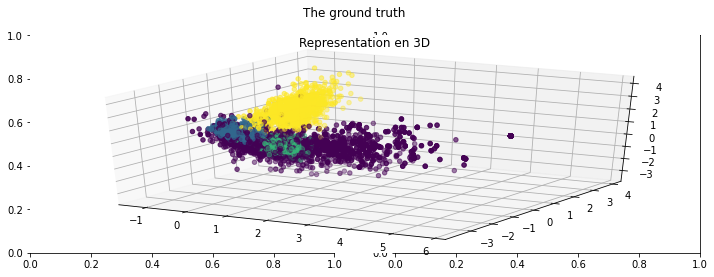

In [ ]:
# Plot 2D
eval_clustering_2D(X_reduced_pca_2D , pred_label_spectral , label_num)

# Plot 3D
eval_clustering_3D(X_reduced_pca_3D , pred_label_spectral_3D, 'The predicted labels')
eval_clustering_3D(X_reduced_pca_3D , label_num,  'The ground truth')

# Plot 3D avec plotly
# eval_clustering_3D_plotly(X_reduced_pca_3D , pred_label_spectral_3D)

### t-SNE

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_spectral_embedding.py:261: UserWarning:

Graph is not fully connected, spectral embedding may not work as expected.

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_spectral_embedding.py:261: UserWarning:

Graph is not fully connected, spectral embedding may not work as expected.



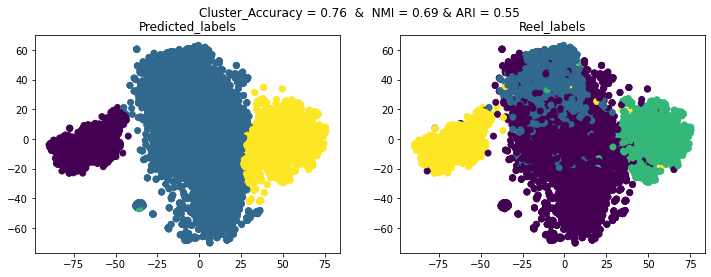

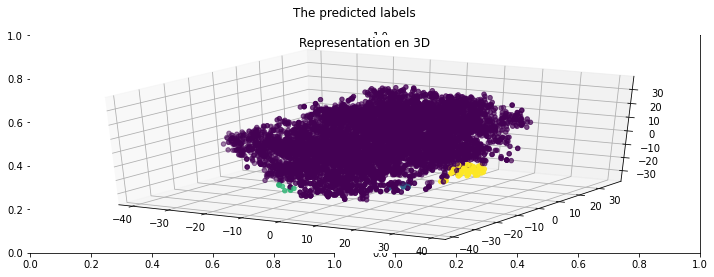

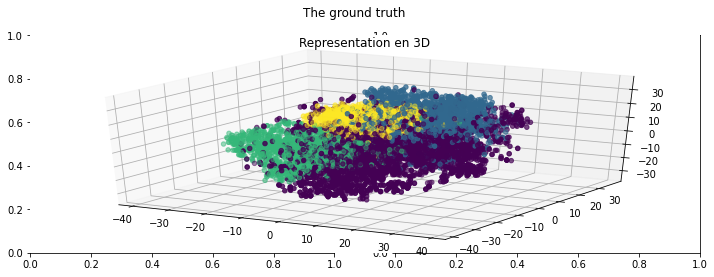

In [ ]:
# Spectral Clustering
pred_label_spectral = SpectralClustering(k,affinity="nearest_neighbors",n_neighbors=10,random_state=42).fit(X_reduced_tsne_2D).labels_
pred_label_spectral_3D = SpectralClustering(k,affinity="nearest_neighbors",n_neighbors=10,random_state=42).fit(X_reduced_tsne_3D).labels_

# Plot 2D
eval_clustering_2D(X_reduced_tsne_2D , pred_label_spectral , label_num)

# Plot 3D
eval_clustering_3D(X_reduced_tsne_3D , pred_label_spectral_3D, 'The predicted labels')
eval_clustering_3D(X_reduced_tsne_3D , label_num,  'The ground truth')

# Plot 3D avec plotly
# eval_clustering_3D_plotly(X_reduced_tsne_3D , pred_label_spectral_3D)

###  UMAP

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_spectral_embedding.py:261: UserWarning:

Graph is not fully connected, spectral embedding may not work as expected.

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_spectral_embedding.py:261: UserWarning:

Graph is not fully connected, spectral embedding may not work as expected.



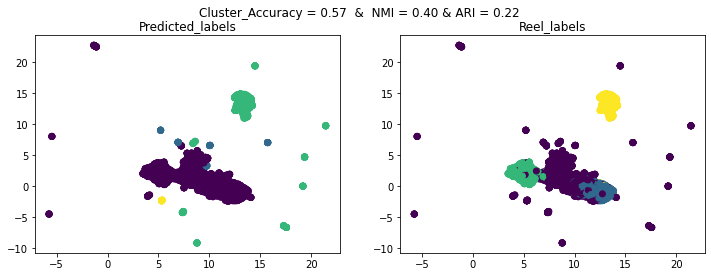

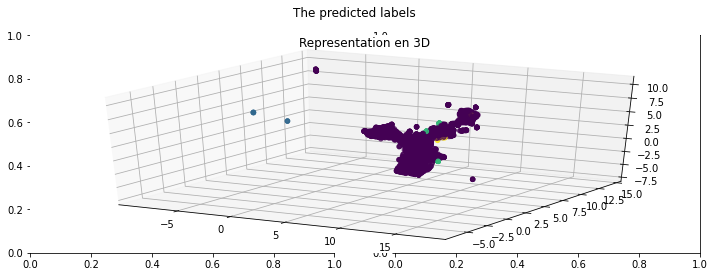

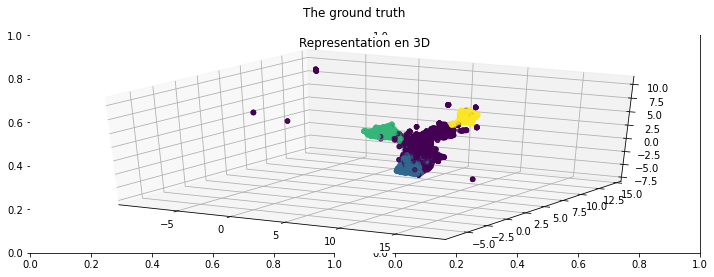

In [ ]:
# Spectral Clustering
pred_label_spectral = SpectralClustering(k,affinity="nearest_neighbors",n_neighbors=10,random_state=42).fit(X_reduced_u_map_2D).labels_
pred_label_spectral_3D = SpectralClustering(k,affinity="nearest_neighbors",n_neighbors=10,random_state=42).fit(X_reduced_u_map_3D).labels_

# Plot 2D
eval_clustering_2D(X_reduced_u_map_2D , pred_label_spectral , label_num)

# Plot 3D
eval_clustering_3D(X_reduced_u_map_3D , pred_label_spectral_3D, 'The predicted labels')
eval_clustering_3D(X_reduced_u_map_3D , label_num,  'The ground truth')

# Plot 3D avec plotly
# eval_clustering_3D_plotly(X_reduced_u_map_3D , pred_label_spectral_3D)

###  Autoencodeurs

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_spectral_embedding.py:261: UserWarning:

Graph is not fully connected, spectral embedding may not work as expected.

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_spectral_embedding.py:261: UserWarning:

Graph is not fully connected, spectral embedding may not work as expected.



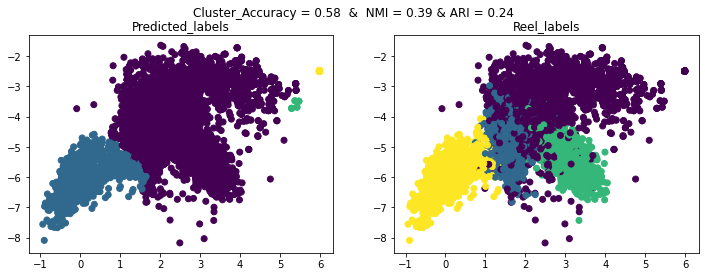

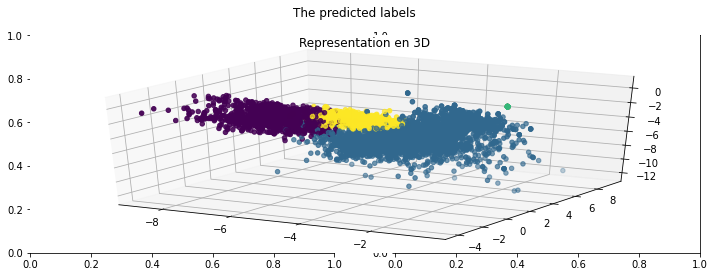

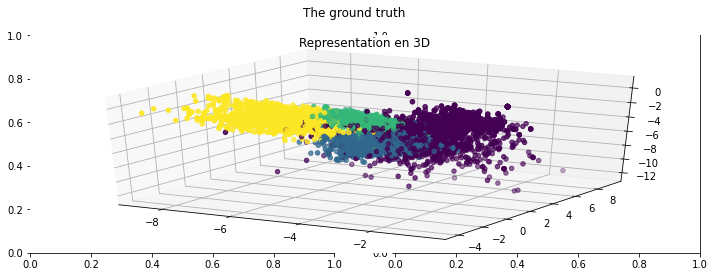

In [ ]:

# Spectral Clustering
pred_label_spectral = SpectralClustering(k,affinity="nearest_neighbors",n_neighbors=10,random_state=42).fit(X_reduced_autoencodeur_2D).labels_
pred_label_spectral_3D = SpectralClustering(k,affinity="nearest_neighbors",n_neighbors=10,random_state=42).fit(X_reduced_autoencodeur_3D).labels_

# Plot 2D
eval_clustering_2D(X_reduced_autoencodeur_2D , pred_label_spectral , label_num)

# Plot 3D
eval_clustering_3D(X_reduced_autoencodeur_3D , pred_label_spectral_3D, 'The predicted labels')
eval_clustering_3D(X_reduced_autoencodeur_3D , label_num,  'The ground truth')

# Plot 3D avec plotly
# eval_clustering_3D_plotly(X_reduced_autoencodeur_3D , pred_label_spectral_3D)

## CAH

In [ ]:
k = 4        # nombre de clusters
lkg = "ward" # métrique choisie dans le regroupement hiérarchique / critères d'agrégation

### Appliquer  sur l’espace d’origine


In [ ]:
from sklearn.cluster import AgglomerativeClustering # génération de modèles de clustering
from scipy.cluster import hierarchy  # dendrogramme

# Créer un modèle de regroupement hiérarchique
# Trouver les étiquettes
cah_model = AgglomerativeClustering(linkage=lkg, n_clusters=k)
cah_model.fit(w2v_embbbeddings)
cah_pred_labels = cah_model.labels_


In [ ]:
import matplotlib.gridspec as gridspec

def CAH_plot(X , Labels , linkage=lkg):
    f_ex = plt.figure(figsize=(15,5))
    gs = gridspec.GridSpec(1,2)


    ax = f_ex.add_subplot(gs[0,0])
    ax.set_title("Observations")
    ax.set_xlabel("x")
    ax.set_ylabel("y")
    dendro =f_ex.add_subplot(gs[0,1])


    Z = hierarchy.linkage(X, linkage)
    # Sur la base de la matrice Z, créez le dendrogramme
    # recherchez scipy.cluster.hierarchy.dendrogram() pour implémenter cette tâche.
    hierarchy.dendrogram(
        Z,
        leaf_rotation=90.,  # rotates the x axis labels
        leaf_font_size=8.,  # font size for the x axis labels
    )


    dendro.set_title("Dendrogram")
    dendro.set_xlabel("Observations")
    dendro.set_ylabel("Similarity")

    ax.scatter(X[:,0],X[:,1], c=Labels, cmap='viridis')

    # boucle pour ajouter un exemple d'index en tant qu'étiquette
    # n, _ = X.shape
    # for i in range(n):
    #     ax.annotate("  " + str(i), (X[i,0],X[i,1]) )

    plt.show()

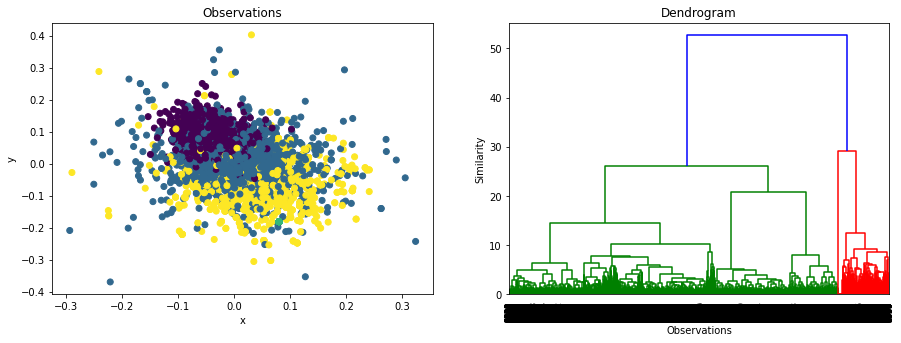

In [ ]:
CAH_plot(w2v_embbbeddings , cah_pred_labels)

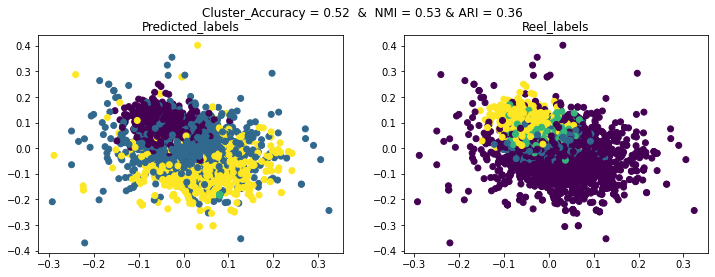

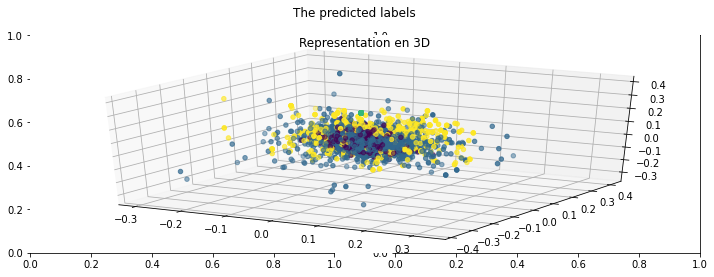

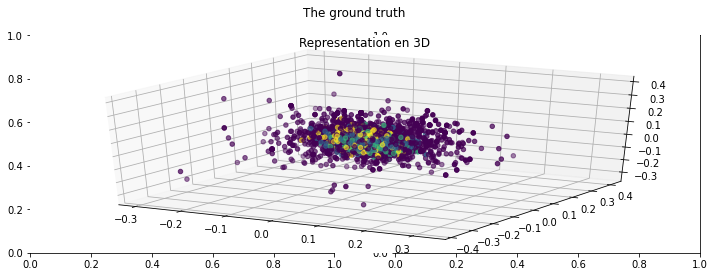

In [ ]:
# Plot 2D
eval_clustering_2D(w2v_embbbeddings , cah_pred_labels , label_num)

# Plot 3D
eval_clustering_3D(w2v_embbbeddings , cah_pred_labels, 'The predicted labels')
eval_clustering_3D(w2v_embbbeddings , label_num,  'The ground truth')

# Plot 3D avec plotly
# eval_clustering_3D_plotly(w2v_embbbeddings , cah_pred_labels)

### ACP

In [ ]:
cah_model = AgglomerativeClustering(linkage=lkg, n_clusters=k)
cah_model.fit(X_reduced_pca_2D)
cah_pred_labels = cah_model.labels_


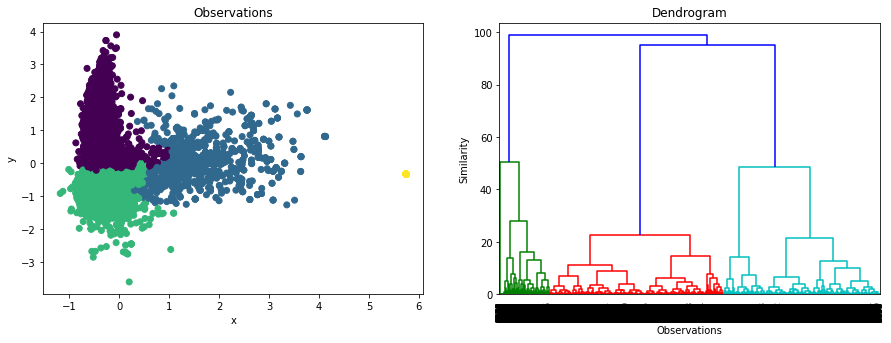

In [ ]:
CAH_plot(X_reduced_pca_2D , cah_pred_labels)

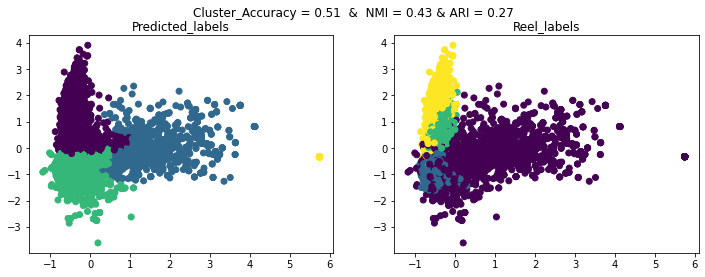

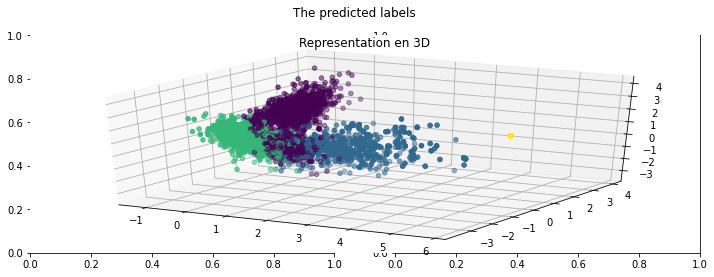

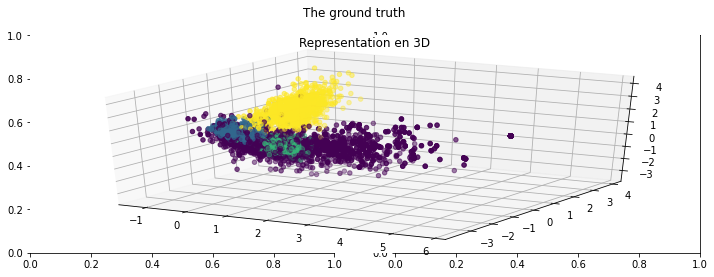

In [ ]:
# Plot 2D
eval_clustering_2D(X_reduced_pca_2D , cah_pred_labels , label_num)

# Plot 3D
eval_clustering_3D(X_reduced_pca_3D , cah_pred_labels, 'The predicted labels')
eval_clustering_3D(X_reduced_pca_3D , label_num,  'The ground truth')

# Plot 3D avec plotly
# eval_clustering_3D_plotly(X_reduced_pca_2D , cah_pred_labels)

### t-SNE

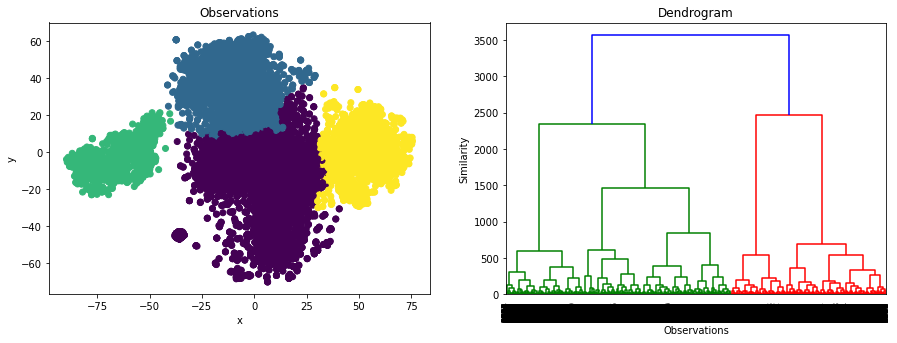

In [ ]:
model = AgglomerativeClustering(linkage=lkg, n_clusters=k)
model.fit(X_reduced_tsne_2D)
labels = model.labels_

CAH_plot(X_reduced_tsne_2D , labels)

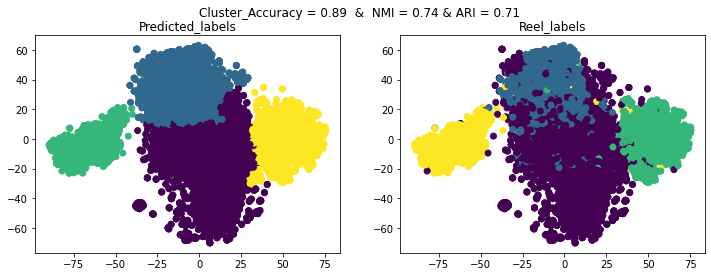

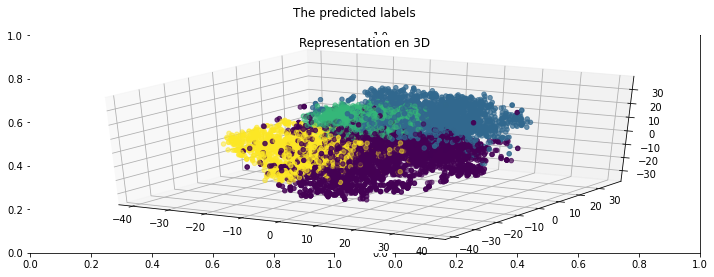

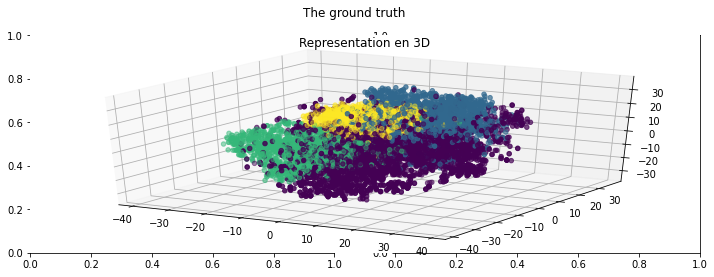

In [ ]:
# Plot 2D
eval_clustering_2D(X_reduced_tsne_2D , labels , label_num)

# Plot 3D
eval_clustering_3D(X_reduced_tsne_3D , labels, 'The predicted labels')
eval_clustering_3D(X_reduced_tsne_3D , label_num,  'The ground truth')

# Plot 3D avec plotly
# eval_clustering_3D_plotly(X_reduced_tsne_3D , labels)

### UMAP

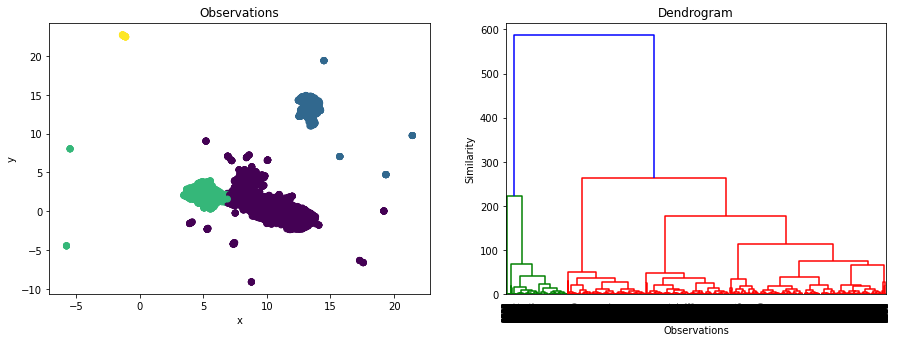

In [ ]:
model = AgglomerativeClustering(linkage=lkg, n_clusters=k)
model.fit(X_reduced_u_map_2D)
labels = model.labels_

CAH_plot(X_reduced_u_map_2D , labels)

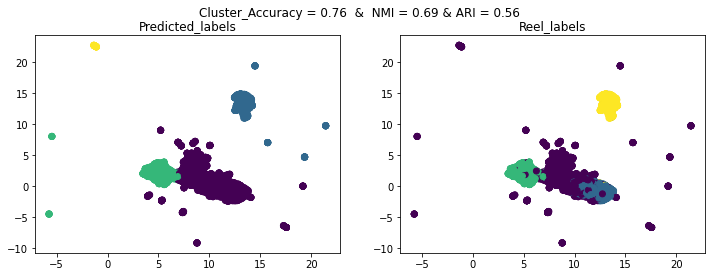

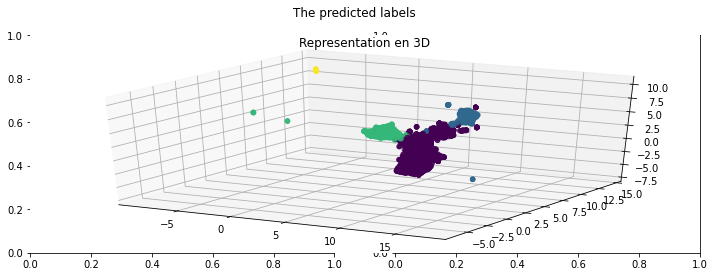

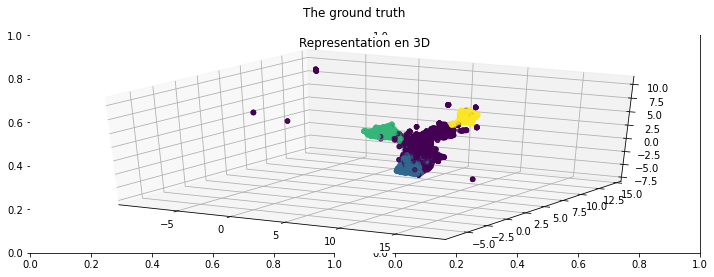

In [ ]:
# Plot 2D
eval_clustering_2D(X_reduced_u_map_2D , labels , label_num)

# Plot 3D
eval_clustering_3D(X_reduced_u_map_3D , labels, 'The predicted labels')
eval_clustering_3D(X_reduced_u_map_3D , label_num,  'The ground truth')

# Plot 3D avec plotly
# eval_clustering_3D_plotly(X_reduced_u_map_3D , labels)

### Autoencodeurs

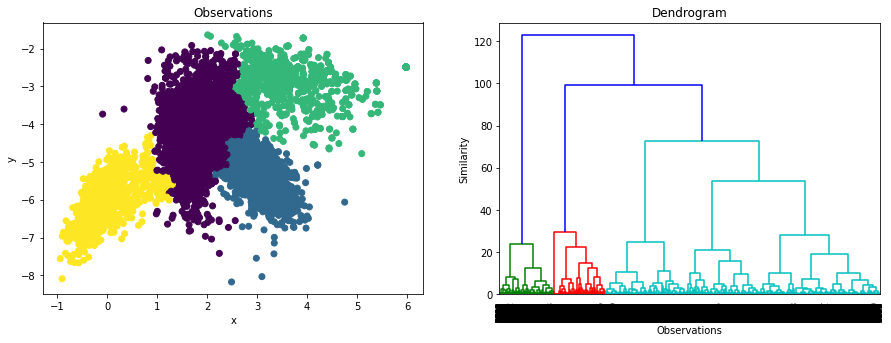

In [ ]:
model = AgglomerativeClustering(linkage=lkg, n_clusters=k)
model.fit(X_reduced_autoencodeur_2D)
labels = model.labels_

CAH_plot(X_reduced_autoencodeur_2D , labels)

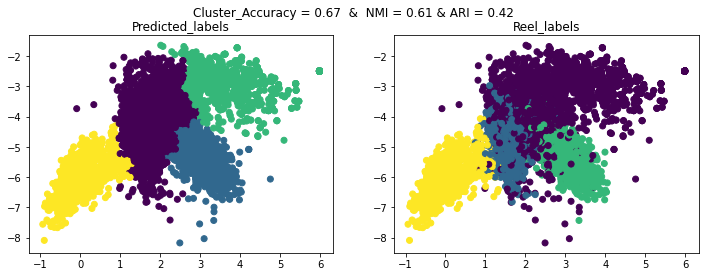

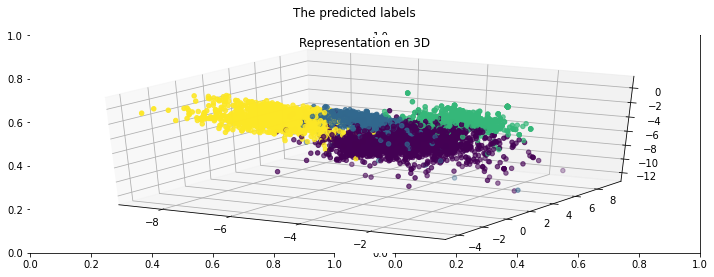

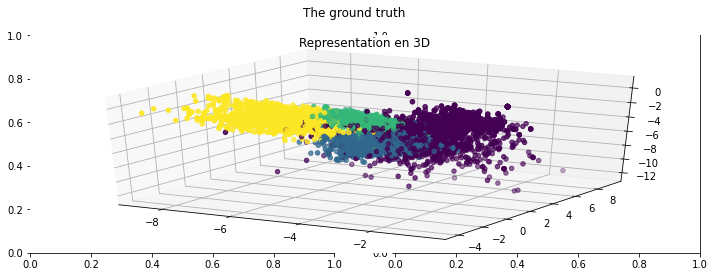

In [ ]:
# Plot 2D
eval_clustering_2D(X_reduced_autoencodeur_2D , labels , label_num)

# Plot 3D
eval_clustering_3D(X_reduced_autoencodeur_3D , labels, 'The predicted labels')
eval_clustering_3D(X_reduced_autoencodeur_3D , label_num,  'The ground truth')

# Plot 3D avec plotly
# eval_clustering_3D_plotly(X_reduced_autoencodeur_3D , labels)

## Partie 2

## Reduced k-means et Factorial k-means

### Reduced k-means

In [ ]:
rkm_2D = fcps.TandemClustering(w2v_embbbeddings,4,Type="Reduced",PlotIt=False, ndim=2, nstart=10)
rkm_3D = fcps.TandemClustering(w2v_embbbeddings,4,Type="Reduced",PlotIt=False, ndim=3, nstart=10)

R[write to console]: Registered S3 method overwritten by 'GGally':
  method from   
  +.gg   ggplot2



  |======================================================================| 100%

In [ ]:
# Reduced k-means
pred_label_rkm_2D = rkm_2D[0]
X_reduced_rkm_2D  = rkm_2D[1][0]

pred_label_rkm_3D = rkm_3D[0]
X_reduced_rkm_3D  = rkm_3D[1][0]

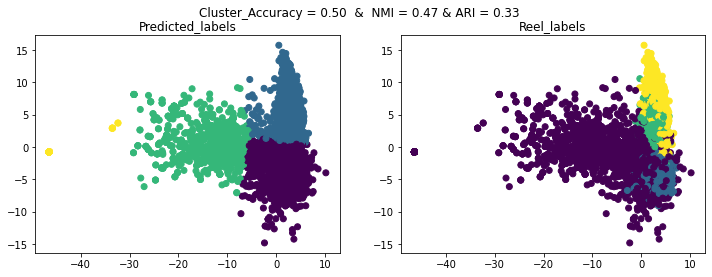

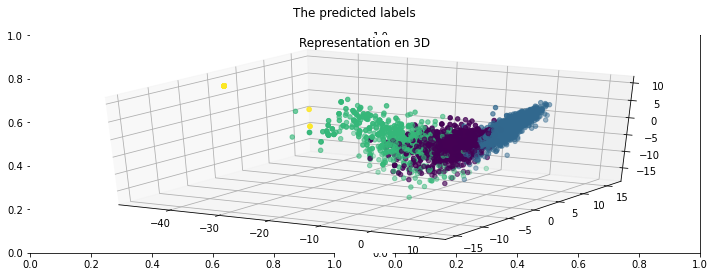

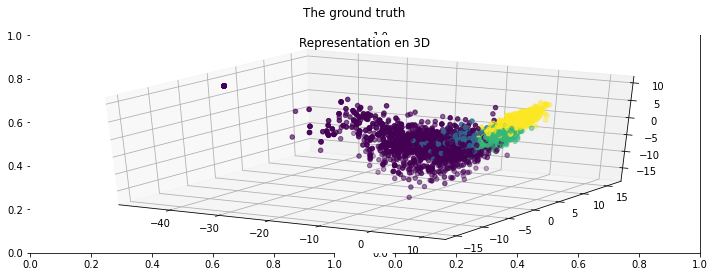

In [ ]:
# Plot 2D
eval_clustering_2D(X_reduced_rkm_2D , pred_label_rkm_2D , label_num)

# Plot 3D
eval_clustering_3D(X_reduced_rkm_3D , pred_label_rkm_3D, 'The predicted labels')
eval_clustering_3D(X_reduced_rkm_3D , label_num,  'The ground truth')

# Plot 3D avec plotly
# eval_clustering_3D_plotly(X_reduced_rkm_3D , pred_label_rkm_3D)

### Factorial k-means

In [ ]:
rkm_2D = fcps.TandemClustering(w2v_embbbeddings,4,Type="Factorial",PlotIt=False, ndim=2, nstart=10)
rkm_3D = fcps.TandemClustering(w2v_embbbeddings,4,Type="Factorial",PlotIt=False, ndim=3, nstart=10)

  |======================================================================| 100%

In [ ]:
# Factorial k-means
pred_label_rkm_2D = rkm_2D[0]
X_reduced_rkm_2D  = rkm_2D[1][0]

pred_label_rkm_3D = rkm_3D[0]
X_reduced_rkm_3D  = rkm_3D[1][0]

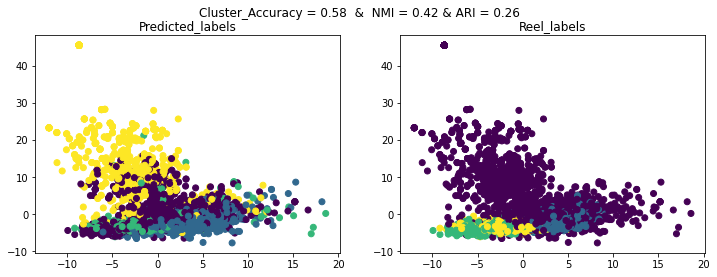

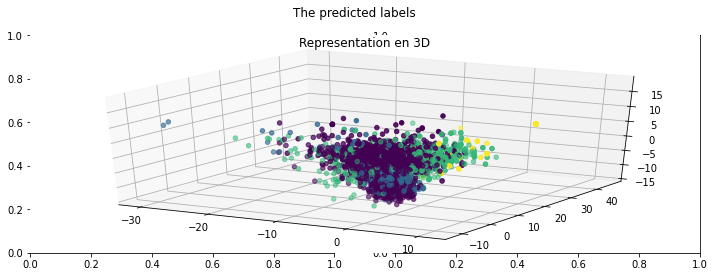

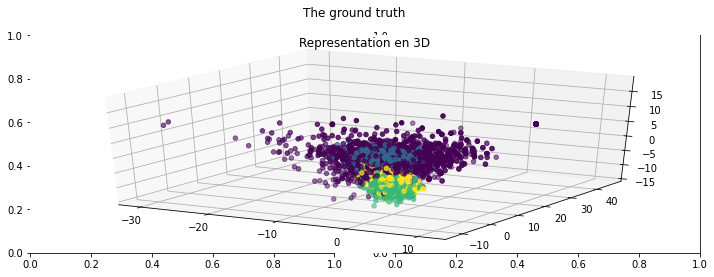

In [ ]:
# Plot 2D
eval_clustering_2D(X_reduced_rkm_2D , pred_label_rkm_2D , label_num)

# Plot 3D
eval_clustering_3D(X_reduced_rkm_3D , pred_label_rkm_3D, 'The predicted labels')
eval_clustering_3D(X_reduced_rkm_3D , label_num,  'The ground truth')

# Plot 3D avec plotly
# eval_clustering_3D_plotly(X_reduced_rkm_3D , pred_label_rkm_3D)

## Deep Clustering Network (DCN)

Voici l'implémentation de 

Deep k-means (DKM) et 

Deep Clustering Network (DCN) en tensorflow. 

Les fonctions à utiliser sont DKM() et DCN(). 

Ne pas hésiter à modifier les paramètres, que ce soit par rapport à l'architecture (nombre/taille des couches, etc.) ou aux paramètres d'apprentissage.

In [ ]:
from DKM_DCN_tf_py import DKM , DCN

In [ ]:
import tensorflow.compat.v1 as tf
tf.reset_default_graph()

In [ ]:
Deep_Clustering_Network = DCN(data = w2v_embbbeddings , n_clusters = 4, n_components = 2, n_pretrain_epochs=50, n_finetuning_epochs=50, lambda_=1.0, batch_size=256, seed=None, cpu=False)


/content/DKM_DCN_tf_py.py:21: UserWarning:

`tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.

/usr/local/lib/python3.7/dist-packages/keras/legacy_tf_layers/core.py:255: UserWarning:

`layer.apply` is deprecated and will be removed in a future version. Please use `layer.__call__` method instead.



Starting autoencoder pretraining...


100%|██████████| 50/50 [00:12<00:00,  4.10it/s]


Running k-means on the learned embeddings...
Starting DCN training...


100%|██████████| 50/50 [00:45<00:00,  1.11it/s]


In [ ]:
tf.reset_default_graph()

In [ ]:
Deep_Clustering_Network_3D = DCN(data = w2v_embbbeddings , n_clusters = 4, n_components = 3, n_pretrain_epochs=50, n_finetuning_epochs=50, lambda_=1.0, batch_size=256, seed=None, cpu=False)


/content/DKM_DCN_tf_py.py:21: UserWarning:

`tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.

/usr/local/lib/python3.7/dist-packages/keras/legacy_tf_layers/core.py:255: UserWarning:

`layer.apply` is deprecated and will be removed in a future version. Please use `layer.__call__` method instead.



Starting autoencoder pretraining...


100%|██████████| 50/50 [00:10<00:00,  4.58it/s]


Running k-means on the learned embeddings...
Starting DCN training...


100%|██████████| 50/50 [00:45<00:00,  1.10it/s]


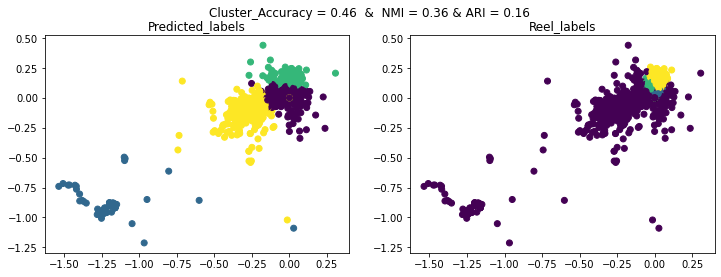

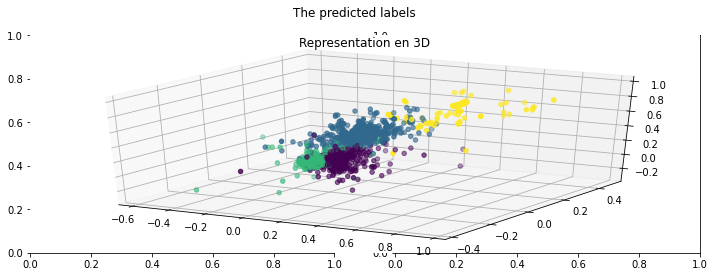

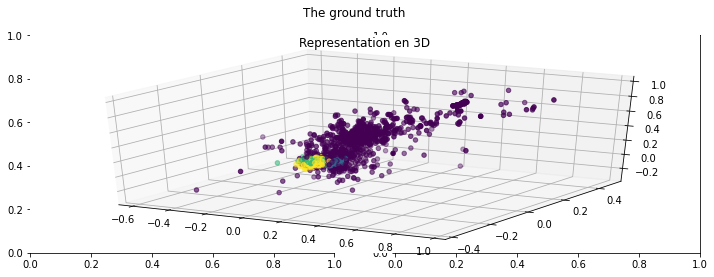

In [ ]:
# Deep Clustering Network
pred_label_DCN = Deep_Clustering_Network[1]
X_reduced_DCN  = Deep_Clustering_Network[0]

pred_label_DCN_3D = Deep_Clustering_Network_3D[1]
X_reduced_DCN_3D  = Deep_Clustering_Network_3D[0]

# Plot 2D
eval_clustering_2D(X_reduced_DCN , pred_label_DCN , label_num)

# Plot 3D
eval_clustering_3D(X_reduced_DCN_3D , pred_label_DCN_3D, 'The predicted labels')
eval_clustering_3D(X_reduced_DCN_3D , label_num,  'The ground truth')

# Plot 3D avec plotly
# eval_clustering_3D_plotly(X_reduced_DCN_3D , pred_label_DCN_3D)

## Deep k-means (DKM)

In [ ]:
tf.reset_default_graph()

In [ ]:
Deep_kmeans_2D = DKM(data = w2v_embbbeddings, n_clusters = 4, n_components = 2, n_pretrain_epochs=50, n_finetuning_epochs=5, lambda_=1.0, batch_size=256, seed=None, cpu=False)


/content/DKM_DCN_tf_py.py:21: UserWarning:

`tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.

/usr/local/lib/python3.7/dist-packages/keras/legacy_tf_layers/core.py:255: UserWarning:

`layer.apply` is deprecated and will be removed in a future version. Please use `layer.__call__` method instead.



Starting autoencoder pretraining...


100%|██████████| 50/50 [00:11<00:00,  4.47it/s]


Running k-means on the learned embeddings...
Starting DKM training...


100%|██████████| 20/20 [00:31<00:00,  1.56s/it]


In [ ]:
tf.reset_default_graph()

In [ ]:
Deep_kmeans_3D = DKM(data = w2v_embbbeddings, n_clusters = 4, n_components = 3, n_pretrain_epochs=50, n_finetuning_epochs=5, lambda_=1.0, batch_size=256, seed=None, cpu=False)


/content/DKM_DCN_tf_py.py:21: UserWarning:

`tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.

/usr/local/lib/python3.7/dist-packages/keras/legacy_tf_layers/core.py:255: UserWarning:

`layer.apply` is deprecated and will be removed in a future version. Please use `layer.__call__` method instead.



Starting autoencoder pretraining...


100%|██████████| 50/50 [00:10<00:00,  4.55it/s]


Running k-means on the learned embeddings...
Starting DKM training...


100%|██████████| 20/20 [00:30<00:00,  1.53s/it]


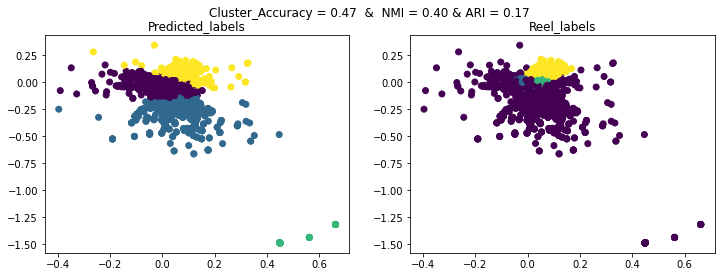

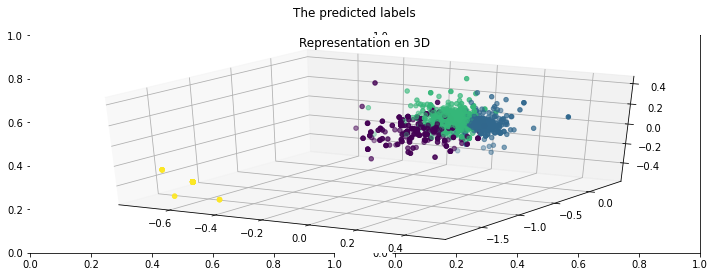

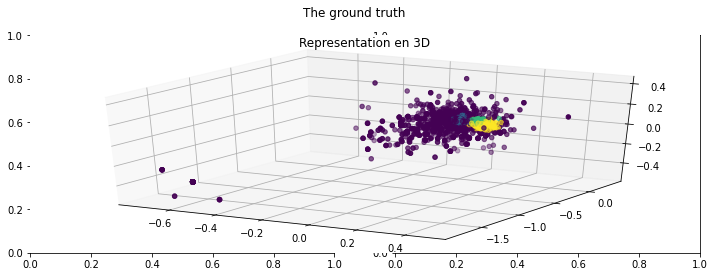

In [ ]:
# Deep k-means (DKM)
pred_label_DKM_2D = Deep_kmeans_2D[1]
X_reduced_DKM_2D  = Deep_kmeans_2D[0]

pred_label_DKM_3D = Deep_kmeans_3D[1]
X_reduced_DKM_3D  = Deep_kmeans_3D[0]

# Plot 2D
eval_clustering_2D(X_reduced_DKM_2D , pred_label_DKM_2D , label_num)

# Plot 3D
eval_clustering_3D(X_reduced_DKM_3D , pred_label_DKM_3D, 'The predicted labels')
eval_clustering_3D(X_reduced_DKM_3D , label_num,  'The ground truth')

# Plot 3D avec plotly
# eval_clustering_3D_plotly(X_reduced_DKM_3D , pred_label_DKM_3D)

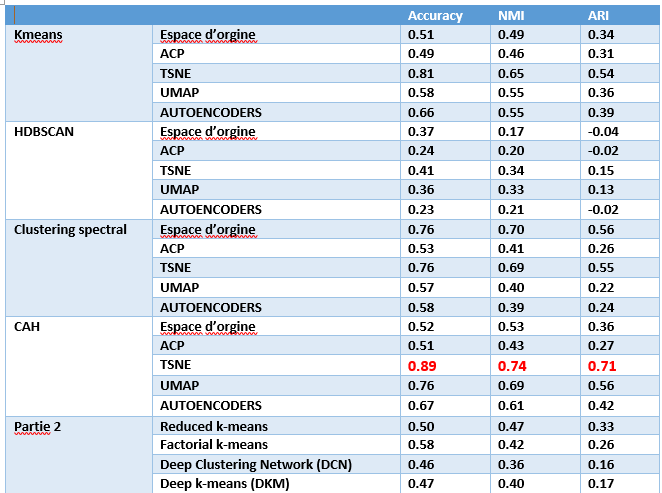

**Interprétation classic4 et w2v :**

D’après les résultats on Remarque que HDBSCAN par rapport aux autres méthodes donne des mauvais résultats.

Nous constatons que les méthodes de clustering (kmeans et Spectral clustering) ont donné des meilleurs résultats comparés aux autres et plus précisément après l’application des méthodes de réduction de dimensionnalité, aussi on remarque que la méthode CAH après l’application de T-SNE a un bon score d’accuracy par rapport à tous les méthodes de réduction de dimensionnalité avec un score de 0.89, et de même pour UMAP avec un score de 0.80, en conclusion, l’algorithme du CAH a donné des bons résultat en terme d’accuracy, NMI et ARI après application de la méthode de réduction de dimensionnalité T-SNE.


**Conlusion**

D’après les résultats trouvés on remarque que la méthode de Word2vec et mieux que GloVe et que la méthode T-SNE donne des meilleures résultats par rapport aux autres méthodes de réduction de dimensionnalité et que les algorithmes de clustering CAH, Kmeans  et Clustering spectral sont les meilleurs après l’utilisation de T-sne et UMAP.

# **Bert**

In [ ]:
!pip install transformers

In [ ]:
def collate_fn(batch_sentences, tokenizer):
    tokenized = tokenizer(batch_sentences, padding=True, truncation=True, max_length=512)
    inds = tokenized['input_ids']
    mask = tokenized['attention_mask']

    inds = torch.tensor(inds)
    mask = torch.tensor(mask)

    return inds, mask

def encode_sentences_batch(model, tokenizer, sentences, batch_size=32):
    n_layers = model.config.num_hidden_layers
    tokenized_sentences = [tokenizer.tokenize(sent)[:512] for sent in sentences]
    
    # sort by length
    argsort = np.argsort([len(i) for i in tokenized_sentences])
    sorted_inds = np.argsort(argsort)

    sentences = [sentences[i] for i in argsort]

    # sentences_dataset = BertDataset(sentences)
    data_loader = DataLoader(dataset=sentences,
                                batch_size=batch_size,
                                shuffle=False,
                                num_workers=4,
                                collate_fn=lambda x: collate_fn(x, tokenizer)
                                )

    embeddings = {k:[] for k in range(n_layers)}

    for _, batch in enumerate(data_loader):
        with torch.no_grad():
            x, mask = batch
            x = x.to(device)

            output = model(x)
            hidden_states = output.hidden_states
            hidden_states = list(hidden_states[1:])

            for ind_layer, layer_embeddings in enumerate(hidden_states):
                # remove padding's zeros
                layer_embeddings = layer_embeddings.cpu() * mask[:, :, None]
                # compute average over tokens
                layer_hidden_state = layer_embeddings.mean(axis=1)

                embeddings[ind_layer].append(layer_hidden_state)

    # put the batches together and sort the documents
    embeddings = [torch.vstack(embeddings[layer_ind])[sorted_inds].numpy() for layer_ind in range(n_layers)]
    
    return embeddings

In [ ]:
def compute_concat_embeddings(matrices):
  return np.hstack(matrices)

def compute_average_embeddings(matrices):
  matrices = np.swapaxes(matrices,0,1)
  word_vectors = [matrix.mean(axis=0) for matrix in matrices]
  avg_matrix = np.vstack(word_vectors)
  return avg_matrix

In [ ]:
from transformers import BertModel, BertTokenizer, RobertaModel, RobertaTokenizer
from torch.utils.data import DataLoader
import torch


if torch.cuda.is_available():
  device = 'cuda'
else:
  device = 'cpu' 

In [ ]:
model_name  = 'bert-base-cased'
model = BertModel.from_pretrained(model_name,output_hidden_states=True)
tokenizer = BertTokenizer.from_pretrained(model_name)

if device == "cuda":
  model.cuda()

bert_embeddings = encode_sentences_batch(model,tokenizer,texts_cleaned,batch_size=32)

Some weights of the model checkpoint at bert-base-cased were not used when initializing BertModel: ['cls.seq_relationship.weight', 'cls.predictions.transform.LayerNorm.bias', 'cls.seq_relationship.bias', 'cls.predictions.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.decoder.weight', 'cls.predictions.transform.dense.bias', 'cls.predictions.transform.dense.weight']
- This IS expected if you are initializing BertModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing BertModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning:

This DataLoader will create 4 worker processes in total. Our suggest

In [ ]:
avg_bert = compute_average_embeddings(bert_embeddings)

In [ ]:
print(avg_bert.shape)
avg_bert.shape

(7095, 768)


(7095, 768)

## **K-means**

## Appliquer sur l’espace d’origine

In [ ]:
pred_label_KMeans = KMeans(k, random_state=42).fit(avg_bert).labels_

R[write to console]: Loading required namespace: pracma



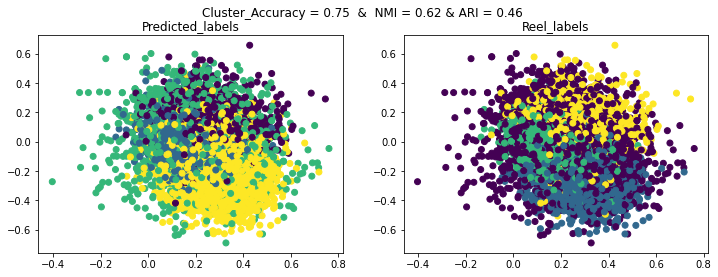

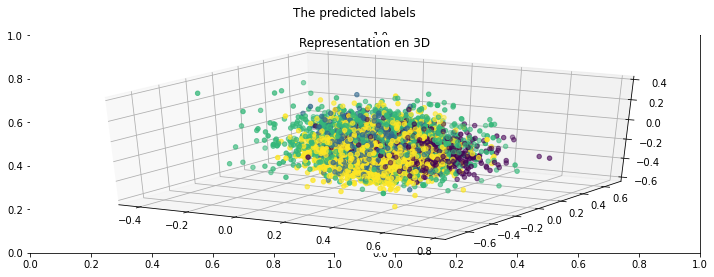

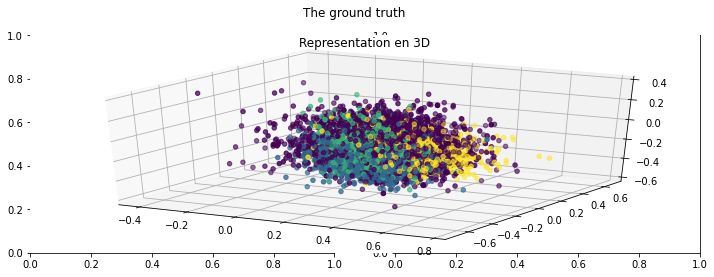

In [ ]:
# Plot 2D
eval_clustering_2D(avg_bert , pred_label_KMeans , label_num)

# Plot 3D
eval_clustering_3D(avg_bert , pred_label_KMeans, 'The predicted labels')
eval_clustering_3D(avg_bert , label_num ,  'The ground truth')

### **Pca**

In [ ]:
# ACP
X_reduced_pca_2D = PCA(n_components=2, whiten=True, random_state=42).fit_transform(avg_bert)
X_reduced_pca_3D = PCA(n_components=3, whiten=True, random_state=42).fit_transform(avg_bert)

In [ ]:
# Kmeans
pred_label_PCA = KMeans(k, random_state=42).fit(X_reduced_pca_2D).labels_
pred_label_PCA_3 = KMeans(k, random_state=42).fit(X_reduced_pca_3D).labels_

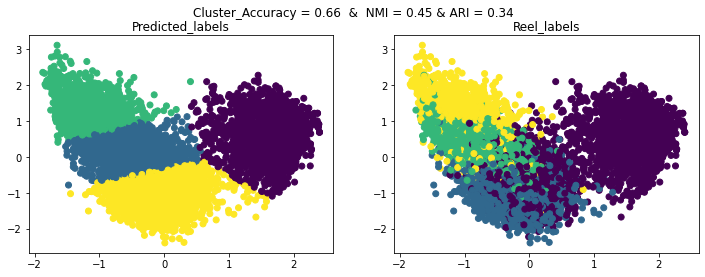

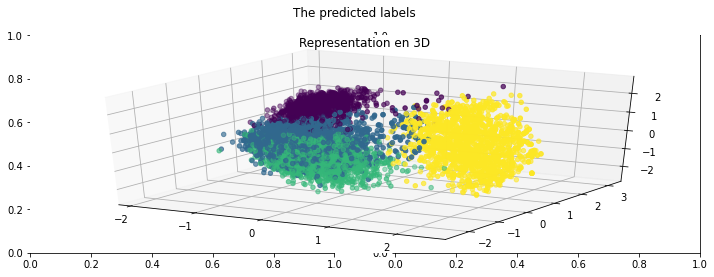

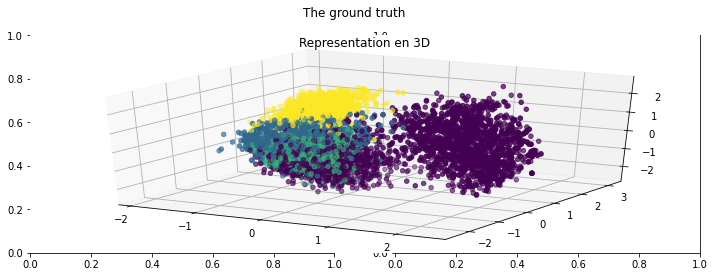

In [ ]:
# Plot 2D
eval_clustering_2D(X_reduced_pca_2D,pred_label_PCA,label_num)

# Plot 3D
eval_clustering_3D(X_reduced_pca_3D,pred_label_PCA_3 , 'The predicted labels')
eval_clustering_3D(X_reduced_pca_3D,label_num ,  'The ground truth' )

### **Tsne**

In [ ]:
# TSNE
X_reduced_tsne_2D = TSNE(n_components=2, random_state=42).fit_transform(avg_bert)
X_reduced_tsne_3D = TSNE(n_components=3, random_state=42).fit_transform(avg_bert)

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:783: FutureWarning:

The default initialization in TSNE will change from 'random' to 'pca' in 1.2.

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning:

The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:783: FutureWarning:

The default initialization in TSNE will change from 'random' to 'pca' in 1.2.

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning:

The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.



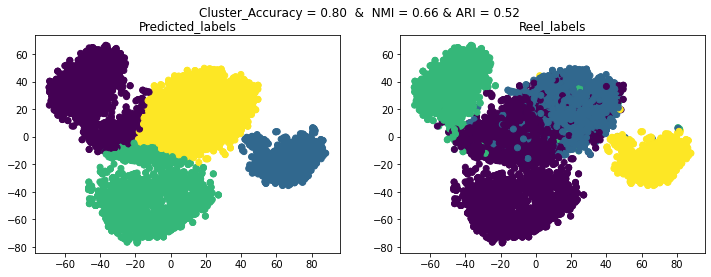

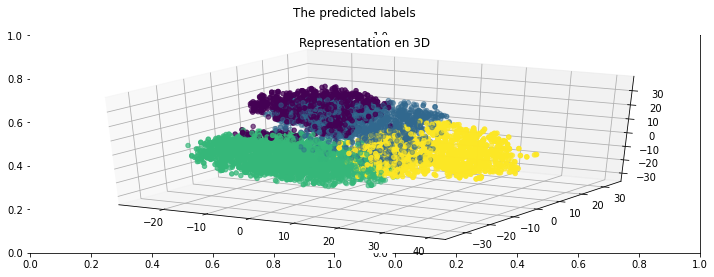

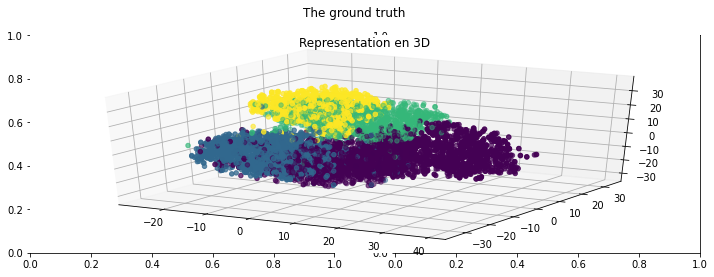

In [ ]:
# Kmeans
pred_label_KMeans = KMeans(k, random_state=42).fit(X_reduced_tsne_2D).labels_
pred_label_KMeans_3D = KMeans(k, random_state=42).fit(X_reduced_tsne_3D).labels_

# Plot 2D
eval_clustering_2D(X_reduced_tsne_2D , pred_label_KMeans , label_num)

# Plot 3D
eval_clustering_3D(X_reduced_tsne_3D , pred_label_KMeans_3D, 'The predicted labels')
eval_clustering_3D(X_reduced_tsne_3D , label_num,  'The ground truth')

### **Umap**

In [ ]:
X_reduced_u_map_2D = UMAP(n_components=2, random_state=42).fit_transform(avg_bert)
X_reduced_u_map_3D = UMAP(n_components=3, random_state=42).fit_transform(avg_bert)

/usr/local/lib/python3.7/dist-packages/numba/np/ufunc/parallel.py:363: NumbaWarning:

The TBB threading layer requires TBB version 2019.5 or later i.e., TBB_INTERFACE_VERSION >= 11005. Found TBB_INTERFACE_VERSION = 9107. The TBB threading layer is disabled.



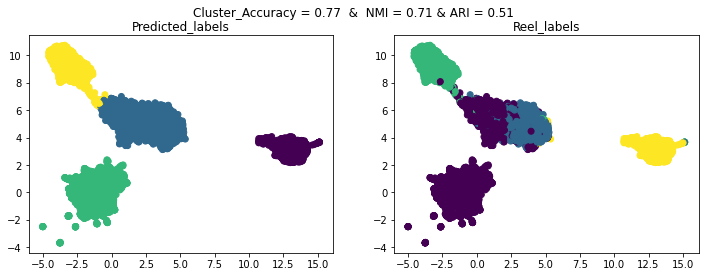

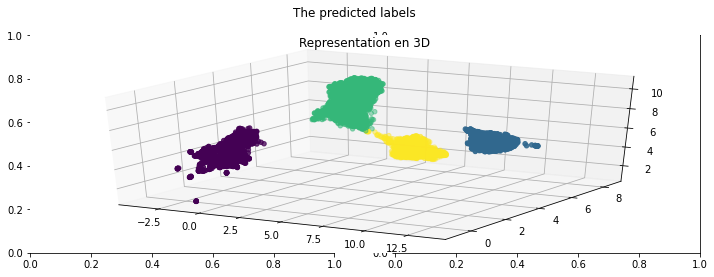

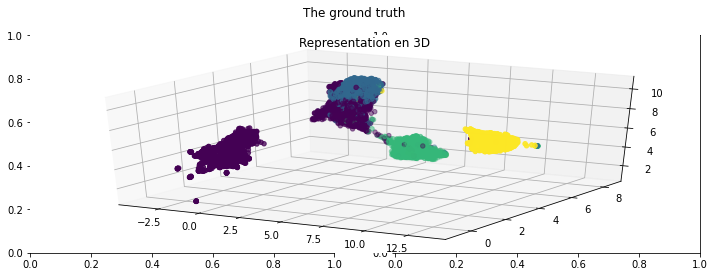

In [ ]:

# KMeans
pred_label_KMeans = KMeans(k, random_state=42).fit(X_reduced_u_map_2D).labels_
pred_label_KMeans_3D = KMeans(k, random_state=42).fit(X_reduced_u_map_3D).labels_

# Plot 2D
eval_clustering_2D(X_reduced_u_map_2D , pred_label_KMeans , label_num)

# Plot 3D
eval_clustering_3D(X_reduced_u_map_3D , pred_label_KMeans_3D, 'The predicted labels')
eval_clustering_3D(X_reduced_u_map_3D , label_num,  'The ground truth')

# Plot 3D avec plotly
# eval_clustering_3D_plotly(X_reduced_u_map_3D , pred_label_KMeans_3D)

### **Autoencodeurs**

In [ ]:
class AutoEncoder(torch.nn.Module):
    def __init__(self, input_dim, embedding_dim):
        super().__init__()
        self.input_dim = input_dim
        self.embedding_dim = embedding_dim

        self.encoder = torch.nn.Sequential(
            torch.nn.Linear(self.input_dim, 128),
            torch.nn.ReLU(),
            torch.nn.Linear(128, self.embedding_dim)
        )
        
        self.decoder = torch.nn.Sequential(
            torch.nn.Linear(self.embedding_dim, 128),
            torch.nn.ReLU(),
            torch.nn.Linear(128, self.input_dim),
            torch.nn.Sigmoid()
        )

    def forward(self, x):
        encoded = self.encoder(x)
        decoded = self.decoder(encoded)
        return decoded

def autoencoder(X, embedding_dim, n_epochs=50, batch_size=64, learning_rate=1e-3, weight_decay=1e-8, seed=None, return_model=False):
    if torch.cuda.is_available():
        device = 'cuda'
    else:
        device = 'cpu'

    if seed is not None:
      torch.manual_seed(seed)

    dataloader = DataLoader(dataset=X, batch_size=batch_size, shuffle=True)

    model = AutoEncoder(input_dim=X.shape[1], embedding_dim=embedding_dim)

    if device == 'cuda':
      model.cuda()

    loss_function = torch.nn.MSELoss()

    optimizer = torch.optim.Adam(model.parameters(),
                                lr=learning_rate,
                                weight_decay=weight_decay)

    losses = []

    model.train()
    for epoch in tqdm(range(n_epochs)):
        for batch in dataloader:
          batch = batch.to(device)
          reconstructed = model(batch)
          
          loss = loss_function(reconstructed, batch)
          
          optimizer.zero_grad()
          loss.backward()
          optimizer.step()
          
          losses.append(loss)

    model.eval()
    tensor_X = torch.tensor(X)
    tensor_X = tensor_X.to(device)
    encoded_X = model.encoder(tensor_X)
    encoded_X = encoded_X.detach().cpu().numpy()

    if return_model:
      return encoded_X, model, losses
    else:
      return encoded_X


In [ ]:
# AutoEncoder
X_reduced_autoencodeur_2D = autoencoder(avg_bert.astype("float32"),2, seed=42)
X_reduced_autoencodeur_3D = autoencoder(avg_bert.astype("float32"),3, seed=42)

100%|██████████| 50/50 [00:16<00:00,  3.06it/s]


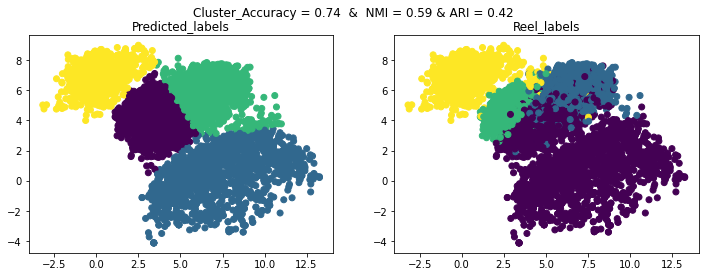

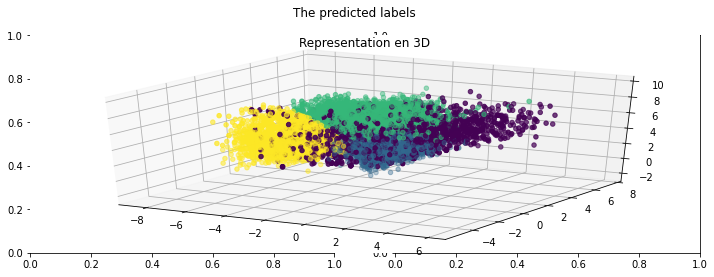

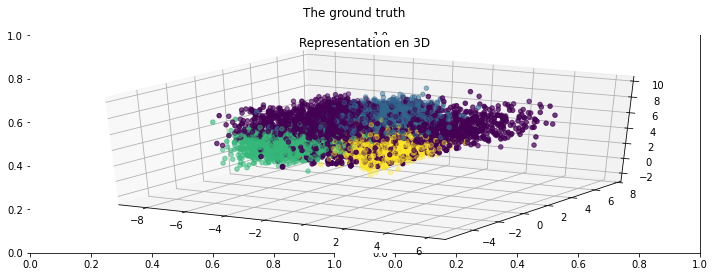

In [ ]:
# KMeans
pred_label_KMeans = KMeans(k, random_state=42).fit(X_reduced_autoencodeur_2D).labels_
pred_label_KMeans_3D = KMeans(k, random_state=42).fit(X_reduced_autoencodeur_3D).labels_

# Plot 2D
eval_clustering_2D(X_reduced_autoencodeur_2D , pred_label_KMeans , label_num)

# Plot 3D
eval_clustering_3D(X_reduced_autoencodeur_3D , pred_label_KMeans_3D, 'The predicted labels')
eval_clustering_3D(X_reduced_autoencodeur_3D , label_num,  'The ground truth')

# Plot 3D avec plotly
# eval_clustering_3D_plotly(X_reduced_autoencodeur_3D , pred_label_KMeans_3D)

## **HDBSCAN**

## Appliquer sur l'espace d'origine

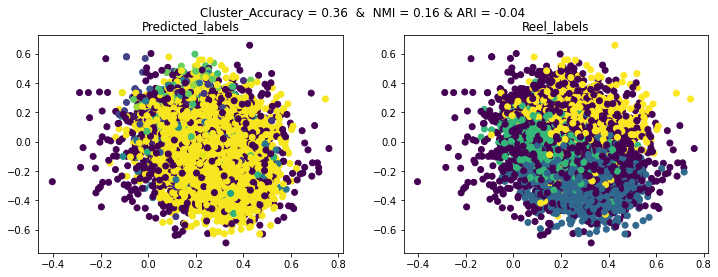

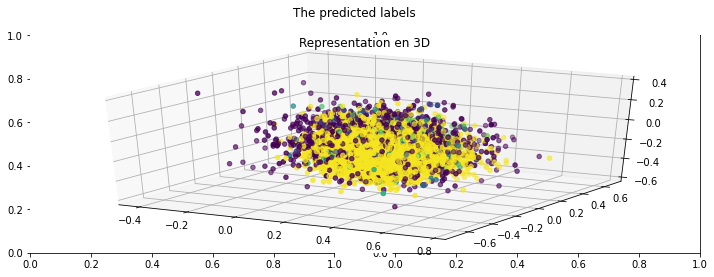

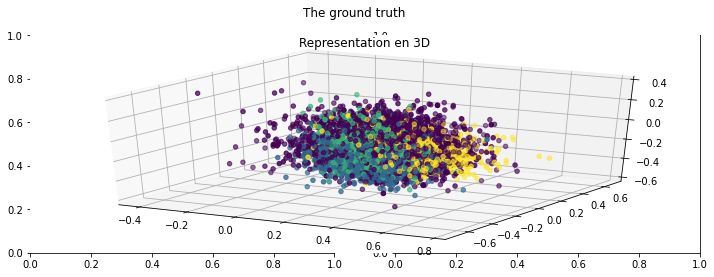

In [ ]:
# hdbscan model
hdbscan_model = hdbscan.HDBSCAN(min_cluster_size=4,algorithm="best",alpha=1.0,leaf_size=40,cluster_selection_method='eom',metric='euclidean').fit(avg_bert)
pred_label_hdbscan = hdbscan_model.labels_

# Plot 2D
eval_clustering_2D(avg_bert , pred_label_hdbscan , label_num)

# Plot 3D
eval_clustering_3D(avg_bert , pred_label_hdbscan, 'The predicted labels')
eval_clustering_3D(avg_bert , label_num ,  'The ground truth')

### **ACP**

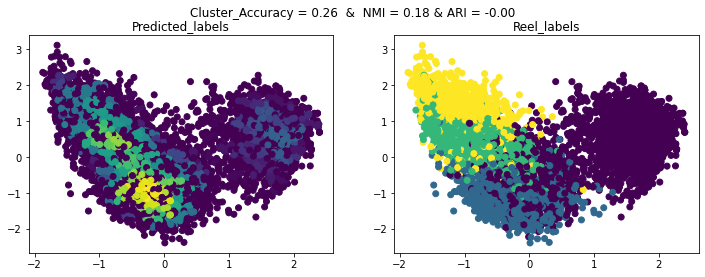

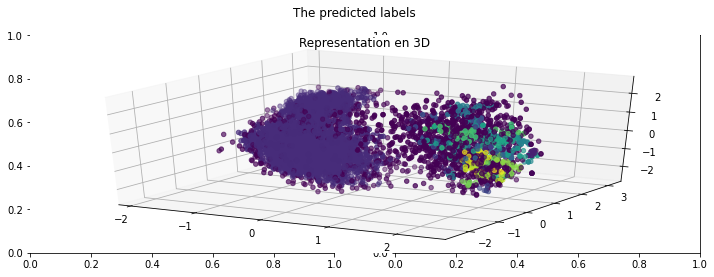

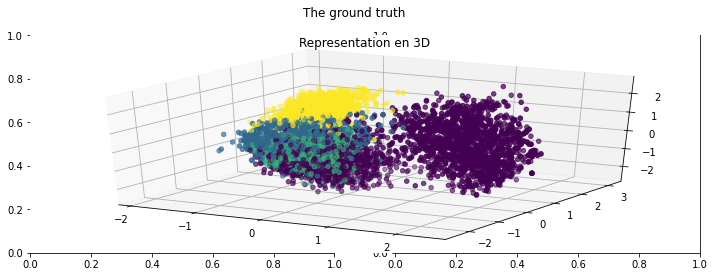

In [ ]:
# HDBSCAN
hdbscan_model = hdbscan.HDBSCAN(min_cluster_size=4,algorithm="best",alpha=1.0,leaf_size=40,cluster_selection_method='eom',metric='euclidean').fit(X_reduced_pca_2D)
pred_label_hdbscan = hdbscan_model.labels_
hdbscan_model_3D = hdbscan.HDBSCAN(min_cluster_size=4,algorithm="best",alpha=1.0,leaf_size=40,cluster_selection_method='eom',metric='euclidean').fit(X_reduced_pca_3D)
pred_label_hdbscan_3D = hdbscan_model_3D.labels_

# Plot 2D
eval_clustering_2D(X_reduced_pca_2D , pred_label_hdbscan , label_num)

# Plot 3D
eval_clustering_3D(X_reduced_pca_3D , pred_label_hdbscan_3D, 'The predicted labels')
eval_clustering_3D(X_reduced_pca_3D , label_num,  'The ground truth')

### **TSNE**

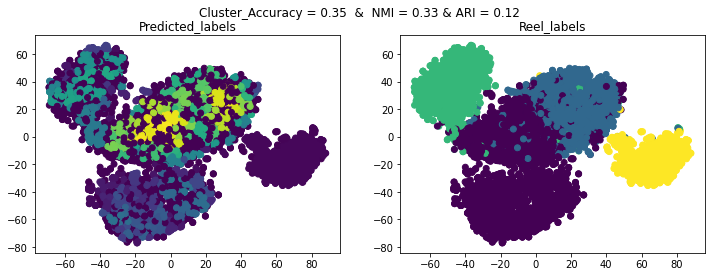

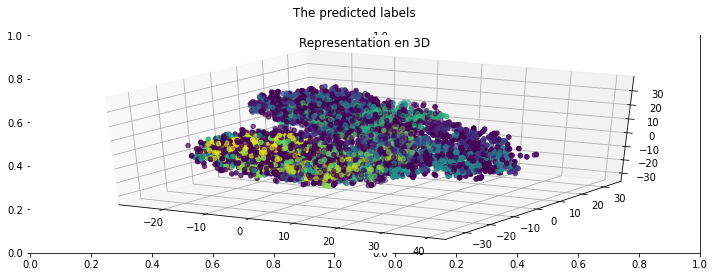

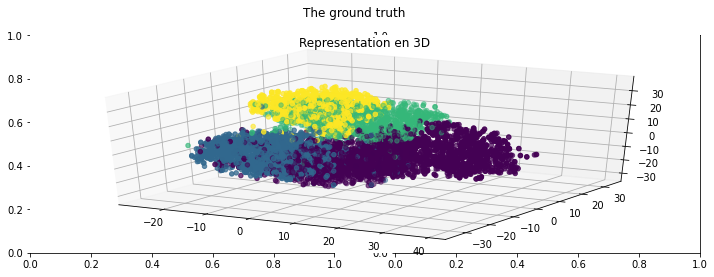

In [ ]:
# HDBSCAN
hdbscan_model = hdbscan.HDBSCAN(min_cluster_size=4,algorithm="best",alpha=1.0,leaf_size=40,cluster_selection_method='eom',metric='euclidean').fit(X_reduced_tsne_2D)
pred_label_hdbscan = hdbscan_model.labels_
hdbscan_model_3D = hdbscan.HDBSCAN(min_cluster_size=4,algorithm="best",alpha=1.0,leaf_size=40,cluster_selection_method='eom',metric='euclidean').fit(X_reduced_tsne_3D)
pred_label_hdbscan_3D = hdbscan_model_3D.labels_

# Plot 2D
eval_clustering_2D(X_reduced_tsne_2D , pred_label_hdbscan , label_num)

# Plot 3D
eval_clustering_3D(X_reduced_tsne_3D , pred_label_hdbscan_3D, 'The predicted labels')
eval_clustering_3D(X_reduced_tsne_3D , label_num,  'The ground truth')

# Plot 3D avec plotly
# eval_clustering_3D_plotly(X_reduced_tsne_3D , pred_label_hdbscan_3D)

### **UMAP**

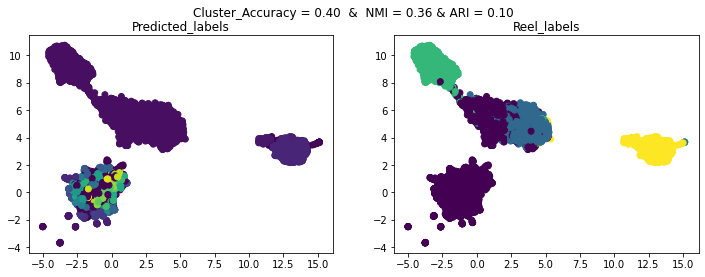

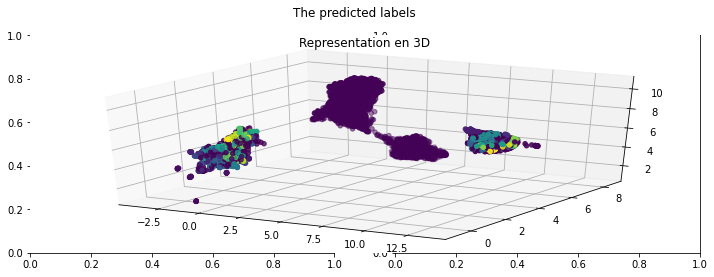

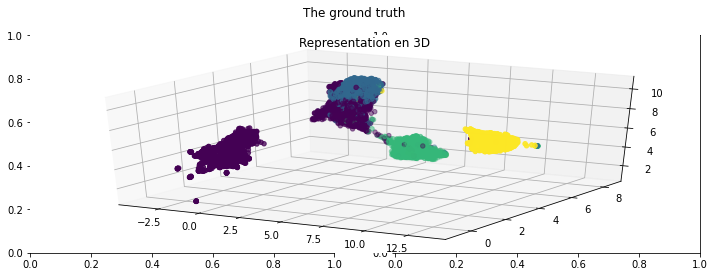

In [ ]:
# HDBSCAN
hdbscan_model = hdbscan.HDBSCAN(min_cluster_size=4,algorithm="best",alpha=1.0,leaf_size=40,cluster_selection_method='eom',metric='euclidean').fit(X_reduced_u_map_2D)
pred_label_hdbscan = hdbscan_model.labels_
hdbscan_model_3D = hdbscan.HDBSCAN(min_cluster_size=4,algorithm="best",alpha=1.0,leaf_size=40,cluster_selection_method='eom',metric='euclidean').fit(X_reduced_u_map_3D)
pred_label_hdbscan_3D = hdbscan_model_3D.labels_

# Plot 2D
eval_clustering_2D(X_reduced_u_map_2D , pred_label_hdbscan , label_num)

# Plot 3D
eval_clustering_3D(X_reduced_u_map_3D , pred_label_hdbscan_3D, 'The predicted labels')
eval_clustering_3D(X_reduced_u_map_3D , label_num,  'The ground truth')

# Plot 3D avec plotly
# eval_clustering_3D_plotly(X_reduced_u_map_3D , pred_label_hdbscan_3D)

### **Autoencodeurs**

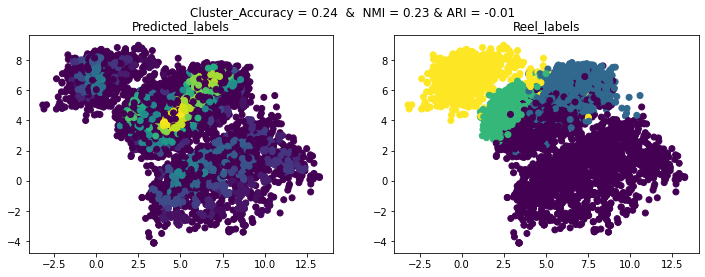

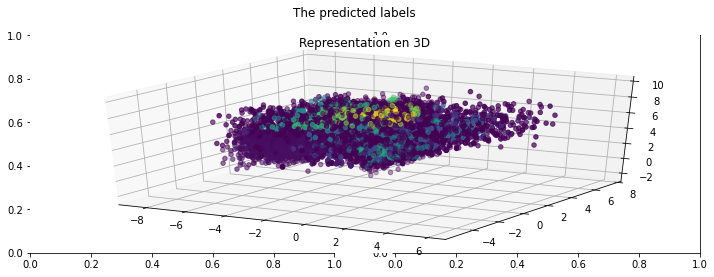

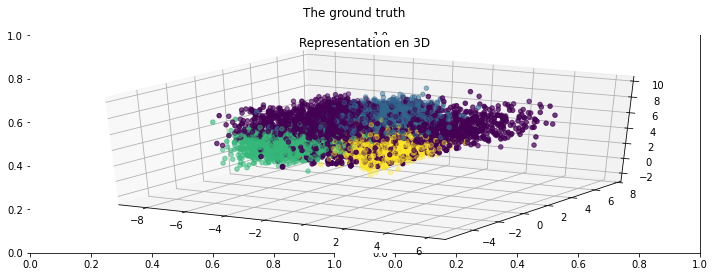

In [ ]:
# HDBSCAN
hdbscan_model = hdbscan.HDBSCAN(min_cluster_size=4,algorithm="best",alpha=1.0,leaf_size=40,cluster_selection_method='eom',metric='euclidean').fit(X_reduced_autoencodeur_2D)
pred_label_hdbscan = hdbscan_model.labels_
hdbscan_model_3D = hdbscan.HDBSCAN(min_cluster_size=4,algorithm="best",alpha=1.0,leaf_size=40,cluster_selection_method='eom',metric='euclidean').fit(X_reduced_autoencodeur_3D)
pred_label_hdbscan_3D = hdbscan_model_3D.labels_

# Plot 2D
eval_clustering_2D(X_reduced_autoencodeur_2D , pred_label_hdbscan , label_num)

# Plot 3D
eval_clustering_3D(X_reduced_autoencodeur_3D , pred_label_hdbscan_3D, 'The predicted labels')
eval_clustering_3D(X_reduced_autoencodeur_3D , label_num,  'The ground truth')

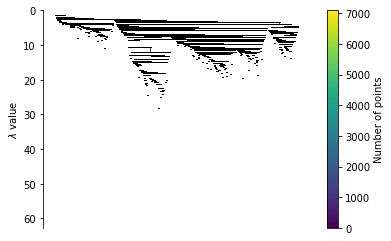

In [ ]:
hdbscan_model.condensed_tree_.plot()

## **Spectral clustering**

## Appliquer sur l'espace d'origine

In [ ]:
pred_label_spectral = SpectralClustering(k,affinity="nearest_neighbors",n_neighbors=10,random_state=42).fit(avg_bert).labels_
print(round(normalized_mutual_info_score(pred_label_spectral,label),2))

0.73


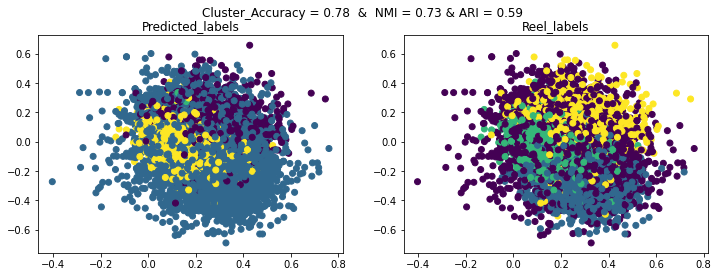

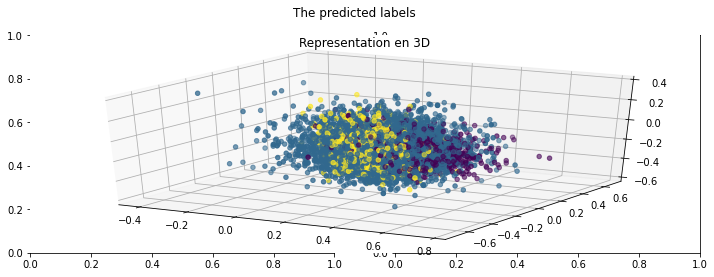

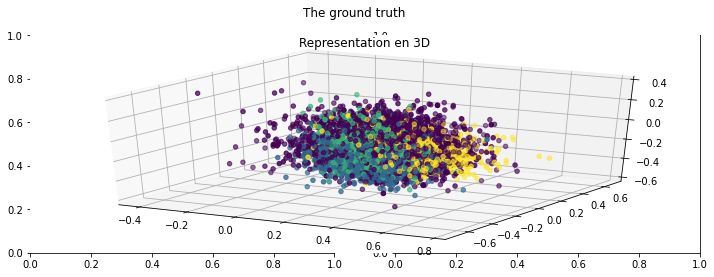

In [ ]:
# Plot 2D
eval_clustering_2D(avg_bert , pred_label_spectral , label_num)

# Plot 3D
eval_clustering_3D(avg_bert , pred_label_spectral, 'The predicted labels')
eval_clustering_3D(avg_bert , label_num ,  'The ground truth')

### **ACP**

In [ ]:
# Spectral Clustering
pred_label_spectral = SpectralClustering(k,affinity="nearest_neighbors",n_neighbors=10,random_state=42).fit(X_reduced_pca_2D).labels_
pred_label_spectral_3D = SpectralClustering(k,affinity="nearest_neighbors",n_neighbors=10,random_state=42).fit(X_reduced_pca_3D).labels_

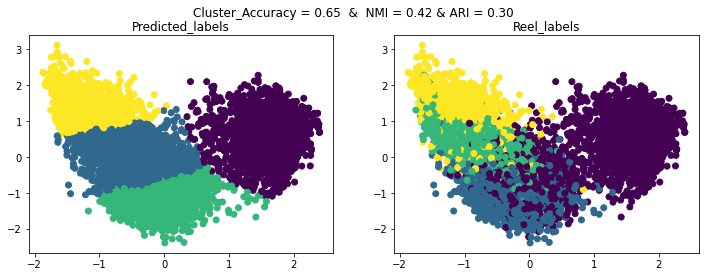

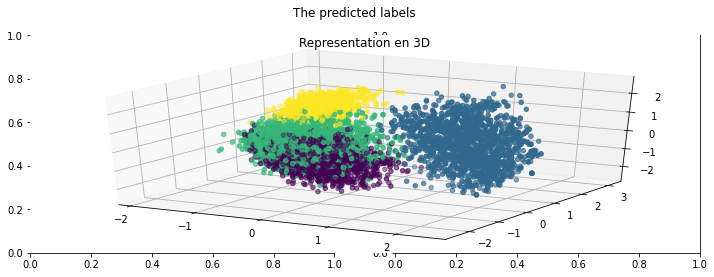

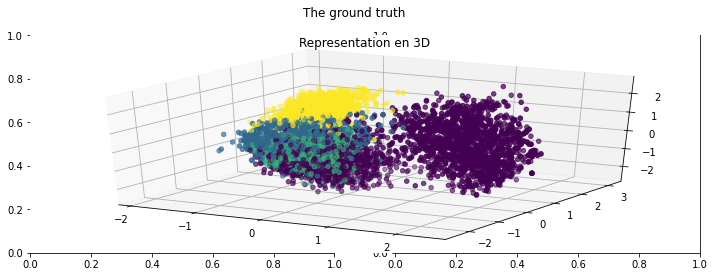

In [ ]:
# Plot 2D
eval_clustering_2D(X_reduced_pca_2D , pred_label_spectral , label_num)

# Plot 3D
eval_clustering_3D(X_reduced_pca_3D , pred_label_spectral_3D, 'The predicted labels')
eval_clustering_3D(X_reduced_pca_3D , label_num,  'The ground truth')

### **TSNE**

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_spectral_embedding.py:261: UserWarning:

Graph is not fully connected, spectral embedding may not work as expected.

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_spectral_embedding.py:261: UserWarning:

Graph is not fully connected, spectral embedding may not work as expected.



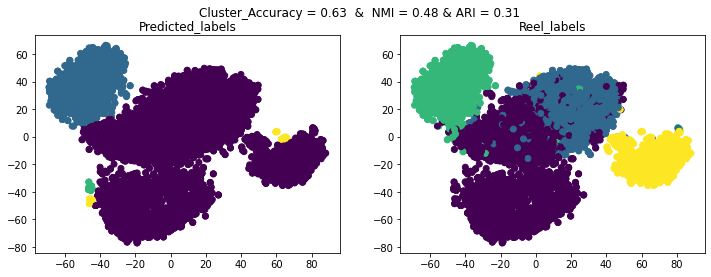

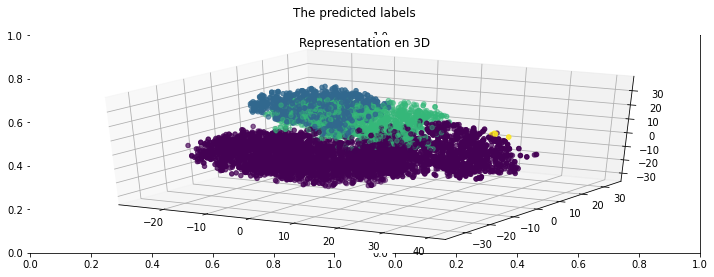

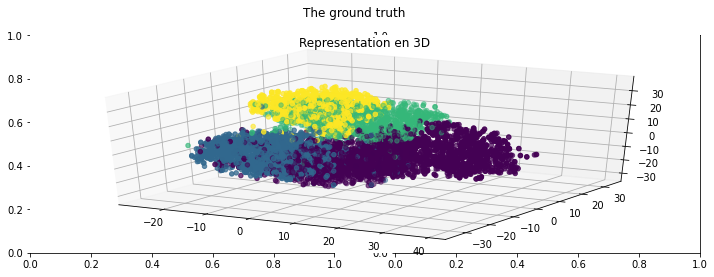

In [ ]:
# Spectral Clustering
pred_label_spectral = SpectralClustering(k,affinity="nearest_neighbors",n_neighbors=10,random_state=42).fit(X_reduced_tsne_2D).labels_
pred_label_spectral_3D = SpectralClustering(k,affinity="nearest_neighbors",n_neighbors=10,random_state=42).fit(X_reduced_tsne_3D).labels_

# Plot 2D
eval_clustering_2D(X_reduced_tsne_2D , pred_label_spectral , label_num)

# Plot 3D
eval_clustering_3D(X_reduced_tsne_3D , pred_label_spectral_3D, 'The predicted labels')
eval_clustering_3D(X_reduced_tsne_3D , label_num,  'The ground truth')

### **UMAP**

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_spectral_embedding.py:261: UserWarning:

Graph is not fully connected, spectral embedding may not work as expected.

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_spectral_embedding.py:261: UserWarning:

Graph is not fully connected, spectral embedding may not work as expected.



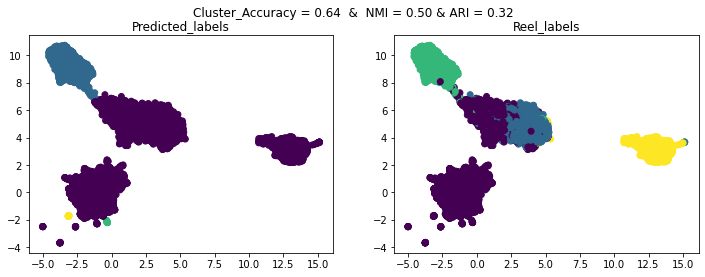

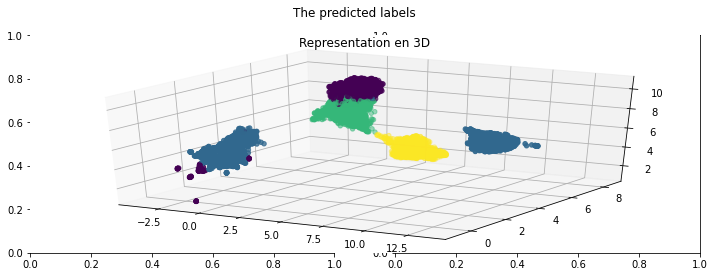

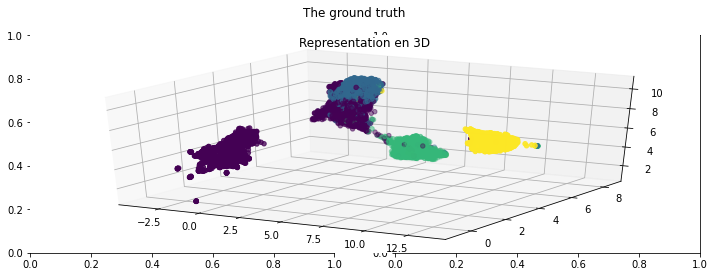

In [ ]:
# Spectral Clustering
pred_label_spectral = SpectralClustering(k,affinity="nearest_neighbors",n_neighbors=10,random_state=42).fit(X_reduced_u_map_2D).labels_
pred_label_spectral_3D = SpectralClustering(k,affinity="nearest_neighbors",n_neighbors=10,random_state=42).fit(X_reduced_u_map_3D).labels_

# Plot 2D
eval_clustering_2D(X_reduced_u_map_2D , pred_label_spectral , label_num)

# Plot 3D
eval_clustering_3D(X_reduced_u_map_3D , pred_label_spectral_3D, 'The predicted labels')
eval_clustering_3D(X_reduced_u_map_3D , label_num,  'The ground truth')

# Plot 3D avec plotly
# eval_clustering_3D_plotly(X_reduced_u_map_3D , pred_label_spectral_3D)

### **Autoencodeurs**

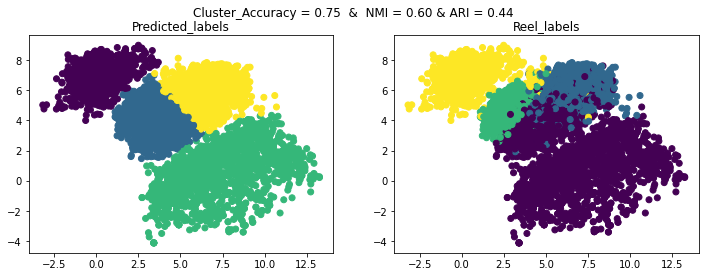

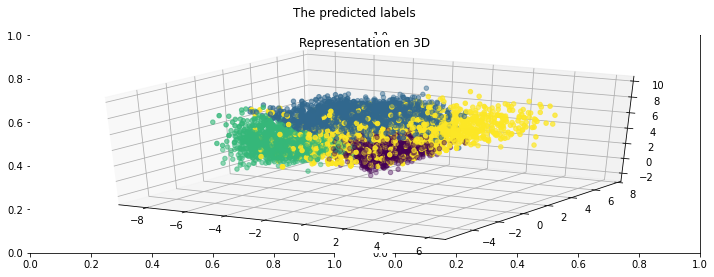

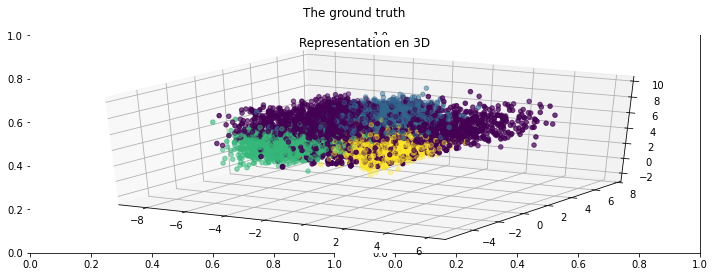

In [ ]:

# Spectral Clustering
pred_label_spectral = SpectralClustering(k,affinity="nearest_neighbors",n_neighbors=10,random_state=42).fit(X_reduced_autoencodeur_2D).labels_
pred_label_spectral_3D = SpectralClustering(k,affinity="nearest_neighbors",n_neighbors=10,random_state=42).fit(X_reduced_autoencodeur_3D).labels_

# Plot 2D
eval_clustering_2D(X_reduced_autoencodeur_2D , pred_label_spectral , label_num)

# Plot 3D
eval_clustering_3D(X_reduced_autoencodeur_3D , pred_label_spectral_3D, 'The predicted labels')
eval_clustering_3D(X_reduced_autoencodeur_3D , label_num,  'The ground truth')

# Plot 3D avec plotly
# eval_clustering_3D_plotly(X_reduced_autoencodeur_3D , pred_label_spectral_3D)

## **CAH**

In [ ]:
k = 4        # nombre de clusters
lkg = "ward" # métrique choisie dans le regroupement hiérarchique / critères d'agrégation

Appliquer sur l'espace d'origine

In [ ]:
from sklearn.cluster import AgglomerativeClustering # génération de modèles de clustering
from scipy.cluster import hierarchy  # dendrogramme

# Créer un modèle de regroupement hiérarchique
# Trouver les étiquettes
cah_model = AgglomerativeClustering(linkage=lkg, n_clusters=k)
cah_model.fit(avg_bert)
cah_pred_labels = cah_model.labels_

In [ ]:
import matplotlib.gridspec as gridspec

def CAH_plot(X , Labels , linkage=lkg):
    f_ex = plt.figure(figsize=(15,5))
    gs = gridspec.GridSpec(1,2)


    ax = f_ex.add_subplot(gs[0,0])
    ax.set_title("Observations")
    ax.set_xlabel("x")
    ax.set_ylabel("y")
    dendro =f_ex.add_subplot(gs[0,1])


    Z = hierarchy.linkage(X, linkage)
    # Sur la base de la matrice Z, créez le dendrogramme
    # recherchez scipy.cluster.hierarchy.dendrogram() pour implémenter cette tâche.
    hierarchy.dendrogram(
        Z,
        leaf_rotation=90.,  # rotates the x axis labels
        leaf_font_size=8.,  # font size for the x axis labels
    )


    dendro.set_title("Dendrogram")
    dendro.set_xlabel("Observations")
    dendro.set_ylabel("Similarity")

    ax.scatter(X[:,0],X[:,1], c=Labels, cmap='viridis')

    # boucle pour ajouter un exemple d'index en tant qu'étiquette
    # n, _ = X.shape
    # for i in range(n):
    #     ax.annotate("  " + str(i), (X[i,0],X[i,1]) )

    plt.show()

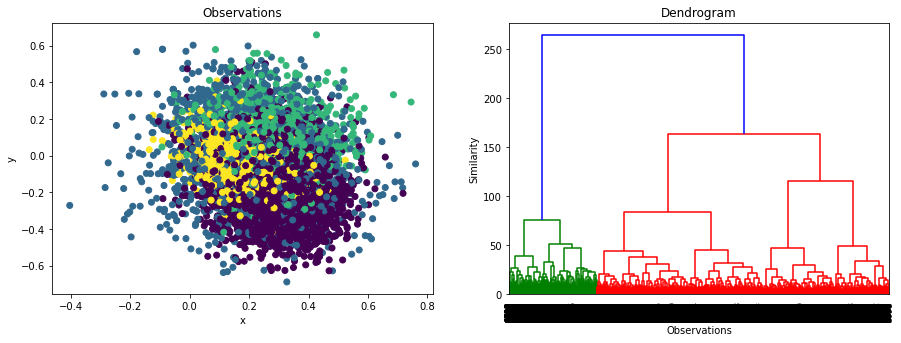

In [ ]:
CAH_plot(avg_bert , cah_pred_labels)

### **ACP**

In [ ]:
cah_model = AgglomerativeClustering(linkage=lkg, n_clusters=k)
cah_model.fit(X_reduced_pca_2D)
cah_pred_labels = cah_model.labels_

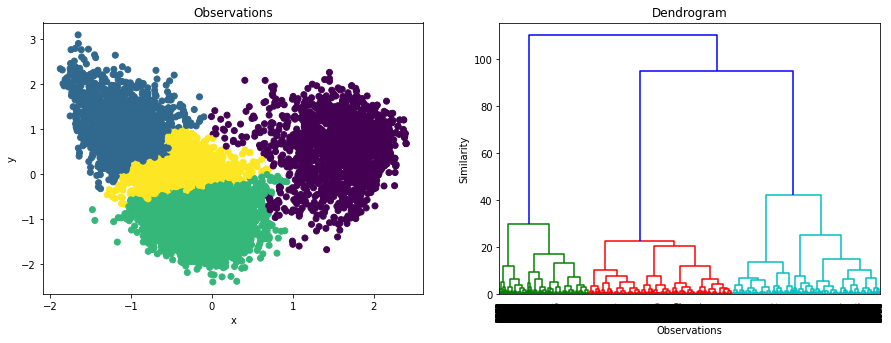

In [ ]:
CAH_plot(X_reduced_pca_2D , cah_pred_labels)

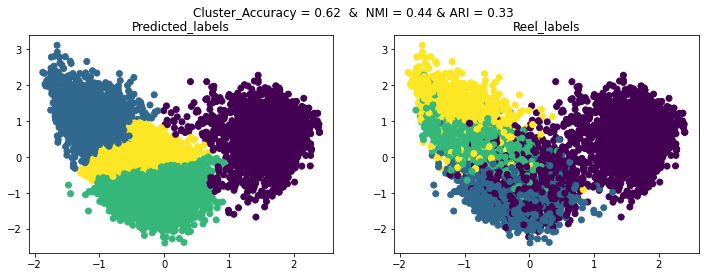

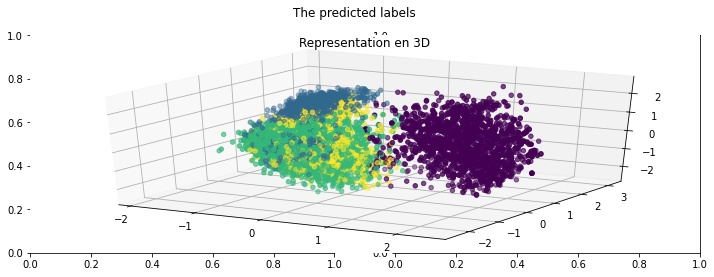

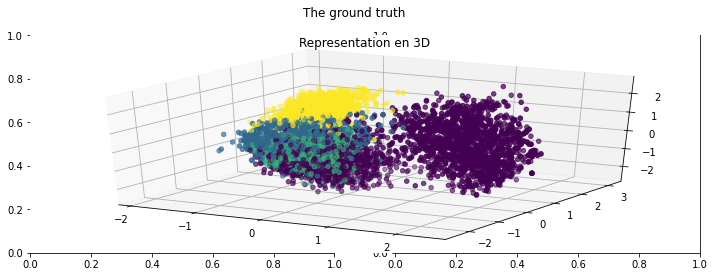

In [ ]:
# Plot 2D
eval_clustering_2D(X_reduced_pca_2D , cah_pred_labels , label_num)

# Plot 3D
eval_clustering_3D(X_reduced_pca_3D , cah_pred_labels, 'The predicted labels')
eval_clustering_3D(X_reduced_pca_3D , label_num,  'The ground truth')

### **TSNE**

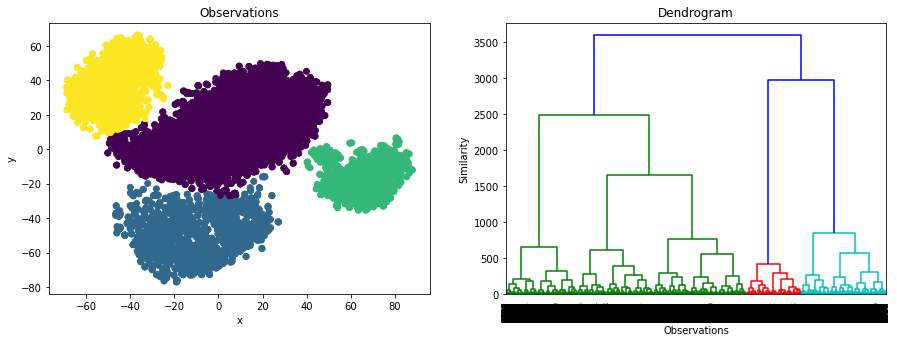

In [ ]:
model = AgglomerativeClustering(linkage=lkg, n_clusters=k)
model.fit(X_reduced_tsne_2D)
labels = model.labels_

CAH_plot(X_reduced_tsne_2D , labels)

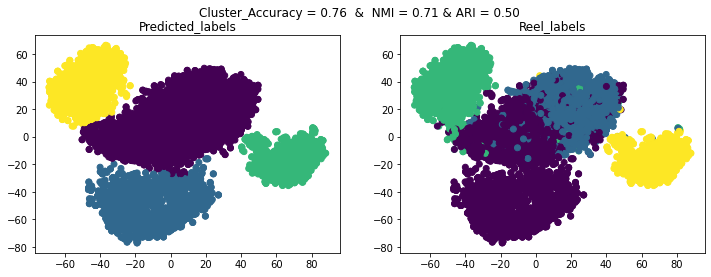

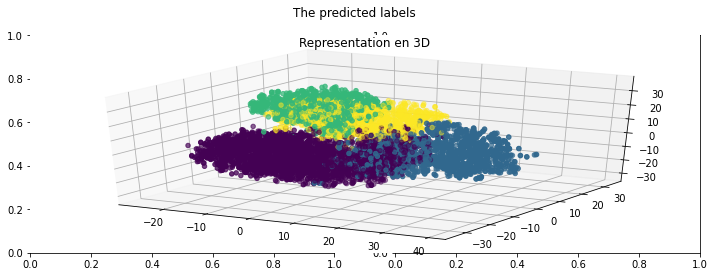

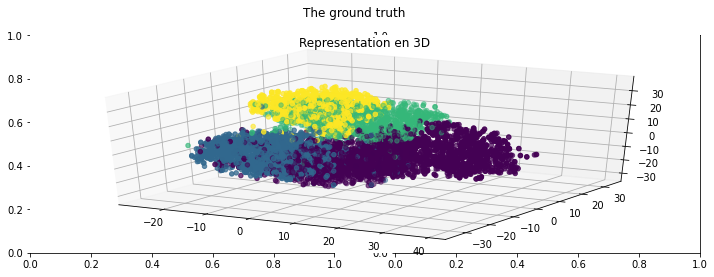

In [ ]:
# Plot 2D
eval_clustering_2D(X_reduced_tsne_2D , labels , label_num)

# Plot 3D
eval_clustering_3D(X_reduced_tsne_3D , labels, 'The predicted labels')
eval_clustering_3D(X_reduced_tsne_3D , label_num,  'The ground truth')

### **UMAP**

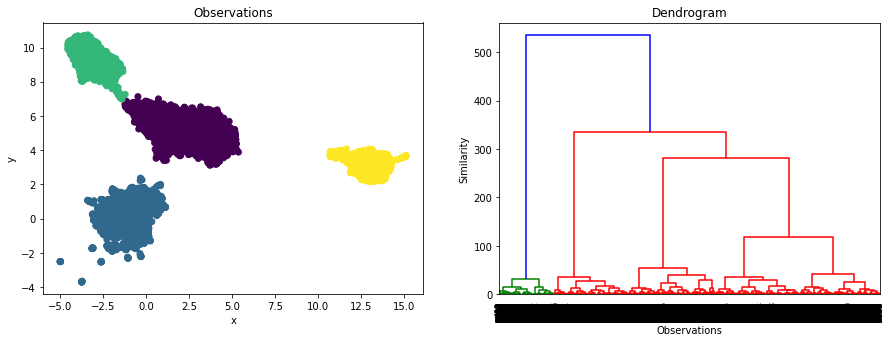

In [ ]:
model = AgglomerativeClustering(linkage=lkg, n_clusters=k)
model.fit(X_reduced_u_map_2D)
labels = model.labels_

CAH_plot(X_reduced_u_map_2D , labels)

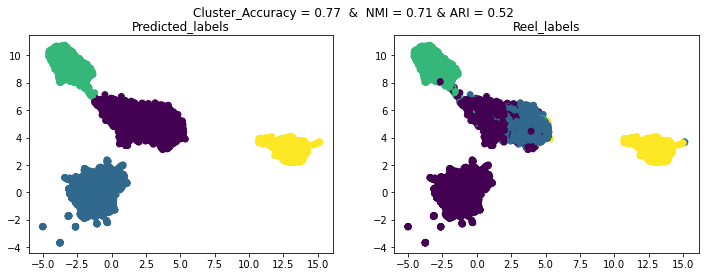

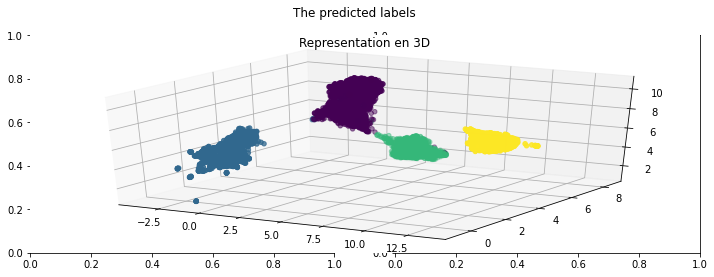

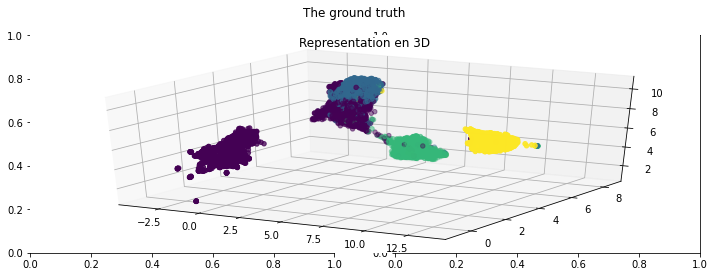

In [ ]:
# Plot 2D
eval_clustering_2D(X_reduced_u_map_2D , labels , label_num)

# Plot 3D
eval_clustering_3D(X_reduced_u_map_3D , labels, 'The predicted labels')
eval_clustering_3D(X_reduced_u_map_3D , label_num,  'The ground truth')

# Plot 3D avec plotly
# eval_clustering_3D_plotly(X_reduced_u_map_3D , labels)

### **Autoencodeurs**

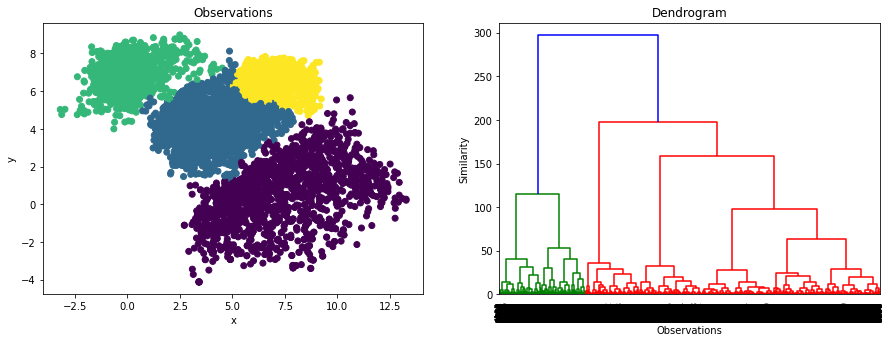

In [ ]:
model = AgglomerativeClustering(linkage=lkg, n_clusters=k)
model.fit(X_reduced_autoencodeur_2D)
labels = model.labels_

CAH_plot(X_reduced_autoencodeur_2D , labels)

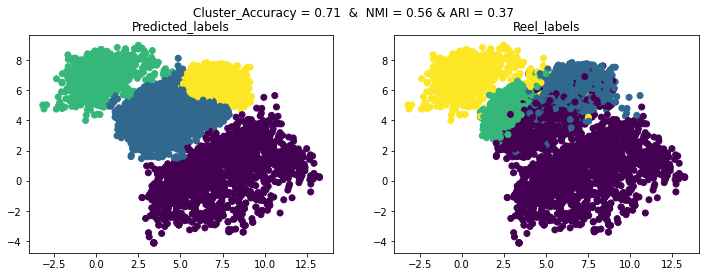

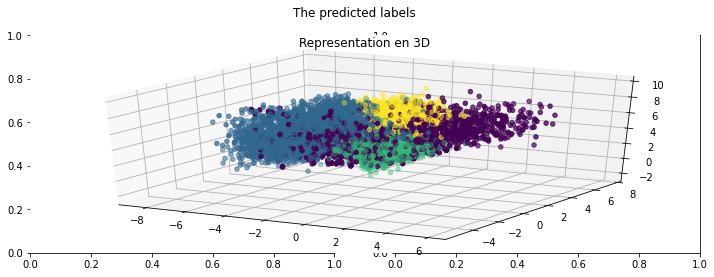

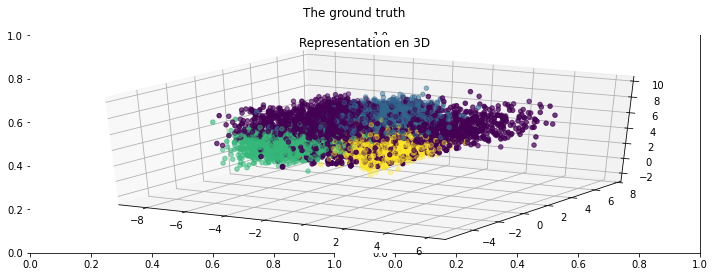

In [ ]:
# Plot 2D
eval_clustering_2D(X_reduced_autoencodeur_2D , labels , label_num)

# Plot 3D
eval_clustering_3D(X_reduced_autoencodeur_3D , labels, 'The predicted labels')
eval_clustering_3D(X_reduced_autoencodeur_3D , label_num,  'The ground truth')

# Plot 3D avec plotly
# eval_clustering_3D_plotly(X_reduced_autoencodeur_3D , labels)

## **Reduced k-means et Factorial k-means**

### **Reduced k-means**

In [ ]:
rkm_2D = fcps.TandemClustering(avg_bert,4,Type="Reduced",PlotIt=False, ndim=2, nstart=10)
rkm_3D = fcps.TandemClustering(avg_bert,4,Type="Reduced",PlotIt=False, ndim=3, nstart=10)

In [ ]:
# Reduced k-means
pred_label_rkm_2D = rkm_2D[0]
X_reduced_rkm_2D  = rkm_2D[1][0]

pred_label_rkm_3D = rkm_3D[0]
X_reduced_rkm_3D  = rkm_3D[1][0]

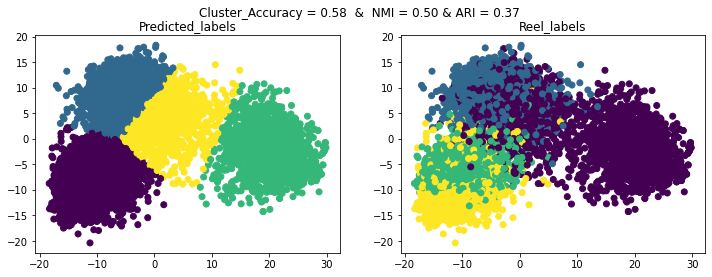

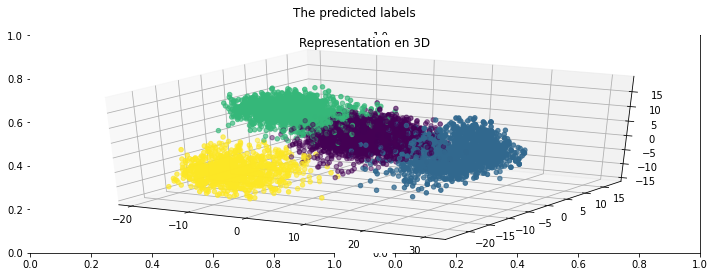

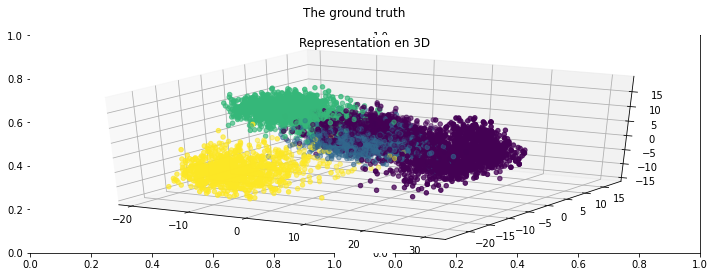

In [ ]:
# Plot 2D
eval_clustering_2D(X_reduced_rkm_2D , pred_label_rkm_2D , label_num)

# Plot 3D
eval_clustering_3D(X_reduced_rkm_3D , pred_label_rkm_3D, 'The predicted labels')
eval_clustering_3D(X_reduced_rkm_3D , label_num,  'The ground truth')

# Plot 3D avec plotly
# eval_clustering_3D_plotly(X_reduced_rkm_3D , pred_label_rkm_3D)

### **Factorial k-means**

In [ ]:
rkm_2D = fcps.TandemClustering(avg_bert,4,Type="Factorial",PlotIt=False, ndim=2, nstart=10)
rkm_3D = fcps.TandemClustering(avg_bert,4,Type="Factorial",PlotIt=False, ndim=3, nstart=10)

  |======================================================================| 100%

In [ ]:
# Factorial k-means
pred_label_rkm_2D = rkm_2D[0]
X_reduced_rkm_2D  = rkm_2D[1][0]

pred_label_rkm_3D = rkm_3D[0]
X_reduced_rkm_3D  = rkm_3D[1][0]

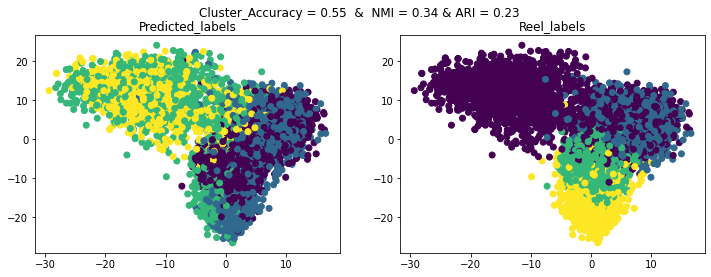

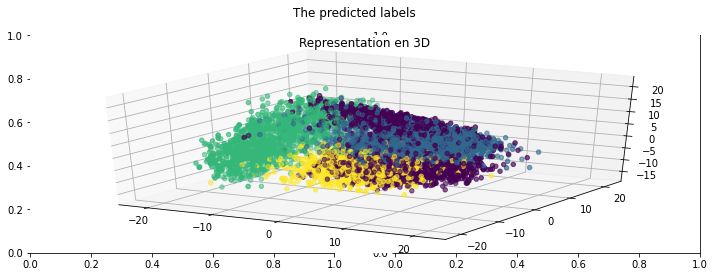

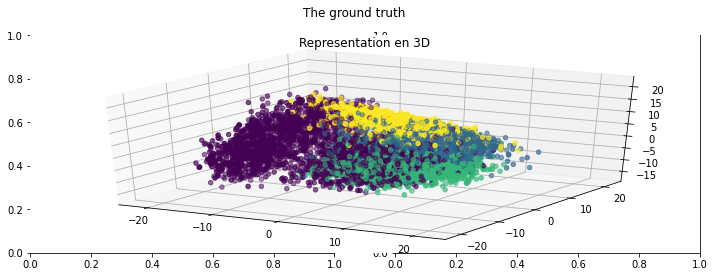

In [ ]:
# Plot 2D
eval_clustering_2D(X_reduced_rkm_2D , pred_label_rkm_2D , label_num)

# Plot 3D
eval_clustering_3D(X_reduced_rkm_3D , pred_label_rkm_3D, 'The predicted labels')
eval_clustering_3D(X_reduced_rkm_3D , label_num,  'The ground truth')

### **Deep Clustering Network (DCN)**

In [ ]:
from DKM_DCN_tf_py import DKM , DCN

In [ ]:
import tensorflow.compat.v1 as tf
tf.reset_default_graph()

In [ ]:
Deep_Clustering_Network = DCN(data = avg_bert , n_clusters = 4, n_components = 2, n_pretrain_epochs=50, n_finetuning_epochs=50, lambda_=1.0, batch_size=256, seed=None, cpu=False)

/content/DKM_DCN_tf_py.py:21: UserWarning:

`tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.

/usr/local/lib/python3.7/dist-packages/keras/legacy_tf_layers/core.py:255: UserWarning:

`layer.apply` is deprecated and will be removed in a future version. Please use `layer.__call__` method instead.



Starting autoencoder pretraining...


100%|██████████| 50/50 [00:13<00:00,  3.73it/s]


Running k-means on the learned embeddings...
Starting DCN training...


100%|██████████| 50/50 [00:50<00:00,  1.02s/it]


In [ ]:
tf.reset_default_graph()

In [ ]:
Deep_Clustering_Network_3D = DCN(data = avg_bert , n_clusters = 4, n_components = 3, n_pretrain_epochs=50, n_finetuning_epochs=50, lambda_=1.0, batch_size=256, seed=None, cpu=False)

/content/DKM_DCN_tf_py.py:21: UserWarning:

`tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.

/usr/local/lib/python3.7/dist-packages/keras/legacy_tf_layers/core.py:255: UserWarning:

`layer.apply` is deprecated and will be removed in a future version. Please use `layer.__call__` method instead.



Starting autoencoder pretraining...


100%|██████████| 50/50 [00:11<00:00,  4.18it/s]


Running k-means on the learned embeddings...
Starting DCN training...


100%|██████████| 50/50 [00:51<00:00,  1.02s/it]


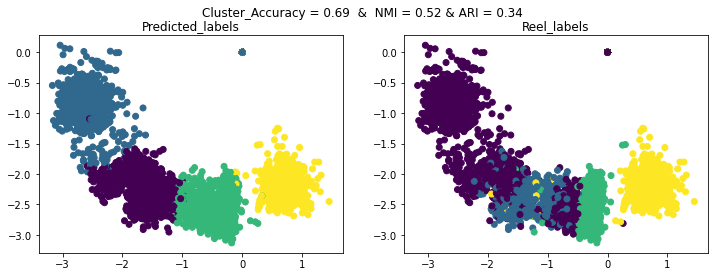

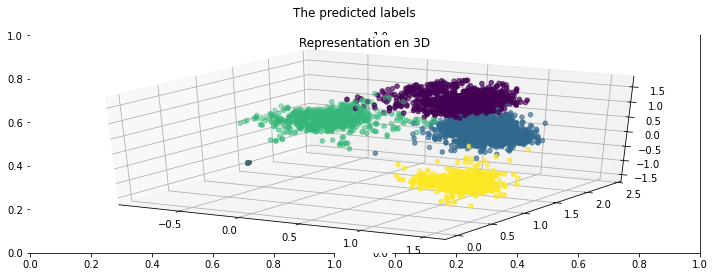

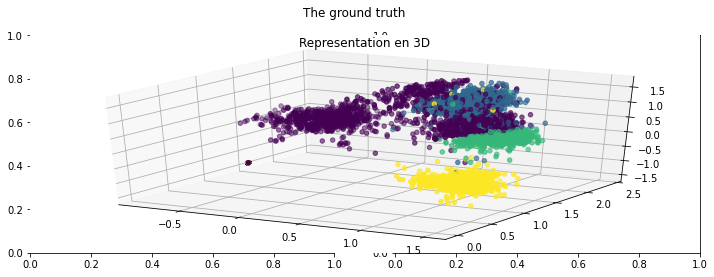

In [ ]:
# Deep Clustering Network
pred_label_DCN = Deep_Clustering_Network[1]
X_reduced_DCN  = Deep_Clustering_Network[0]

pred_label_DCN_3D = Deep_Clustering_Network_3D[1]
X_reduced_DCN_3D  = Deep_Clustering_Network_3D[0]

# Plot 2D
eval_clustering_2D(X_reduced_DCN , pred_label_DCN , label_num)

# Plot 3D
eval_clustering_3D(X_reduced_DCN_3D , pred_label_DCN_3D, 'The predicted labels')
eval_clustering_3D(X_reduced_DCN_3D , label_num,  'The ground truth')

### **Deep k-means (DKM)**

In [ ]:
tf.reset_default_graph()

In [ ]:
Deep_kmeans_2D = DKM(data = avg_bert, n_clusters = 4, n_components = 2, n_pretrain_epochs=50, n_finetuning_epochs=5, lambda_=1.0, batch_size=256, seed=None, cpu=False)

/content/DKM_DCN_tf_py.py:21: UserWarning:

`tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.

/usr/local/lib/python3.7/dist-packages/keras/legacy_tf_layers/core.py:255: UserWarning:

`layer.apply` is deprecated and will be removed in a future version. Please use `layer.__call__` method instead.



Starting autoencoder pretraining...


100%|██████████| 50/50 [00:13<00:00,  3.79it/s]


Running k-means on the learned embeddings...
Starting DKM training...


100%|██████████| 20/20 [00:36<00:00,  1.83s/it]


In [ ]:
tf.reset_default_graph()

In [ ]:
Deep_kmeans_3D = DKM(data = avg_bert, n_clusters = 4, n_components = 3, n_pretrain_epochs=50, n_finetuning_epochs=5, lambda_=1.0, batch_size=256, seed=None, cpu=False)

/content/DKM_DCN_tf_py.py:21: UserWarning:

`tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.

/usr/local/lib/python3.7/dist-packages/keras/legacy_tf_layers/core.py:255: UserWarning:

`layer.apply` is deprecated and will be removed in a future version. Please use `layer.__call__` method instead.



Starting autoencoder pretraining...


100%|██████████| 50/50 [00:12<00:00,  3.90it/s]


Running k-means on the learned embeddings...
Starting DKM training...


100%|██████████| 20/20 [00:36<00:00,  1.82s/it]


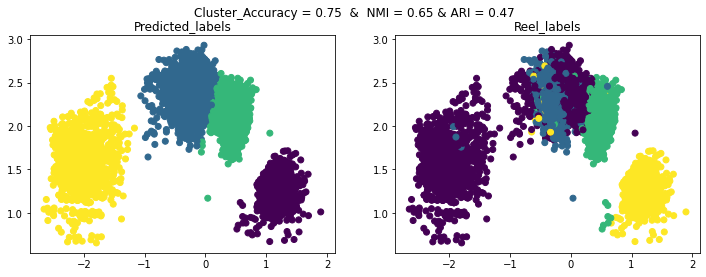

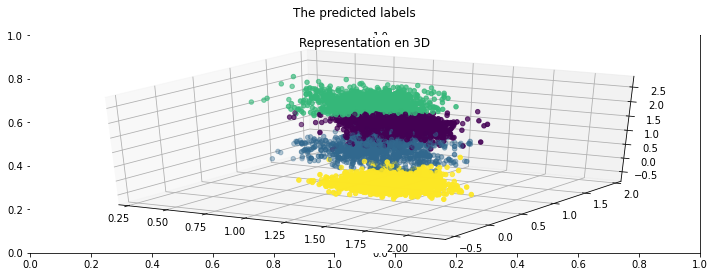

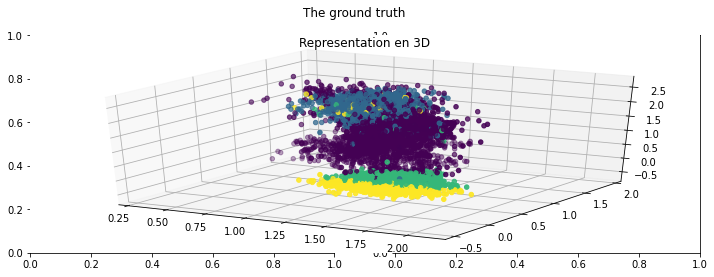

In [ ]:
# Deep k-means (DKM)
pred_label_DKM_2D = Deep_kmeans_2D[1]
X_reduced_DKM_2D  = Deep_kmeans_2D[0]

pred_label_DKM_3D = Deep_kmeans_3D[1]
X_reduced_DKM_3D  = Deep_kmeans_3D[0]

# Plot 2D
eval_clustering_2D(X_reduced_DKM_2D , pred_label_DKM_2D , label_num)

# Plot 3D
eval_clustering_3D(X_reduced_DKM_3D , pred_label_DKM_3D, 'The predicted labels')
eval_clustering_3D(X_reduced_DKM_3D , label_num,  'The ground truth')

# **Roberta**

In [ ]:
model_name  = 'roberta-base'
model = RobertaModel.from_pretrained(model_name,output_hidden_states=True)
tokenizer = RobertaTokenizer.from_pretrained(model_name)

if device == "cuda":
  model.cuda()

roberta_embeddings = encode_sentences_batch(model,tokenizer,texts_cleaned,batch_size=32)
concat_roberta = compute_concat_embeddings(roberta_embeddings)
avg_roberta = compute_average_embeddings(roberta_embeddings)

Some weights of the model checkpoint at roberta-base were not used when initializing RobertaModel: ['lm_head.layer_norm.bias', 'lm_head.layer_norm.weight', 'lm_head.dense.weight', 'lm_head.dense.bias', 'lm_head.bias', 'lm_head.decoder.weight']
- This IS expected if you are initializing RobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning:

This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessiv

In [ ]:
avg_roberta.shape
print(concat_roberta.shape)

(7095, 9216)


## **K-means**

In [ ]:
pred_label_KMeans = KMeans(k, random_state=42)  .fit(avg_roberta).labels_

R[write to console]: Loading required namespace: pracma



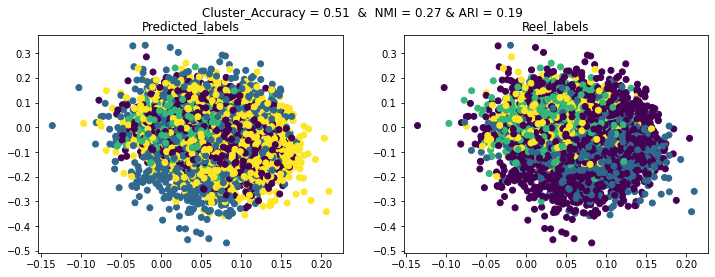

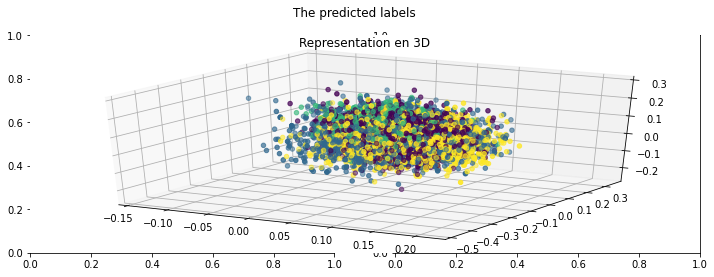

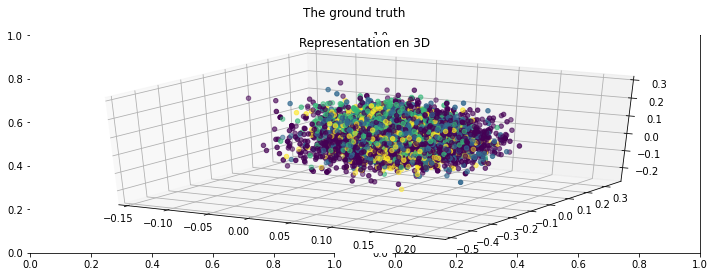

In [ ]:
# Plot 2D
eval_clustering_2D(avg_roberta , pred_label_KMeans , label_num)

# Plot 3D
eval_clustering_3D(avg_roberta , pred_label_KMeans, 'The predicted labels')
eval_clustering_3D(avg_roberta , label_num ,  'The ground truth')

### **PCA**

In [ ]:
# ACP
X_reduced_pca_2D = PCA(n_components=2, whiten=True, random_state=42).fit_transform(avg_roberta)
X_reduced_pca_3D = PCA(n_components=3, whiten=True, random_state=42).fit_transform(avg_roberta)

In [ ]:
# Kmeans
pred_label_PCA = KMeans(k, random_state=42).fit(X_reduced_pca_2D).labels_
pred_label_PCA_3 = KMeans(k, random_state=42).fit(X_reduced_pca_3D).labels_

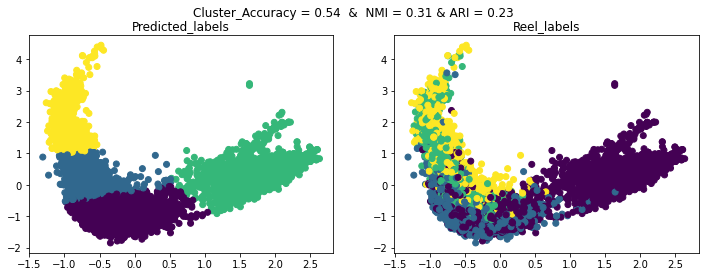

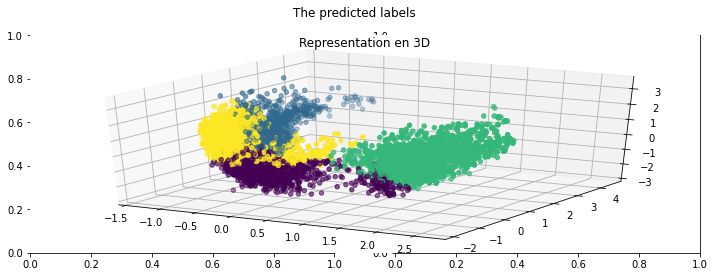

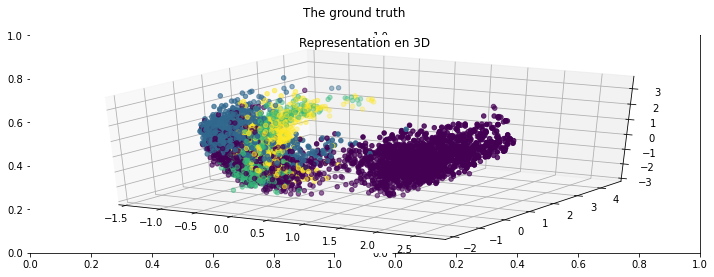

In [ ]:
# Plot 2D
eval_clustering_2D(X_reduced_pca_2D,pred_label_PCA,label_num)

# Plot 3D
eval_clustering_3D(X_reduced_pca_3D,pred_label_PCA_3 , 'The predicted labels')
eval_clustering_3D(X_reduced_pca_3D,label_num ,  'The ground truth' )

### **TSNE**

In [ ]:
# TSNE
X_reduced_tsne_2D = TSNE(n_components=2, random_state=42).fit_transform(avg_roberta)
X_reduced_tsne_3D = TSNE(n_components=3, random_state=42).fit_transform(avg_roberta)

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:783: FutureWarning:

The default initialization in TSNE will change from 'random' to 'pca' in 1.2.

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning:

The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:783: FutureWarning:

The default initialization in TSNE will change from 'random' to 'pca' in 1.2.

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning:

The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.



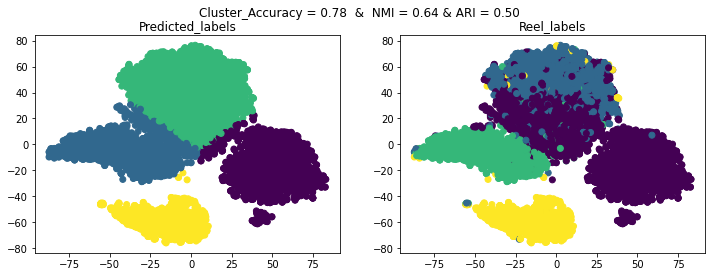

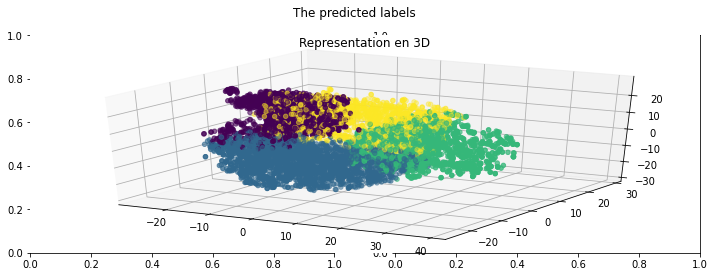

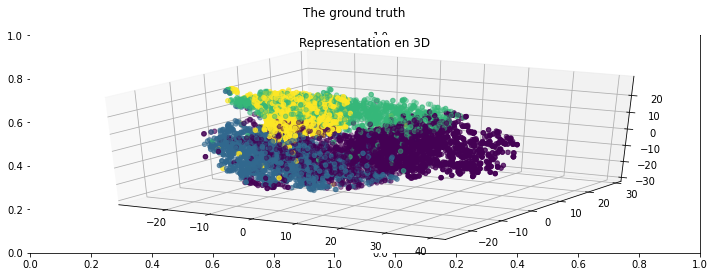

In [ ]:
# Kmeans
pred_label_KMeans = KMeans(k, random_state=42).fit(X_reduced_tsne_2D).labels_
pred_label_KMeans_3D = KMeans(k, random_state=42).fit(X_reduced_tsne_3D).labels_

# Plot 2D
eval_clustering_2D(X_reduced_tsne_2D , pred_label_KMeans , label_num)

# Plot 3D
eval_clustering_3D(X_reduced_tsne_3D , pred_label_KMeans_3D, 'The predicted labels')
eval_clustering_3D(X_reduced_tsne_3D , label_num,  'The ground truth')

### **UMAP**

In [ ]:
X_reduced_u_map_2D = UMAP(n_components=2, random_state=42).fit_transform(avg_roberta)
X_reduced_u_map_3D = UMAP(n_components=3, random_state=42).fit_transform(avg_roberta)

/usr/local/lib/python3.7/dist-packages/numba/np/ufunc/parallel.py:363: NumbaWarning:

The TBB threading layer requires TBB version 2019.5 or later i.e., TBB_INTERFACE_VERSION >= 11005. Found TBB_INTERFACE_VERSION = 9107. The TBB threading layer is disabled.



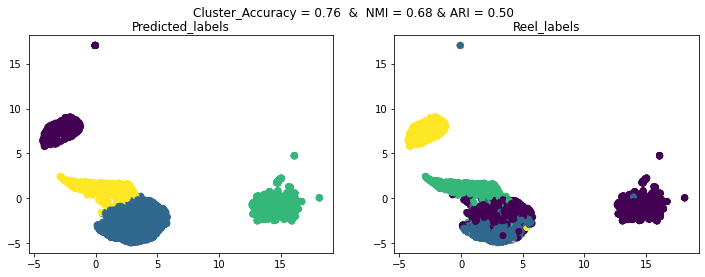

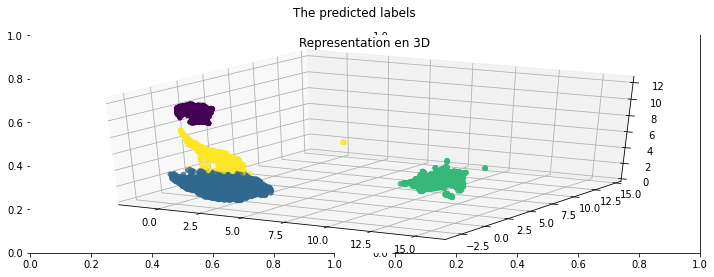

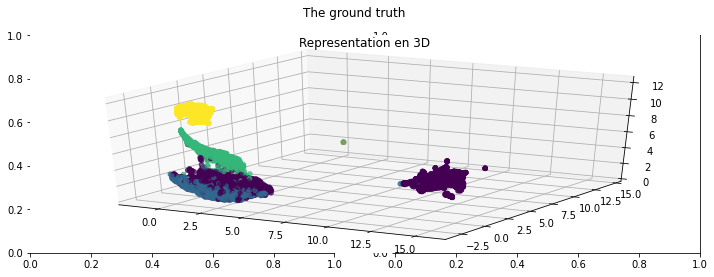

In [ ]:

# KMeans
pred_label_KMeans = KMeans(k, random_state=42).fit(X_reduced_u_map_2D).labels_
pred_label_KMeans_3D = KMeans(k, random_state=42).fit(X_reduced_u_map_3D).labels_

# Plot 2D
eval_clustering_2D(X_reduced_u_map_2D , pred_label_KMeans , label_num)

# Plot 3D
eval_clustering_3D(X_reduced_u_map_3D , pred_label_KMeans_3D, 'The predicted labels')
eval_clustering_3D(X_reduced_u_map_3D , label_num,  'The ground truth')

# Plot 3D avec plotly
# eval_clustering_3D_plotly(X_reduced_u_map_3D , pred_label_KMeans_3D)

### **Autoencodeur**

In [ ]:
class AutoEncoder(torch.nn.Module):
    def __init__(self, input_dim, embedding_dim):
        super().__init__()
        self.input_dim = input_dim
        self.embedding_dim = embedding_dim

        self.encoder = torch.nn.Sequential(
            torch.nn.Linear(self.input_dim, 128),
            torch.nn.ReLU(),
            torch.nn.Linear(128, self.embedding_dim)
        )
        
        self.decoder = torch.nn.Sequential(
            torch.nn.Linear(self.embedding_dim, 128),
            torch.nn.ReLU(),
            torch.nn.Linear(128, self.input_dim),
            torch.nn.Sigmoid()
        )

    def forward(self, x):
        encoded = self.encoder(x)
        decoded = self.decoder(encoded)
        return decoded

def autoencoder(X, embedding_dim, n_epochs=50, batch_size=64, learning_rate=1e-3, weight_decay=1e-8, seed=None, return_model=False):
    if torch.cuda.is_available():
        device = 'cuda'
    else:
        device = 'cpu'

    if seed is not None:
      torch.manual_seed(seed)

    dataloader = DataLoader(dataset=X, batch_size=batch_size, shuffle=True)

    model = AutoEncoder(input_dim=X.shape[1], embedding_dim=embedding_dim)

    if device == 'cuda':
      model.cuda()

    loss_function = torch.nn.MSELoss()

    optimizer = torch.optim.Adam(model.parameters(),
                                lr=learning_rate,
                                weight_decay=weight_decay)

    losses = []

    model.train()
    for epoch in tqdm(range(n_epochs)):
        for batch in dataloader:
          batch = batch.to(device)
          reconstructed = model(batch)
          
          loss = loss_function(reconstructed, batch)
          
          optimizer.zero_grad()
          loss.backward()
          optimizer.step()
          
          losses.append(loss)

    model.eval()
    tensor_X = torch.tensor(X)
    tensor_X = tensor_X.to(device)
    encoded_X = model.encoder(tensor_X)
    encoded_X = encoded_X.detach().cpu().numpy()

    if return_model:
      return encoded_X, model, losses
    else:
      return encoded_X


In [ ]:
# AutoEncoder
X_reduced_autoencodeur_2D = autoencoder(avg_roberta.astype("float32"),2, seed=42)
X_reduced_autoencodeur_3D = autoencoder(avg_roberta.astype("float32"),3, seed=42)

100%|██████████| 50/50 [00:17<00:00,  2.86it/s]


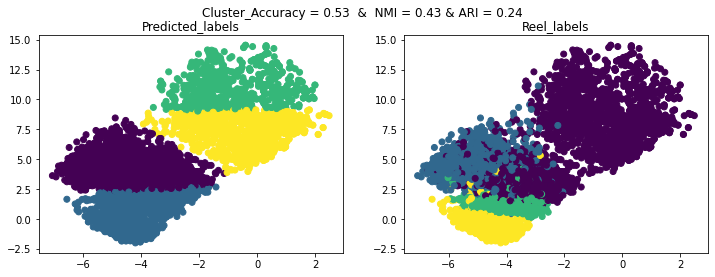

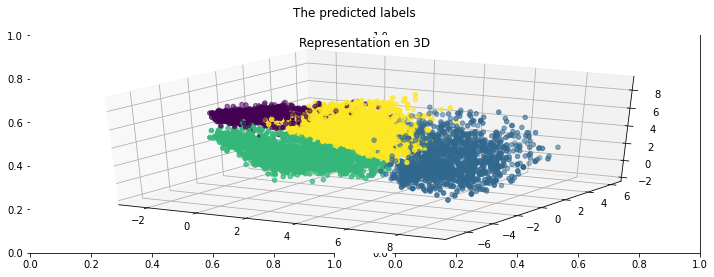

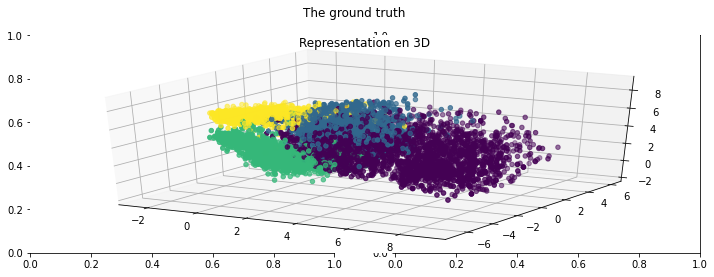

In [ ]:
# KMeans
pred_label_KMeans = KMeans(k, random_state=42).fit(X_reduced_autoencodeur_2D).labels_
pred_label_KMeans_3D = KMeans(k, random_state=42).fit(X_reduced_autoencodeur_3D).labels_

# Plot 2D
eval_clustering_2D(X_reduced_autoencodeur_2D , pred_label_KMeans , label_num)

# Plot 3D
eval_clustering_3D(X_reduced_autoencodeur_3D , pred_label_KMeans_3D, 'The predicted labels')
eval_clustering_3D(X_reduced_autoencodeur_3D , label_num,  'The ground truth')

# Plot 3D avec plotly
# eval_clustering_3D_plotly(X_reduced_autoencodeur_3D , pred_label_KMeans_3D)

## **HDBSCAN**

### **Appliquer sur l'espace dorigine**

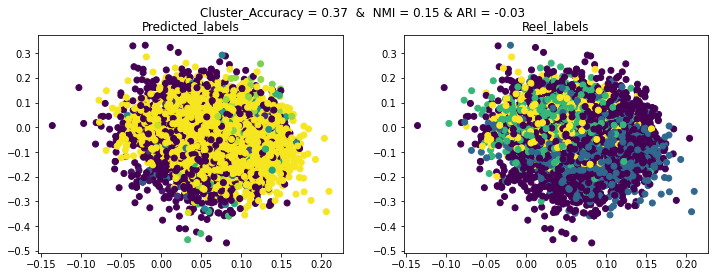

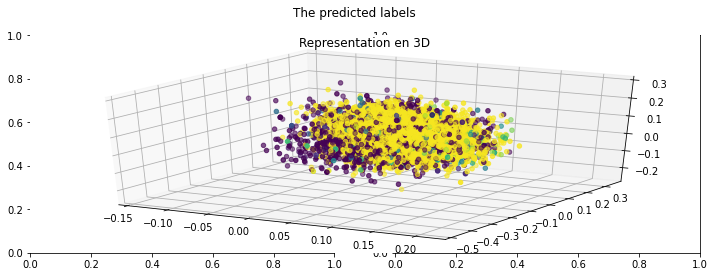

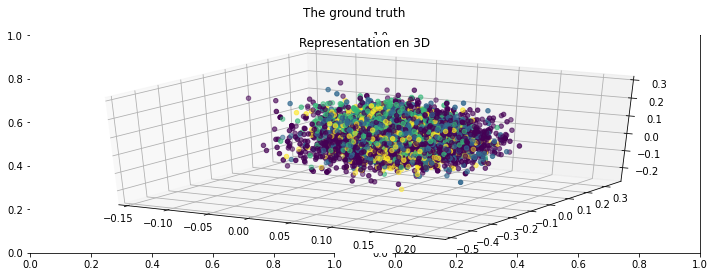

In [ ]:
# hdbscan model
hdbscan_model = hdbscan.HDBSCAN(min_cluster_size=4,algorithm="best",alpha=1.0,leaf_size=40,cluster_selection_method='eom',metric='euclidean').fit(avg_roberta)
pred_label_hdbscan = hdbscan_model.labels_

# Plot 2D
eval_clustering_2D(avg_roberta , pred_label_hdbscan , label_num)

# Plot 3D
eval_clustering_3D(avg_roberta , pred_label_hdbscan, 'The predicted labels')
eval_clustering_3D(avg_roberta , label_num ,  'The ground truth')

### **PCA**

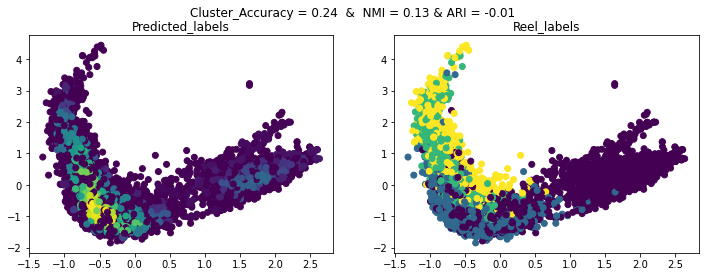

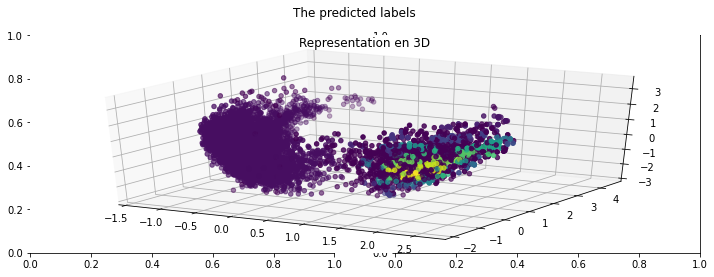

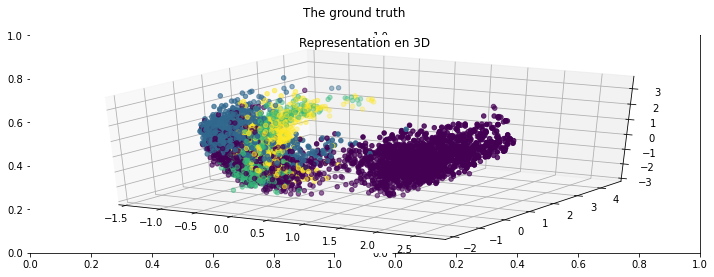

In [ ]:
# HDBSCAN
hdbscan_model = hdbscan.HDBSCAN(min_cluster_size=4,algorithm="best",alpha=1.0,leaf_size=40,cluster_selection_method='eom',metric='euclidean').fit(X_reduced_pca_2D)
pred_label_hdbscan = hdbscan_model.labels_
hdbscan_model_3D = hdbscan.HDBSCAN(min_cluster_size=4,algorithm="best",alpha=1.0,leaf_size=40,cluster_selection_method='eom',metric='euclidean').fit(X_reduced_pca_3D)
pred_label_hdbscan_3D = hdbscan_model_3D.labels_

# Plot 2D
eval_clustering_2D(X_reduced_pca_2D , pred_label_hdbscan , label_num)

# Plot 3D
eval_clustering_3D(X_reduced_pca_3D , pred_label_hdbscan_3D, 'The predicted labels')
eval_clustering_3D(X_reduced_pca_3D , label_num,  'The ground truth')

### **TSNE**

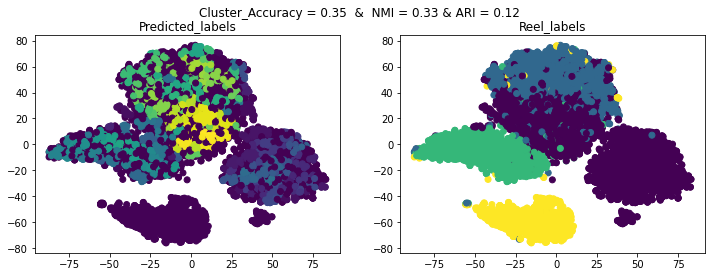

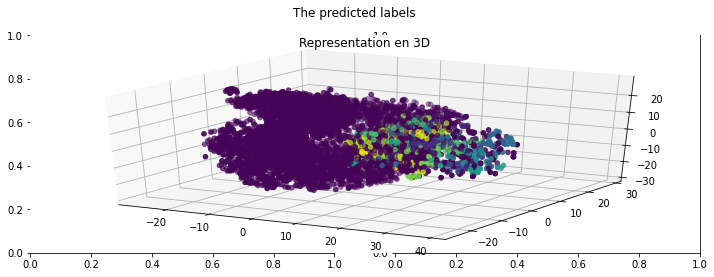

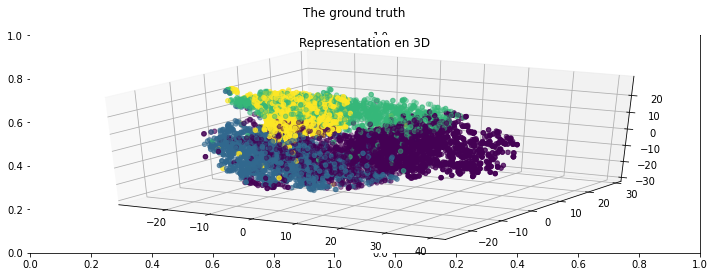

In [ ]:
# HDBSCAN
hdbscan_model = hdbscan.HDBSCAN(min_cluster_size=4,algorithm="best",alpha=1.0,leaf_size=40,cluster_selection_method='eom',metric='euclidean').fit(X_reduced_tsne_2D)
pred_label_hdbscan = hdbscan_model.labels_
hdbscan_model_3D = hdbscan.HDBSCAN(min_cluster_size=4,algorithm="best",alpha=1.0,leaf_size=40,cluster_selection_method='eom',metric='euclidean').fit(X_reduced_tsne_3D)
pred_label_hdbscan_3D = hdbscan_model_3D.labels_

# Plot 2D
eval_clustering_2D(X_reduced_tsne_2D , pred_label_hdbscan , label_num)

# Plot 3D
eval_clustering_3D(X_reduced_tsne_3D , pred_label_hdbscan_3D, 'The predicted labels')
eval_clustering_3D(X_reduced_tsne_3D , label_num,  'The ground truth')

# Plot 3D avec plotly
# eval_clustering_3D_plotly(X_reduced_tsne_3D , pred_label_hdbscan_3D)

### **UMAP**

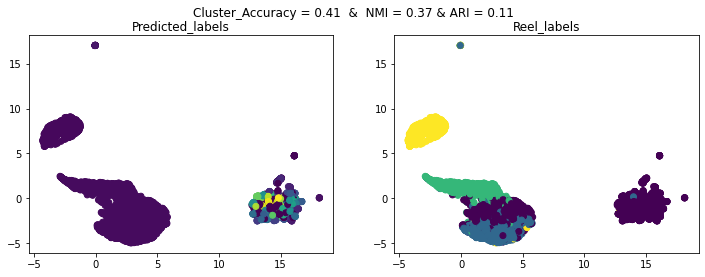

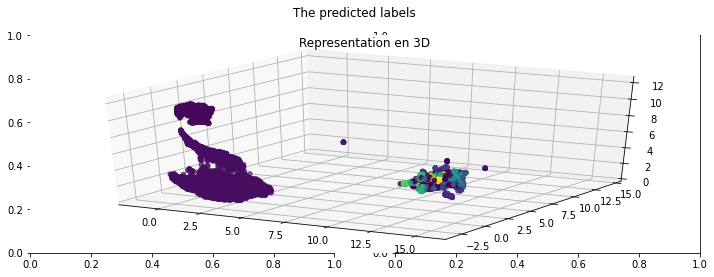

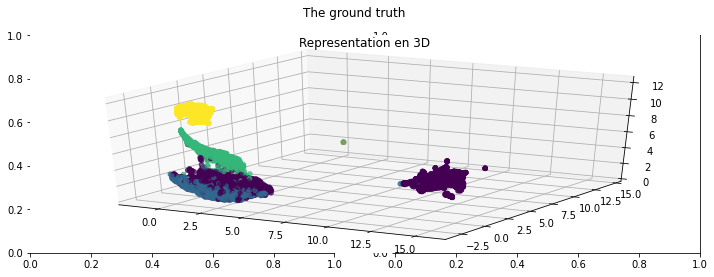

In [ ]:
# HDBSCAN
hdbscan_model = hdbscan.HDBSCAN(min_cluster_size=4,algorithm="best",alpha=1.0,leaf_size=40,cluster_selection_method='eom',metric='euclidean').fit(X_reduced_u_map_2D)
pred_label_hdbscan = hdbscan_model.labels_
hdbscan_model_3D = hdbscan.HDBSCAN(min_cluster_size=4,algorithm="best",alpha=1.0,leaf_size=40,cluster_selection_method='eom',metric='euclidean').fit(X_reduced_u_map_3D)
pred_label_hdbscan_3D = hdbscan_model_3D.labels_

# Plot 2D
eval_clustering_2D(X_reduced_u_map_2D , pred_label_hdbscan , label_num)

# Plot 3D
eval_clustering_3D(X_reduced_u_map_3D , pred_label_hdbscan_3D, 'The predicted labels')
eval_clustering_3D(X_reduced_u_map_3D , label_num,  'The ground truth')

# Plot 3D avec plotly
# eval_clustering_3D_plotly(X_reduced_u_map_3D , pred_label_hdbscan_3D)

### **Autoencodeur**

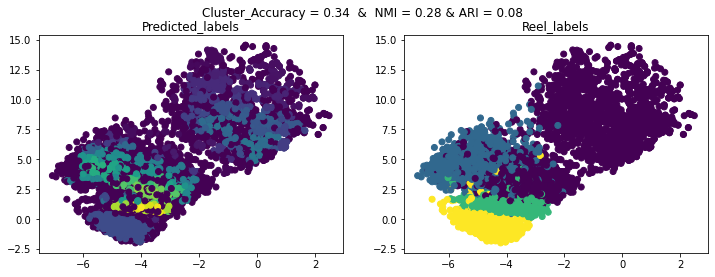

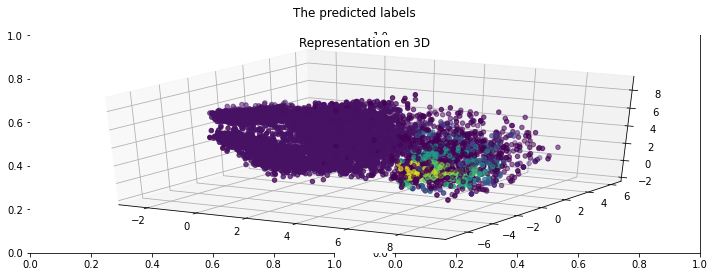

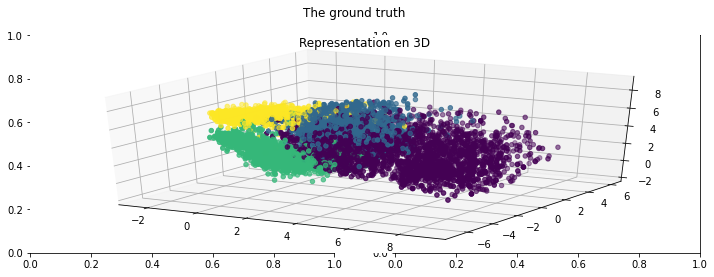

In [ ]:
# HDBSCAN
hdbscan_model = hdbscan.HDBSCAN(min_cluster_size=4,algorithm="best",alpha=1.0,leaf_size=40,cluster_selection_method='eom',metric='euclidean').fit(X_reduced_autoencodeur_2D)
pred_label_hdbscan = hdbscan_model.labels_
hdbscan_model_3D = hdbscan.HDBSCAN(min_cluster_size=4,algorithm="best",alpha=1.0,leaf_size=40,cluster_selection_method='eom',metric='euclidean').fit(X_reduced_autoencodeur_3D)
pred_label_hdbscan_3D = hdbscan_model_3D.labels_

# Plot 2D
eval_clustering_2D(X_reduced_autoencodeur_2D , pred_label_hdbscan , label_num)

# Plot 3D
eval_clustering_3D(X_reduced_autoencodeur_3D , pred_label_hdbscan_3D, 'The predicted labels')
eval_clustering_3D(X_reduced_autoencodeur_3D , label_num,  'The ground truth')

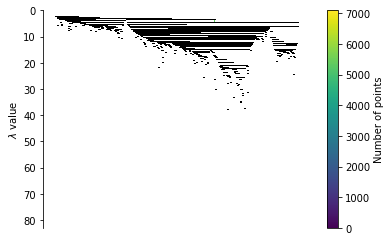

In [ ]:
hdbscan_model.condensed_tree_.plot()

## **Spectral clustering**

### **Appliquer sur l'espace d'origine**

In [ ]:
pred_label_spectral = SpectralClustering(k,affinity="nearest_neighbors",n_neighbors=10,random_state=42).fit(avg_roberta).labels_
print(round(normalized_mutual_info_score(pred_label_spectral,label),2))

0.48


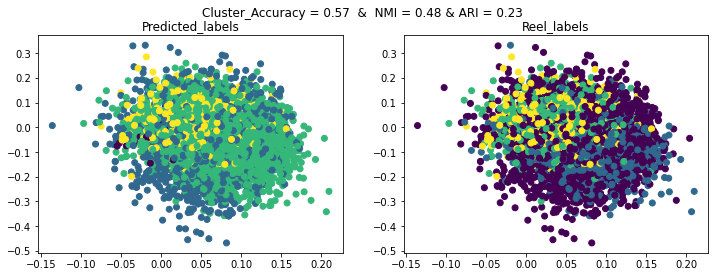

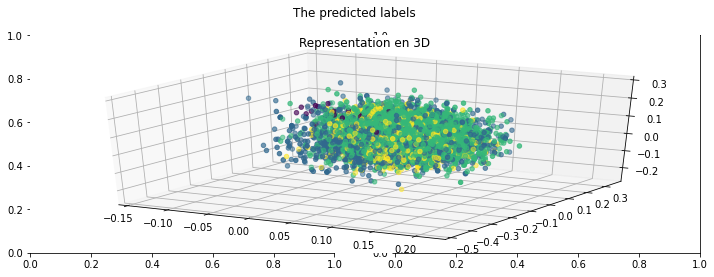

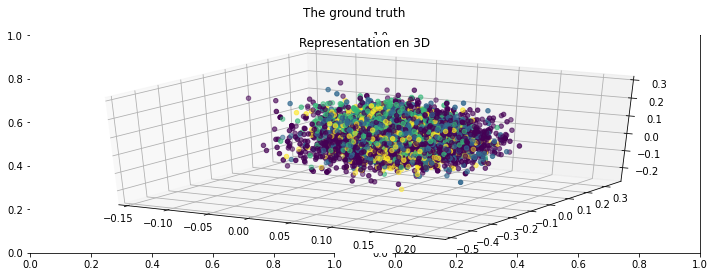

In [ ]:
# Plot 2D
eval_clustering_2D(avg_roberta , pred_label_spectral , label_num)

# Plot 3D
eval_clustering_3D(avg_roberta , pred_label_spectral, 'The predicted labels')
eval_clustering_3D(avg_roberta , label_num ,  'The ground truth')

### **ACP**

In [ ]:
# Spectral Clustering
pred_label_spectral = SpectralClustering(k,affinity="nearest_neighbors",n_neighbors=10,random_state=42).fit(X_reduced_pca_2D).labels_
pred_label_spectral_3D = SpectralClustering(k,affinity="nearest_neighbors",n_neighbors=10,random_state=42).fit(X_reduced_pca_3D).labels_

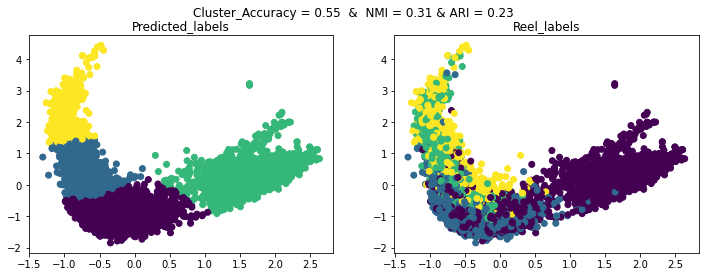

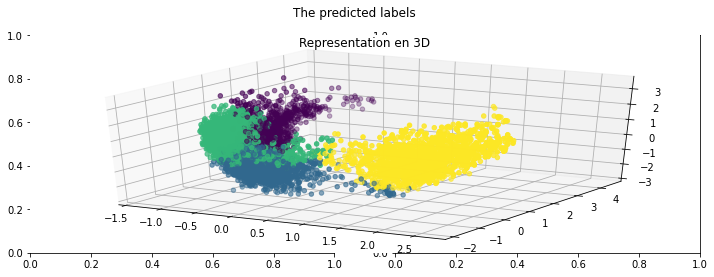

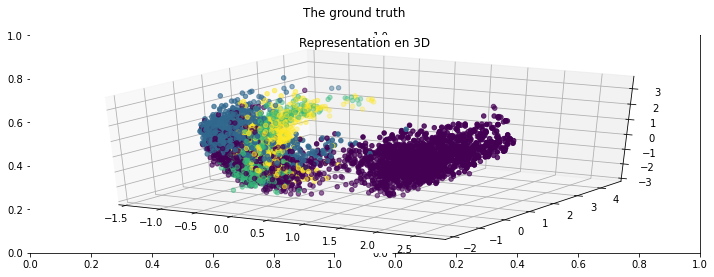

In [ ]:
# Plot 2D
eval_clustering_2D(X_reduced_pca_2D , pred_label_spectral , label_num)

# Plot 3D
eval_clustering_3D(X_reduced_pca_3D , pred_label_spectral_3D, 'The predicted labels')
eval_clustering_3D(X_reduced_pca_3D , label_num,  'The ground truth')

### **TSNE**

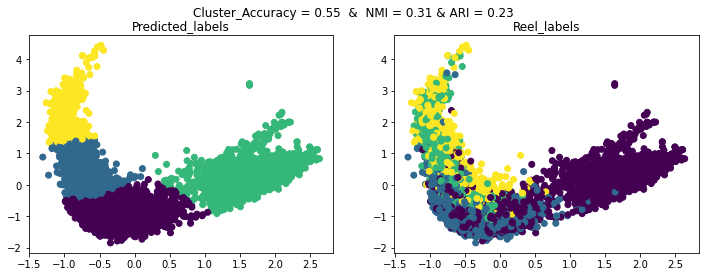

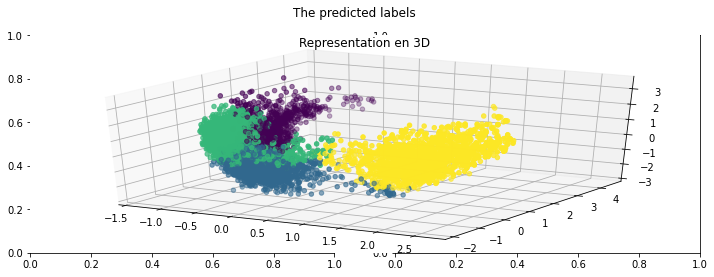

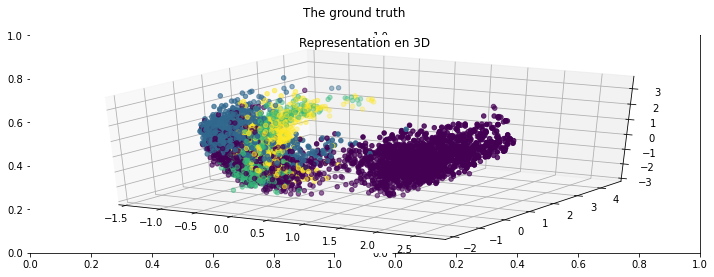

In [ ]:
# Plot 2D
eval_clustering_2D(X_reduced_pca_2D , pred_label_spectral , label_num)

# Plot 3D
eval_clustering_3D(X_reduced_pca_3D , pred_label_spectral_3D, 'The predicted labels')
eval_clustering_3D(X_reduced_pca_3D , label_num,  'The ground truth')

### **UMAP**

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_spectral_embedding.py:261: UserWarning:

Graph is not fully connected, spectral embedding may not work as expected.

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_spectral_embedding.py:261: UserWarning:

Graph is not fully connected, spectral embedding may not work as expected.



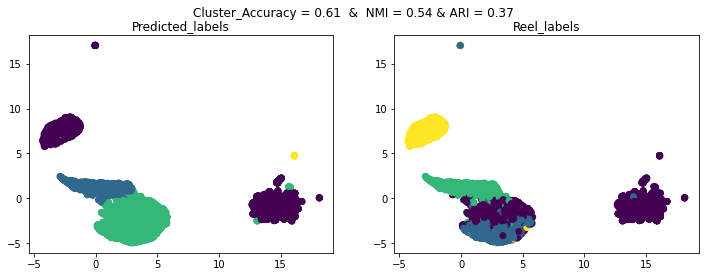

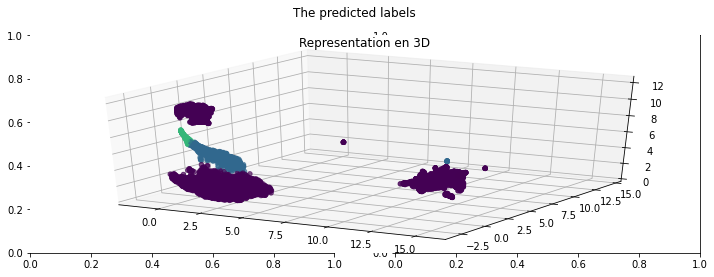

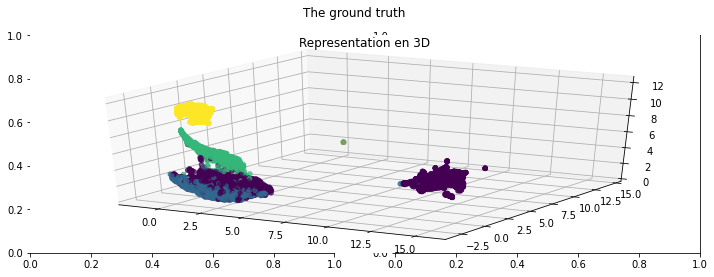

In [ ]:
# Spectral Clustering
pred_label_spectral = SpectralClustering(k,affinity="nearest_neighbors",n_neighbors=10,random_state=42).fit(X_reduced_u_map_2D).labels_
pred_label_spectral_3D = SpectralClustering(k,affinity="nearest_neighbors",n_neighbors=10,random_state=42).fit(X_reduced_u_map_3D).labels_

# Plot 2D
eval_clustering_2D(X_reduced_u_map_2D , pred_label_spectral , label_num)

# Plot 3D
eval_clustering_3D(X_reduced_u_map_3D , pred_label_spectral_3D, 'The predicted labels')
eval_clustering_3D(X_reduced_u_map_3D , label_num,  'The ground truth')

# Plot 3D avec plotly
# eval_clustering_3D_plotly(X_reduced_u_map_3D , pred_label_spectral_3D)

### **Autoencodeur**

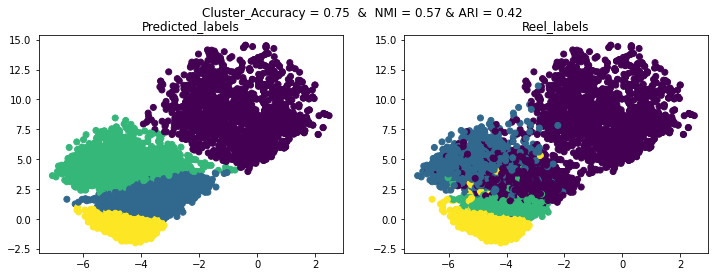

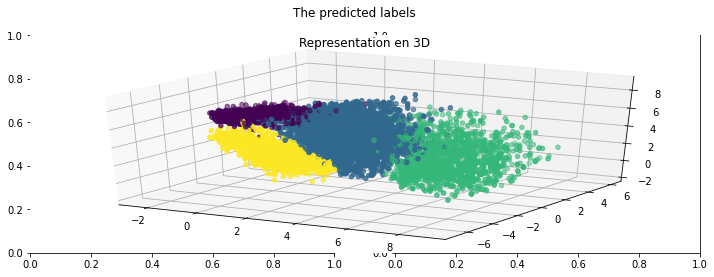

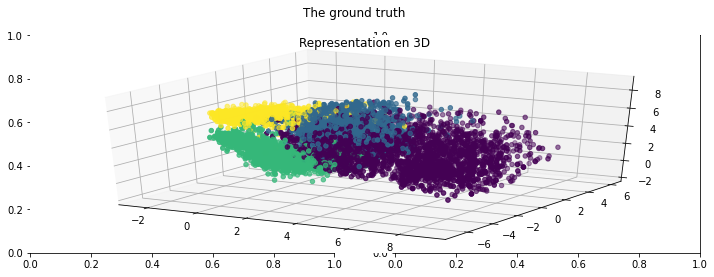

In [ ]:

# Spectral Clustering
pred_label_spectral = SpectralClustering(k,affinity="nearest_neighbors",n_neighbors=10,random_state=42).fit(X_reduced_autoencodeur_2D).labels_
pred_label_spectral_3D = SpectralClustering(k,affinity="nearest_neighbors",n_neighbors=10,random_state=42).fit(X_reduced_autoencodeur_3D).labels_

# Plot 2D
eval_clustering_2D(X_reduced_autoencodeur_2D , pred_label_spectral , label_num)

# Plot 3D
eval_clustering_3D(X_reduced_autoencodeur_3D , pred_label_spectral_3D, 'The predicted labels')
eval_clustering_3D(X_reduced_autoencodeur_3D , label_num,  'The ground truth')

# Plot 3D avec plotly
# eval_clustering_3D_plotly(X_reduced_autoencodeur_3D , pred_label_spectral_3D)

# **CAH**

In [ ]:
k = 4        # nombre de clusters
lkg = "ward" # métrique choisie dans le regroupement hiérarchique / critères d'agrégation

### **Appliquer sur l'espace d'origine**

In [ ]:
from sklearn.cluster import AgglomerativeClustering # génération de modèles de clustering
from scipy.cluster import hierarchy  # dendrogramme

# Créer un modèle de regroupement hiérarchique
# Trouver les étiquettes
cah_model = AgglomerativeClustering(linkage=lkg, n_clusters=k)
cah_model.fit(avg_roberta)
cah_pred_labels = cah_model.labels_

In [ ]:
import matplotlib.gridspec as gridspec

def CAH_plot(X , Labels , linkage=lkg):
    f_ex = plt.figure(figsize=(15,5))
    gs = gridspec.GridSpec(1,2)


    ax = f_ex.add_subplot(gs[0,0])
    ax.set_title("Observations")
    ax.set_xlabel("x")
    ax.set_ylabel("y")
    dendro =f_ex.add_subplot(gs[0,1])


    Z = hierarchy.linkage(X, linkage)
    # Sur la base de la matrice Z, créez le dendrogramme
    # recherchez scipy.cluster.hierarchy.dendrogram() pour implémenter cette tâche.
    hierarchy.dendrogram(
        Z,
        leaf_rotation=90.,  # rotates the x axis labels
        leaf_font_size=8.,  # font size for the x axis labels
    )


    dendro.set_title("Dendrogram")
    dendro.set_xlabel("Observations")
    dendro.set_ylabel("Similarity")

    ax.scatter(X[:,0],X[:,1], c=Labels, cmap='viridis')

    # boucle pour ajouter un exemple d'index en tant qu'étiquette
    # n, _ = X.shape
    # for i in range(n):
    #     ax.annotate("  " + str(i), (X[i,0],X[i,1]) )

    plt.show()

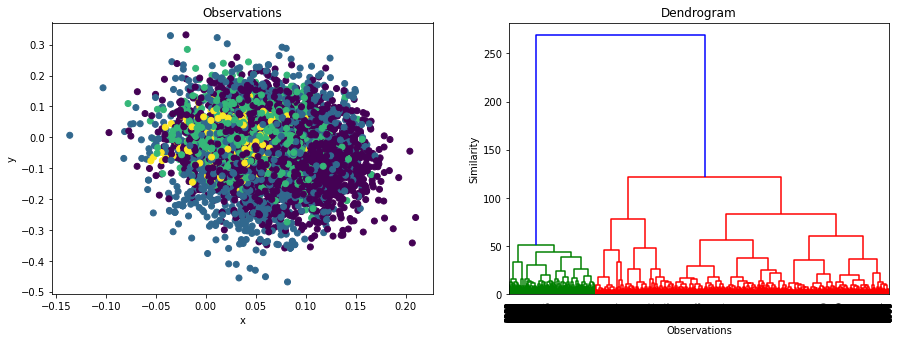

In [ ]:
CAH_plot(avg_roberta , cah_pred_labels)

### **PCA**

In [ ]:
cah_model = AgglomerativeClustering(linkage=lkg, n_clusters=k)
cah_model.fit(X_reduced_pca_2D)
cah_pred_labels = cah_model.labels_

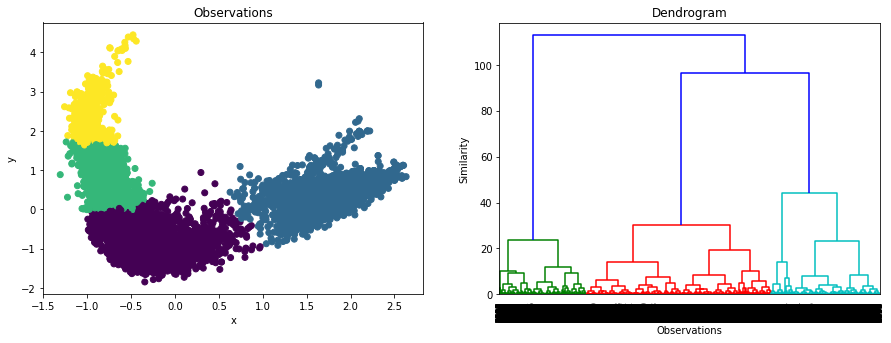

In [ ]:
CAH_plot(X_reduced_pca_2D , cah_pred_labels)

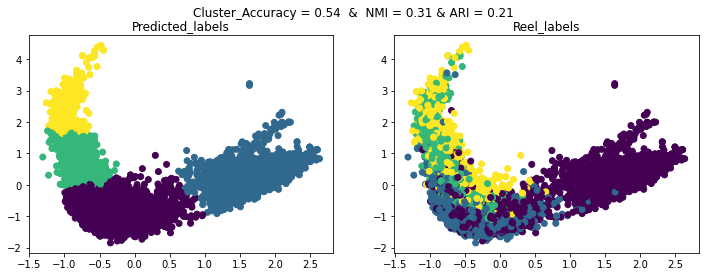

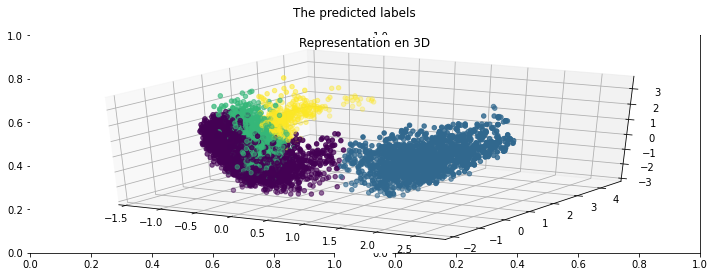

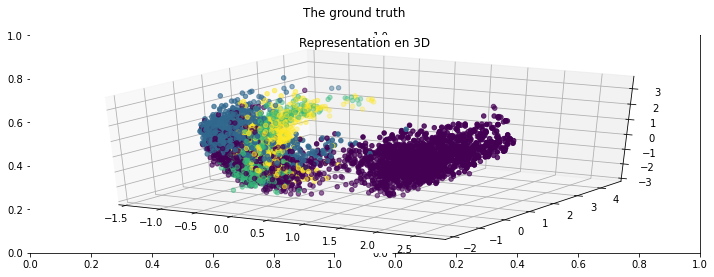

In [ ]:
# Plot 2D
eval_clustering_2D(X_reduced_pca_2D , cah_pred_labels , label_num)

# Plot 3D
eval_clustering_3D(X_reduced_pca_3D , cah_pred_labels, 'The predicted labels')
eval_clustering_3D(X_reduced_pca_3D , label_num,  'The ground truth')

### **TSNE**

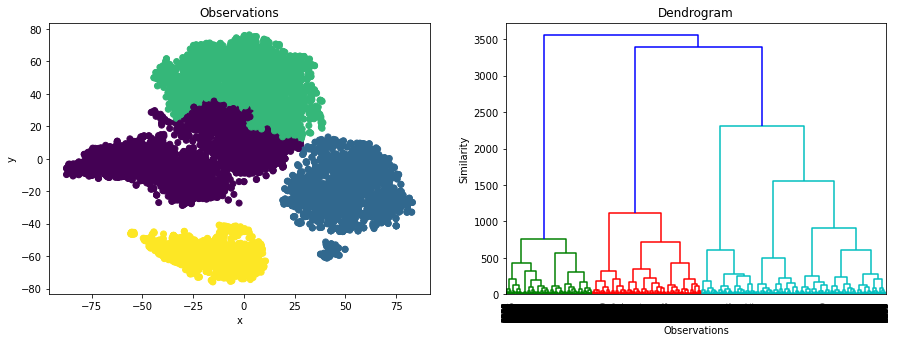

In [ ]:
model = AgglomerativeClustering(linkage=lkg, n_clusters=k)
model.fit(X_reduced_tsne_2D)
labels = model.labels_

CAH_plot(X_reduced_tsne_2D , labels)

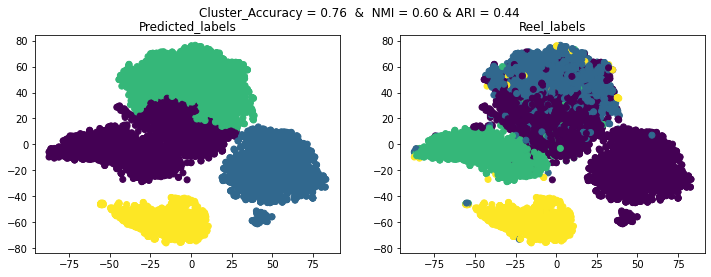

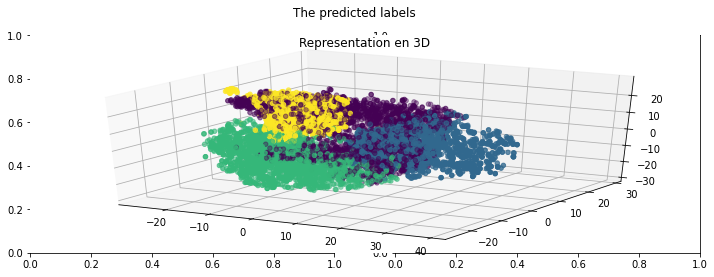

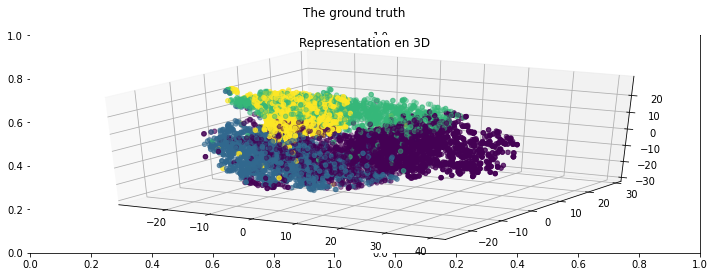

In [ ]:
# Plot 2D
eval_clustering_2D(X_reduced_tsne_2D , labels , label_num)

# Plot 3D
eval_clustering_3D(X_reduced_tsne_3D , labels, 'The predicted labels')
eval_clustering_3D(X_reduced_tsne_3D , label_num,  'The ground truth')

### **UMAP**

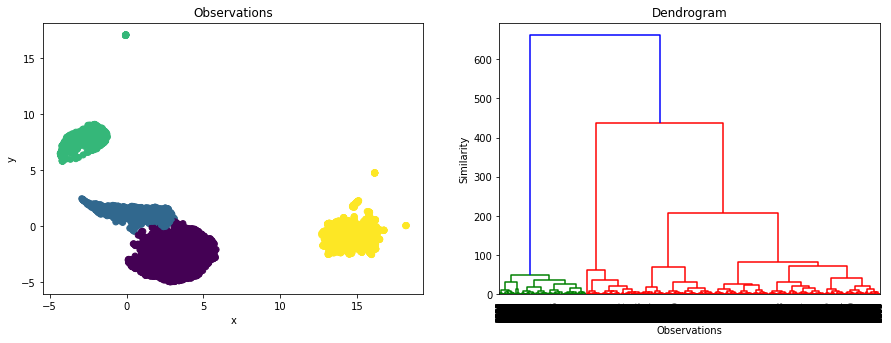

In [ ]:
model = AgglomerativeClustering(linkage=lkg, n_clusters=k)
model.fit(X_reduced_u_map_2D)
labels = model.labels_

CAH_plot(X_reduced_u_map_2D , labels)

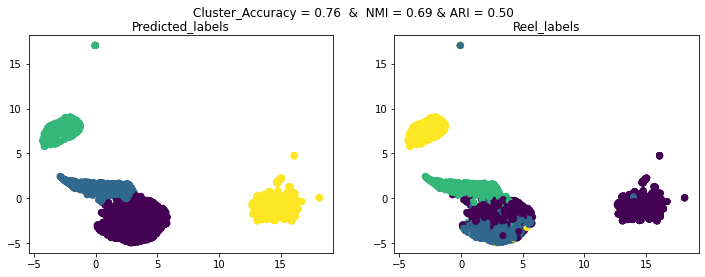

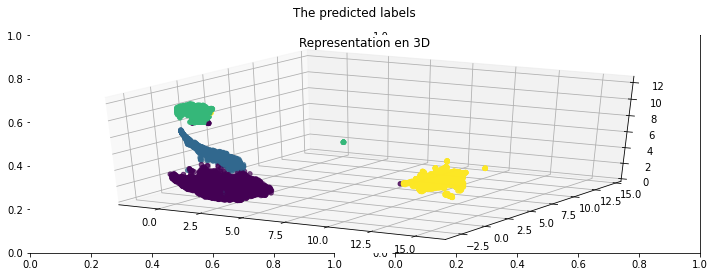

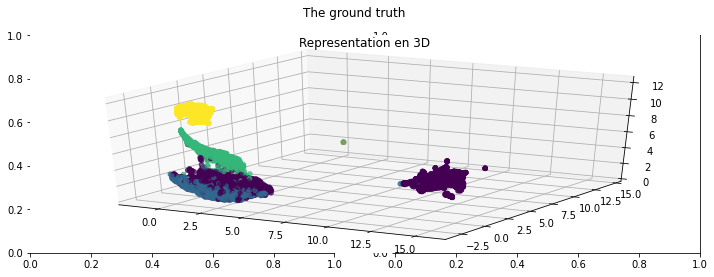

In [ ]:
# Plot 2D
eval_clustering_2D(X_reduced_u_map_2D , labels , label_num)

# Plot 3D
eval_clustering_3D(X_reduced_u_map_3D , labels, 'The predicted labels')
eval_clustering_3D(X_reduced_u_map_3D , label_num,  'The ground truth')

# Plot 3D avec plotly
# eval_clustering_3D_plotly(X_reduced_u_map_3D , labels)

### **Autoencodeurs**

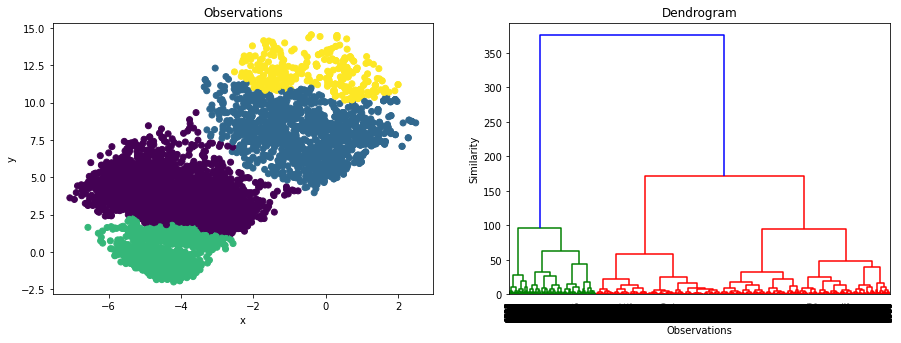

In [ ]:
model = AgglomerativeClustering(linkage=lkg, n_clusters=k)
model.fit(X_reduced_autoencodeur_2D)
labels = model.labels_

CAH_plot(X_reduced_autoencodeur_2D , labels)

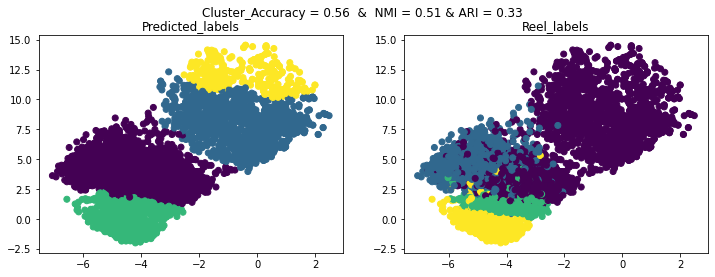

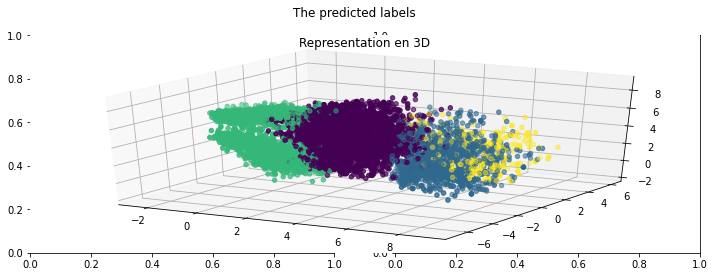

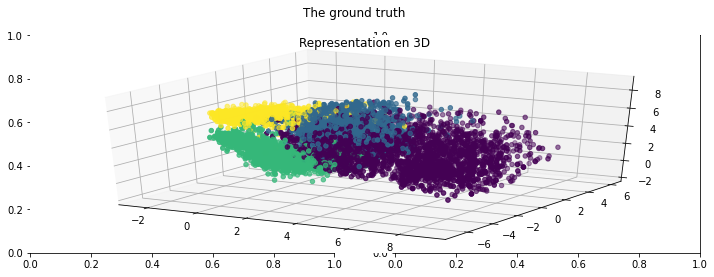

In [ ]:
# Plot 2D
eval_clustering_2D(X_reduced_autoencodeur_2D , labels , label_num)

# Plot 3D
eval_clustering_3D(X_reduced_autoencodeur_3D , labels, 'The predicted labels')
eval_clustering_3D(X_reduced_autoencodeur_3D , label_num,  'The ground truth')

# Plot 3D avec plotly
# eval_clustering_3D_plotly(X_reduced_autoencodeur_3D , labels)

# **Reduced k-means and factirial k-means**



## **Reduced k-means**

In [ ]:
rkm_2D = fcps.TandemClustering(avg_roberta,4,Type="Reduced",PlotIt=False, ndim=2, nstart=10)
rkm_3D = fcps.TandemClustering(avg_roberta,4,Type="Reduced",PlotIt=False, ndim=3, nstart=10)

R[write to console]: Registered S3 method overwritten by 'GGally':
  method from   
  +.gg   ggplot2



  |======================================================================| 100%

In [ ]:
# Reduced k-means
pred_label_rkm_2D = rkm_2D[0]
X_reduced_rkm_2D  = rkm_2D[1][0]

pred_label_rkm_3D = rkm_3D[0]
X_reduced_rkm_3D  = rkm_3D[1][0]

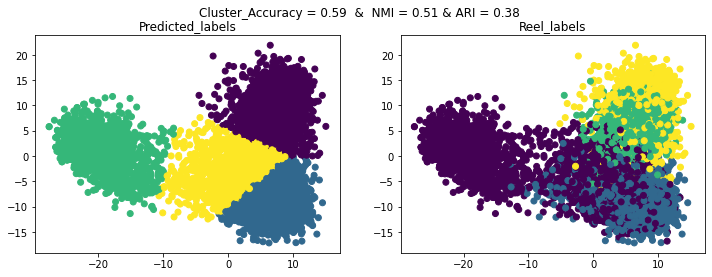

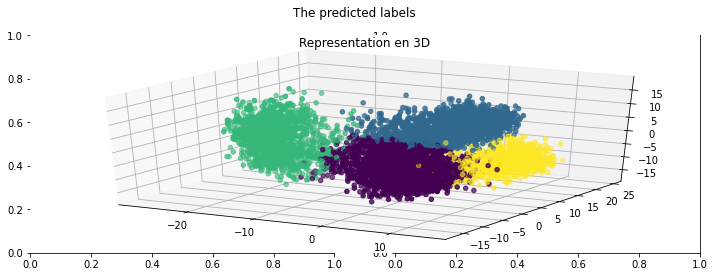

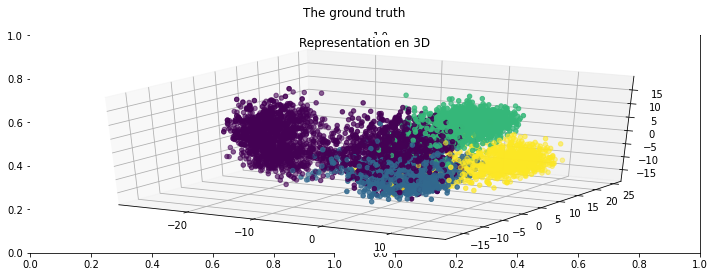

In [ ]:
# Plot 2D
eval_clustering_2D(X_reduced_rkm_2D , pred_label_rkm_2D , label_num)

# Plot 3D
eval_clustering_3D(X_reduced_rkm_3D , pred_label_rkm_3D, 'The predicted labels')
eval_clustering_3D(X_reduced_rkm_3D , label_num,  'The ground truth')

## **Factorial k-means**

In [ ]:
rkm_2D = fcps.TandemClustering(avg_roberta,4,Type="Factorial",PlotIt=False, ndim=2, nstart=10)
rkm_3D = fcps.TandemClustering(avg_roberta,4,Type="Factorial",PlotIt=False, ndim=3, nstart=10)

  |======================================================================| 100%

In [ ]:
# Factorial k-means
pred_label_rkm_2D = rkm_2D[0]
X_reduced_rkm_2D  = rkm_2D[1][0]

pred_label_rkm_3D = rkm_3D[0]
X_reduced_rkm_3D  = rkm_3D[1][0]

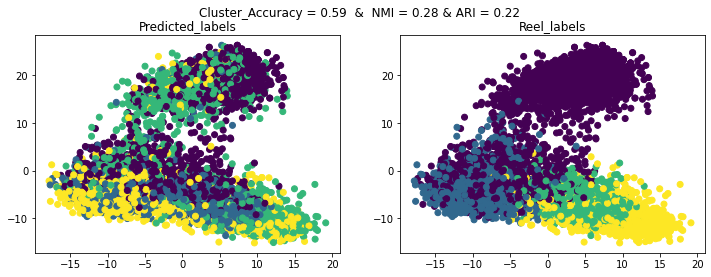

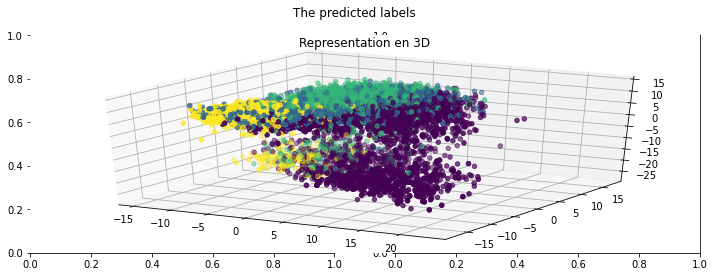

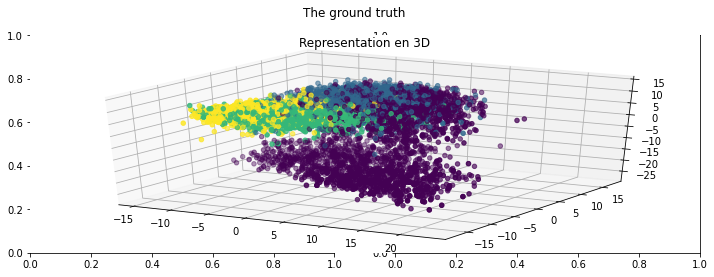

In [ ]:
# Plot 2D
eval_clustering_2D(X_reduced_rkm_2D , pred_label_rkm_2D , label_num)

# Plot 3D
eval_clustering_3D(X_reduced_rkm_3D , pred_label_rkm_3D, 'The predicted labels')
eval_clustering_3D(X_reduced_rkm_3D , label_num,  'The ground truth')

## **DCN**

In [ ]:
from DKM_DCN_tf_py import DKM , DCN

In [ ]:
import tensorflow.compat.v1 as tf
tf.reset_default_graph()

In [ ]:
Deep_Clustering_Network = DCN(data = avg_roberta , n_clusters = 4, n_components = 2, n_pretrain_epochs=50, n_finetuning_epochs=50, lambda_=1.0, batch_size=256, seed=None, cpu=False)

/content/DKM_DCN_tf_py.py:21: UserWarning:

`tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.

/usr/local/lib/python3.7/dist-packages/keras/legacy_tf_layers/core.py:255: UserWarning:

`layer.apply` is deprecated and will be removed in a future version. Please use `layer.__call__` method instead.



Starting autoencoder pretraining...


100%|██████████| 50/50 [00:15<00:00,  3.30it/s]


Running k-means on the learned embeddings...
Starting DCN training...


100%|██████████| 50/50 [00:48<00:00,  1.04it/s]


In [ ]:
import tensorflow.compat.v1 as tf
tf.reset_default_graph()

In [ ]:
#Deep_Clustering_Network_3D = DCN(data = avg_roberta , n_clusters = 4, n_components = 3, n_pretrain_epochs=50, n_finetuning_epochs=50, lambda_=1.0, batch_size=256, seed=None, cpu=False)

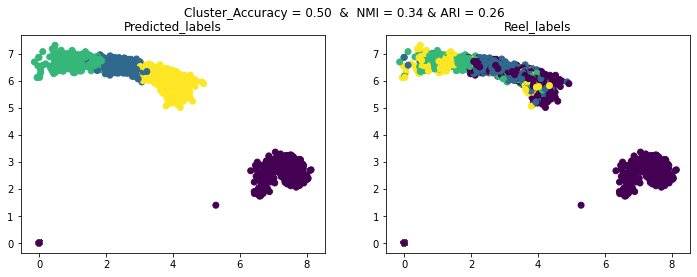

In [ ]:
# Deep Clustering Network
pred_label_DCN = Deep_Clustering_Network[1]
X_reduced_DCN  = Deep_Clustering_Network[0]

#pred_label_DCN_3D = Deep_Clustering_Network_3D[1]
 #X_reduced_DCN_3D  = Deep_Clustering_Network_3D[0]

# Plot 2D
eval_clustering_2D(X_reduced_DCN , pred_label_DCN , label_num)

# Plot 3D
#eval_clustering_3D(X_reduced_DCN_3D , pred_label_DCN_3D, 'The predicted labels')
#eval_clustering_3D(X_reduced_DCN_3D , label_num,  'The ground truth')

## **DKM**

In [ ]:
tf.reset_default_graph()

In [ ]:
Deep_kmeans_2D = DKM(data = avg_roberta, n_clusters = 4, n_components = 2, n_pretrain_epochs=50, n_finetuning_epochs=5, lambda_=1.0, batch_size=256, seed=None, cpu=False)

/content/DKM_DCN_tf_py.py:21: UserWarning:

`tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.

/usr/local/lib/python3.7/dist-packages/keras/legacy_tf_layers/core.py:255: UserWarning:

`layer.apply` is deprecated and will be removed in a future version. Please use `layer.__call__` method instead.



Starting autoencoder pretraining...


100%|██████████| 50/50 [00:15<00:00,  3.27it/s]


Running k-means on the learned embeddings...
Starting DKM training...


100%|██████████| 20/20 [00:39<00:00,  1.99s/it]


In [ ]:
tf.reset_default_graph()

In [ ]:
Deep_kmeans_3D = DKM(data = avg_roberta, n_clusters = 4, n_components = 3, n_pretrain_epochs=50, n_finetuning_epochs=5, lambda_=1.0, batch_size=256, seed=None, cpu=False)

/content/DKM_DCN_tf_py.py:21: UserWarning:

`tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.

/usr/local/lib/python3.7/dist-packages/keras/legacy_tf_layers/core.py:255: UserWarning:

`layer.apply` is deprecated and will be removed in a future version. Please use `layer.__call__` method instead.



Starting autoencoder pretraining...


100%|██████████| 50/50 [00:15<00:00,  3.28it/s]


Running k-means on the learned embeddings...
Starting DKM training...


100%|██████████| 20/20 [00:38<00:00,  1.93s/it]


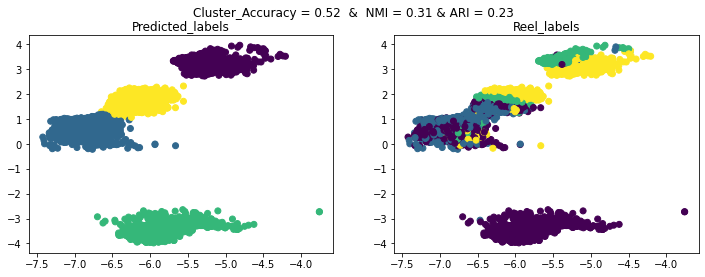

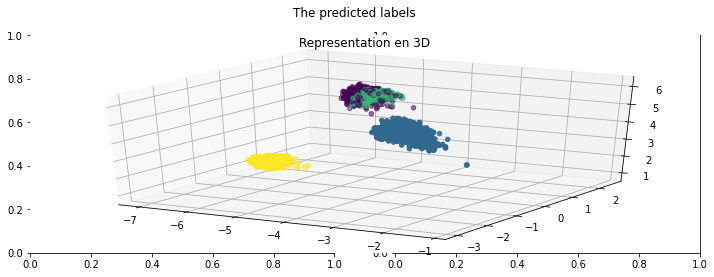

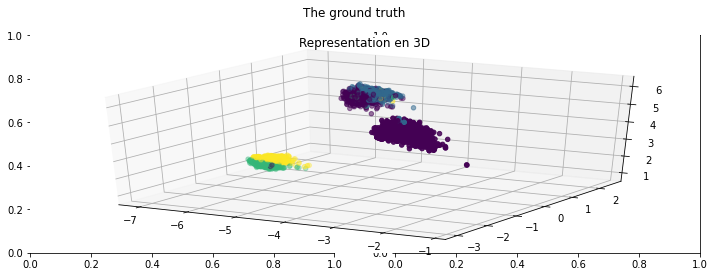

In [ ]:
# Deep k-means (DKM)
pred_label_DKM_2D = Deep_kmeans_2D[1]
X_reduced_DKM_2D  = Deep_kmeans_2D[0]

pred_label_DKM_3D = Deep_kmeans_3D[1]
X_reduced_DKM_3D  = Deep_kmeans_3D[0]

# Plot 2D
eval_clustering_2D(X_reduced_DKM_2D , pred_label_DKM_2D , label_num)

# Plot 3D
eval_clustering_3D(X_reduced_DKM_3D , pred_label_DKM_3D, 'The predicted labels')
eval_clustering_3D(X_reduced_DKM_3D , label_num,  'The ground truth')